In [1]:
# This module trains a GRU model for the prediction of wind speed
# and prints the error metrics

import pandas as pd
import numpy as np

from prophet import Prophet

from sklearn.preprocessing import MinMaxScaler
from sklearn import metrics

from PyEMD import CEEMDAN

import matplotlib.pyplot as plt
%matplotlib notebook

from tensorflow import keras
from tensorflow.keras.utils import plot_model

from prophet.plot import plot_plotly, plot_components_plotly, add_changepoints_to_plot

In [2]:
#function for printing the metrics of the predictions
def print_metrics(pred, y_vals):
    print('mape: ', metrics.mean_absolute_percentage_error(y_vals, pred))
    print('mae: ', metrics.mean_absolute_error(y_vals, pred))
    print('mse: ', metrics.mean_squared_error(y_vals, pred))
    print('rmse: ', np.sqrt(metrics.mean_squared_error(y_vals, pred)))
    print('score: ', metrics.r2_score(y_vals, pred))
    count = 0
    y_error = pred.flatten() - y_vals.flatten()
    y_error = np.array([abs(e) for e in y_error]).flatten()

    # accuracy calculation(number of predictions having less than 20% error)
    for i in range(len(y_error)):
        if(y_error[i] < 0.20 * y_test[i]):
            count += 1
    print('accuracy: ', count / len(pred))

In [3]:
data = pd.read_csv('data.csv')

In [4]:
data.describe().round()

,lrad,prec,pres,shum,srad,temp,wind
count,5840.0,5840.0,5840.0,5840.0,5840.0,5840.0,5840.0
mean,269.0,0.0,85521.0,0.0,193.0,281.0,4.0
std,65.0,0.0,611.0,0.0,268.0,14.0,2.0
min,132.0,0.0,83722.0,0.0,0.0,246.0,0.0
25%,216.0,0.0,85050.0,0.0,0.0,270.0,2.0
50%,266.0,0.0,85520.0,0.0,3.0,283.0,4.0
75%,321.0,0.0,85974.0,0.0,352.0,293.0,5.0
max,450.0,3.0,86820.0,0.0,990.0,311.0,16.0


In [5]:
y = data[["wind"]][1:]

In [6]:
IImfs=[]
def ceemdan_decompose_res(data):
    ceemdan = CEEMDAN()
    ceemdan.ceemdan(data)
    imfs, res = ceemdan.get_imfs_and_residue()
    plt.figure(figsize=(12,9))
    plt.subplots_adjust(hspace=0.1)
    plt.subplot(imfs.shape[0]+3, 1, 1)
    plt.plot(data,'r')
    for i in range(imfs.shape[0]):
        plt.subplot(imfs.shape[0]+3,1,i+2)
        plt.plot(imfs[i], 'g')
        plt.ylabel("IMF %i" %(i+1))
        plt.locator_params(axis='x', nbins=10)
        # 在函数前必须设置一个全局变量 IImfs=[]
        IImfs.append(imfs[i])
    plt.subplot(imfs.shape[0]+3, 1, imfs.shape[0]+3)
    plt.plot(res,'g')
    return res

<IPython.core.display.Javascript object>


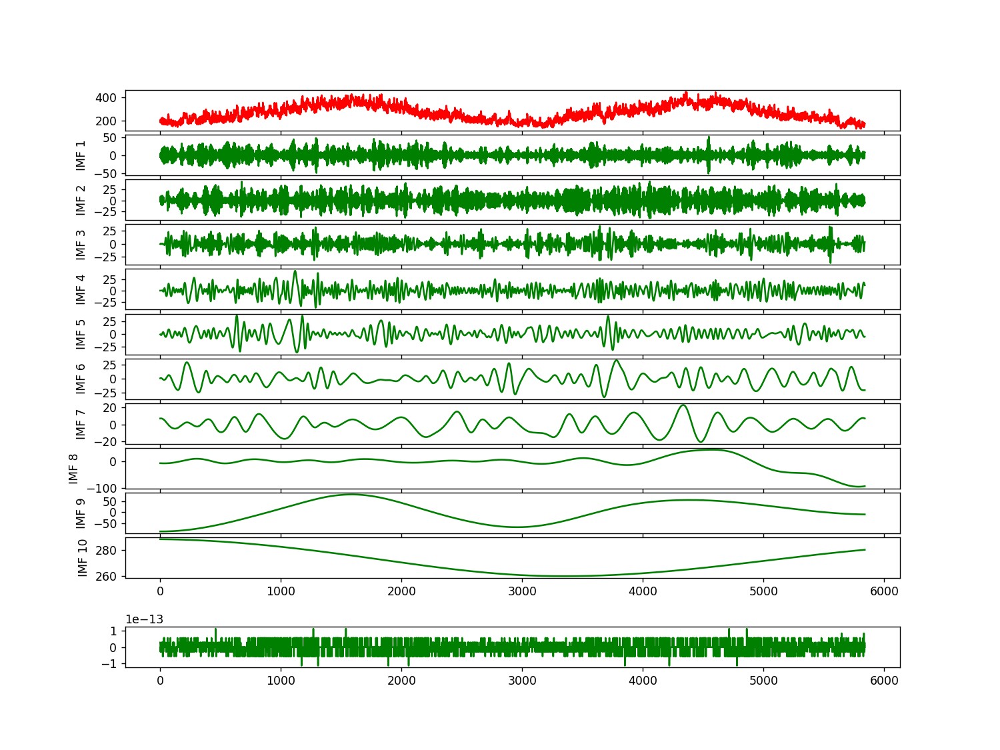

<IPython.core.display.Javascript object>


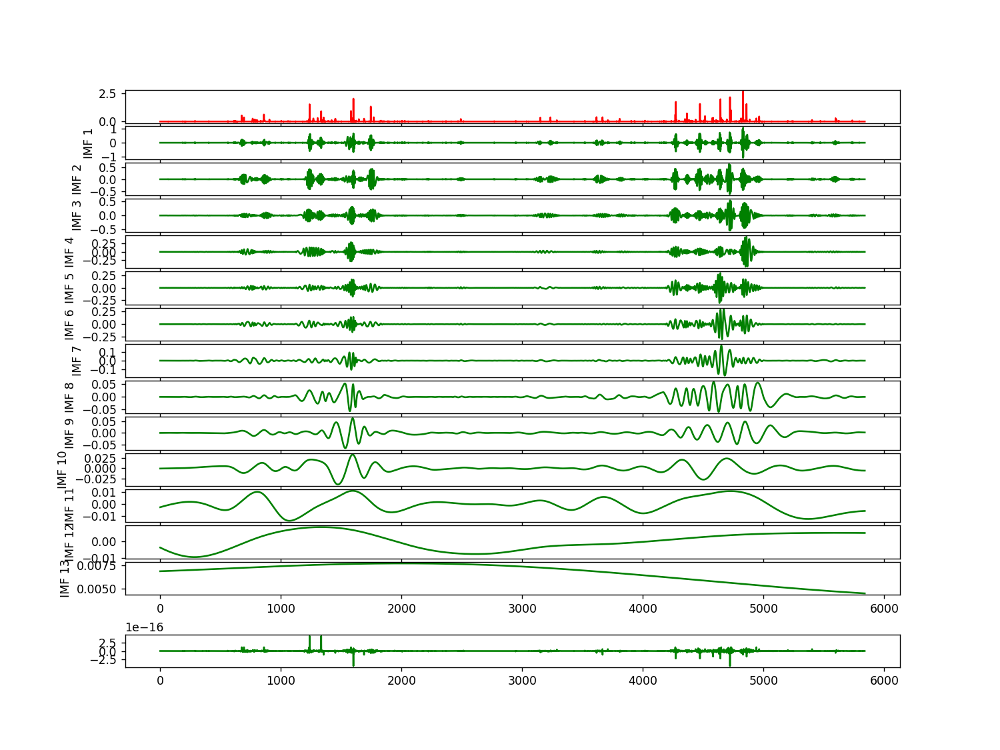

<IPython.core.display.Javascript object>


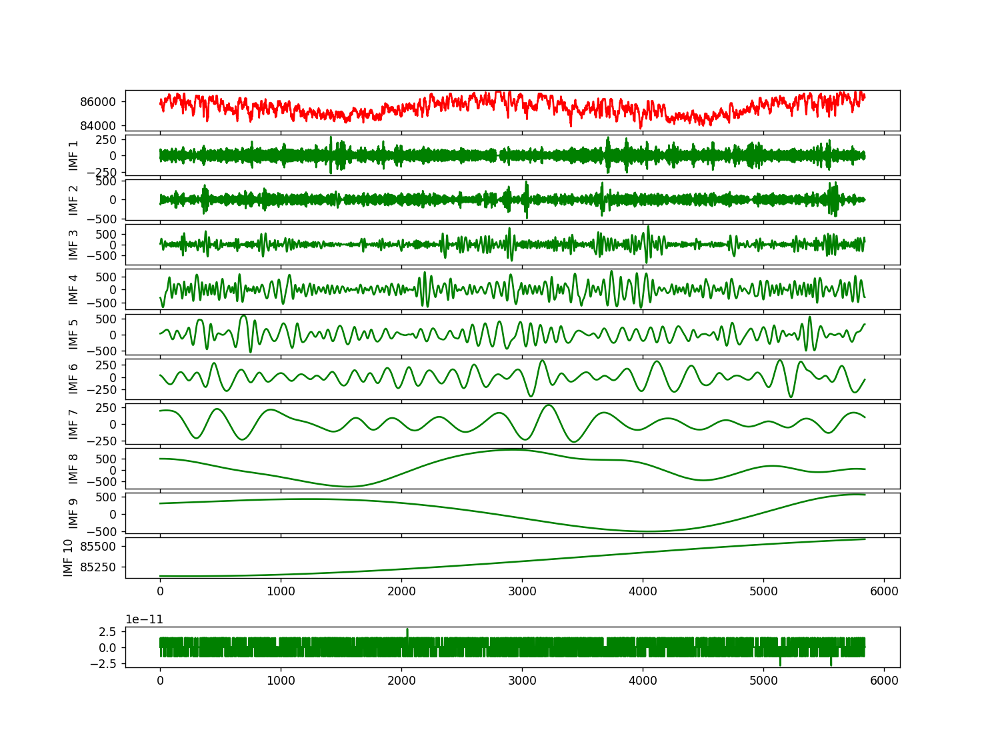

<IPython.core.display.Javascript object>


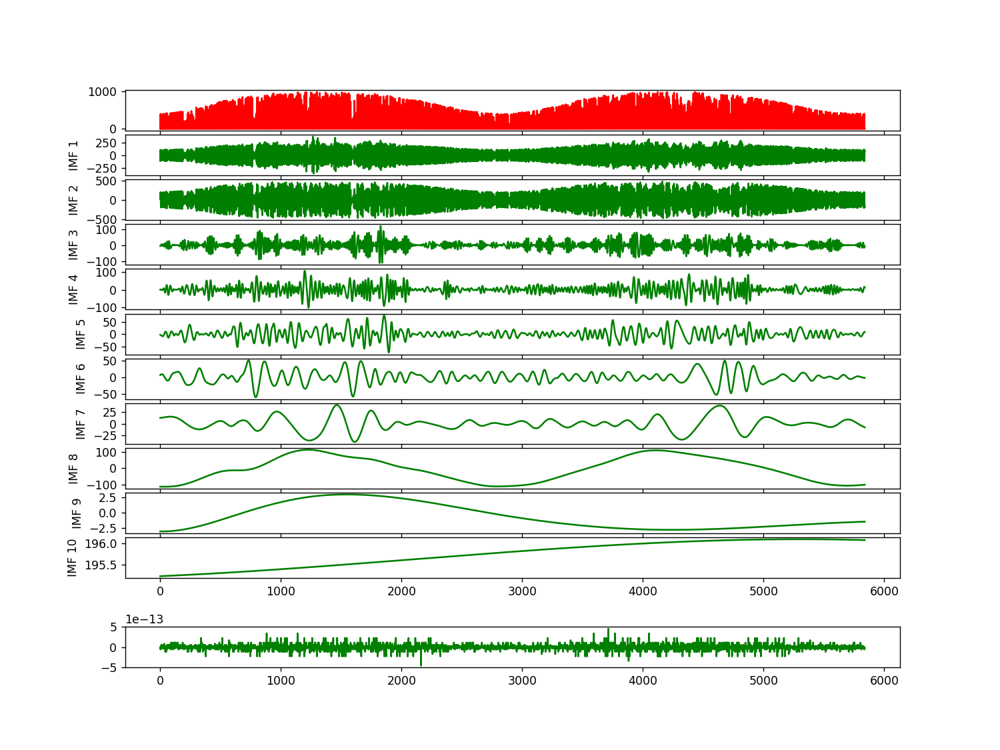

<IPython.core.display.Javascript object>


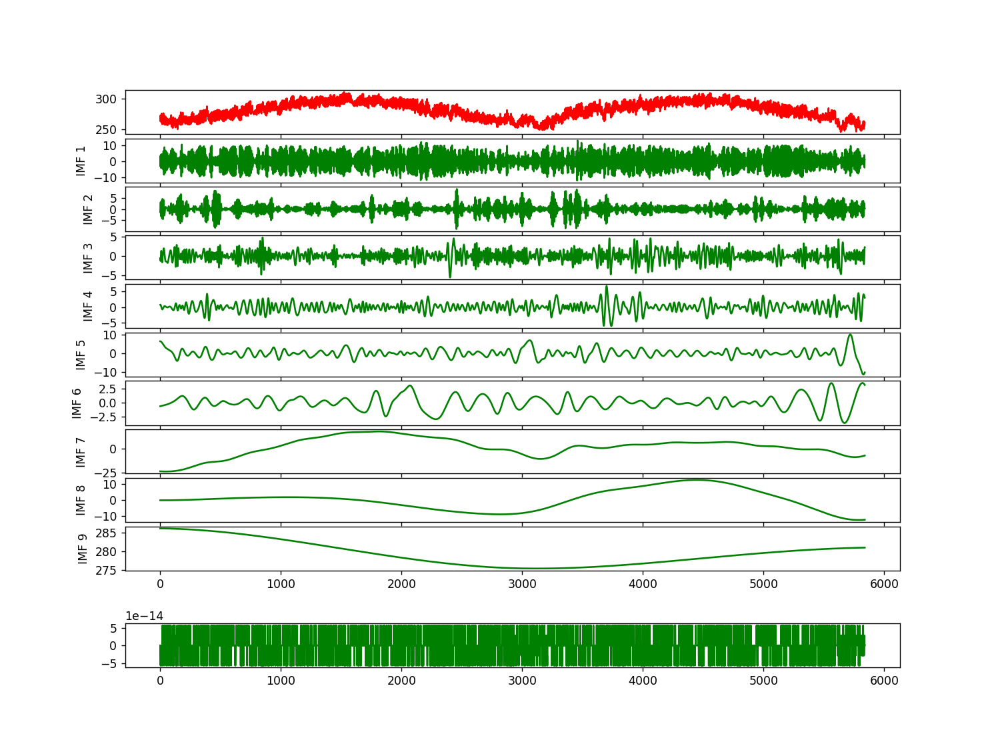

<IPython.core.display.Javascript object>


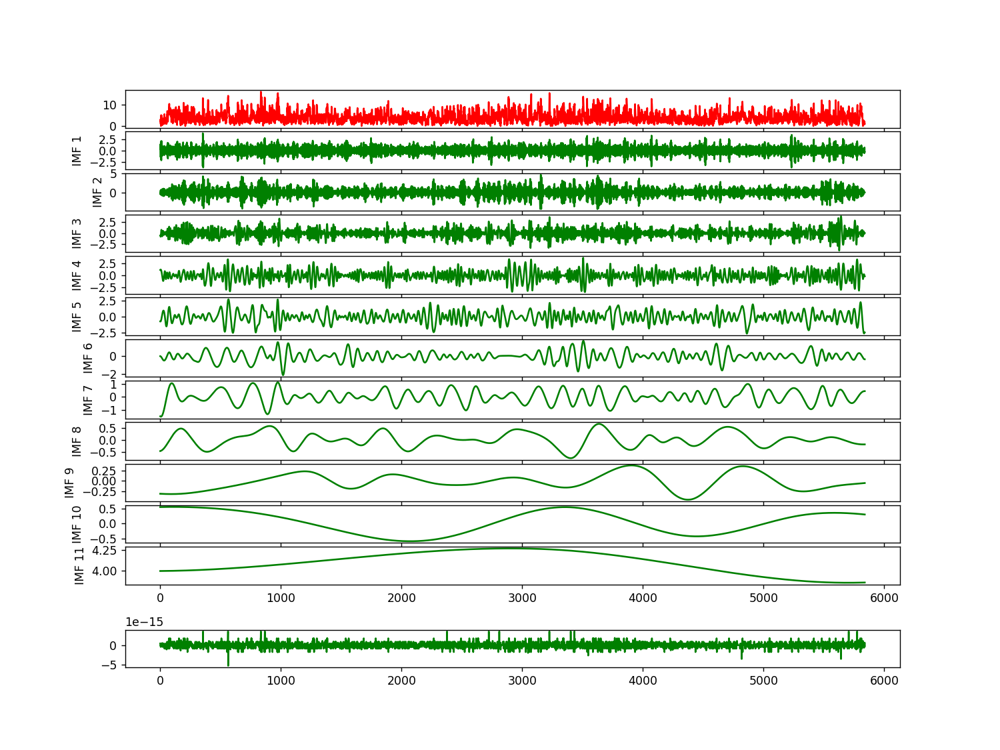

In [7]:
for item in ["lrad", "prec", "pres", "srad", "temp", "wind"]:
    res=ceemdan_decompose_res(data[item].to_numpy().ravel())
    IImfs.append(res)
for item in ["lrad", "prec", "pres", "srad", "temp", "wind"]:
    IImfs.append(data[item].to_numpy().ravel())

<IPython.core.display.Javascript object>


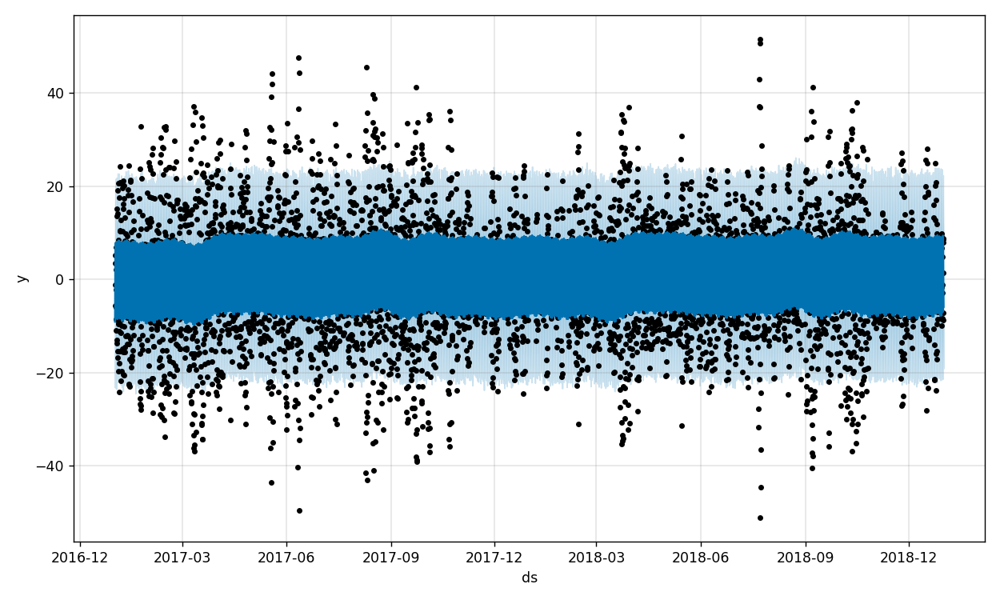

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.233820   -4.708519   22.343947     0.233820     0.233820   
5836  0.233900  -10.573718   16.029453     0.233900     0.233900   
5837  0.233980  -14.616767   12.379362     0.233980     0.233980   
5838  0.234059  -17.525913   10.657260     0.234059     0.234059   
5839  0.234139  -19.070240    8.780812     0.234139     0.234139   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        9.162132              9.162132              9.162132  9.017448   
5836        1.799073              1.799073              1.799073  1.690449   
5837       -1.080115             -1.080115             -1.080115 -1.155873   
5838       -3.439851             -3.439851             -3.439851 -3.492441   
5839       -6.119890             -6.119890             -6.119890 -6.163982   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     9.017448     9.017448 -0.005856 

<IPython.core.display.Javascript object>


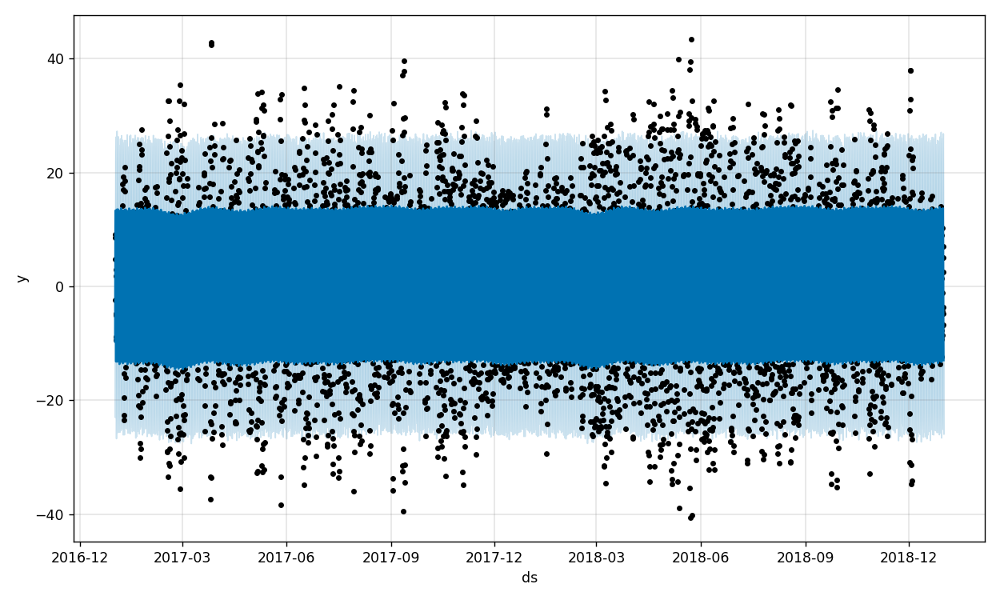

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.048497    1.586800   26.857999     0.048497     0.048497   
5836  0.048493   -3.670886   20.983688     0.048493     0.048493   
5837  0.048490  -12.672851   11.868268     0.048490     0.048490   
5838  0.048487  -21.208809    3.507742     0.048487     0.048487   
5839  0.048483  -25.902803   -0.219120     0.048483     0.048483   

      additive_terms  additive_terms_lower  additive_terms_upper      daily  \
5835       13.665140             13.665140             13.665140  13.424078   
5836        8.549536              8.549536              8.549536   8.317734   
5837       -0.631843             -0.631843             -0.631843  -0.856399   
5838       -9.282935             -9.282935             -9.282935  -9.505285   
5839      -13.029365            -13.029365            -13.029365 -13.256550   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835    13.424078    13.424078  0.160762    

<IPython.core.display.Javascript object>


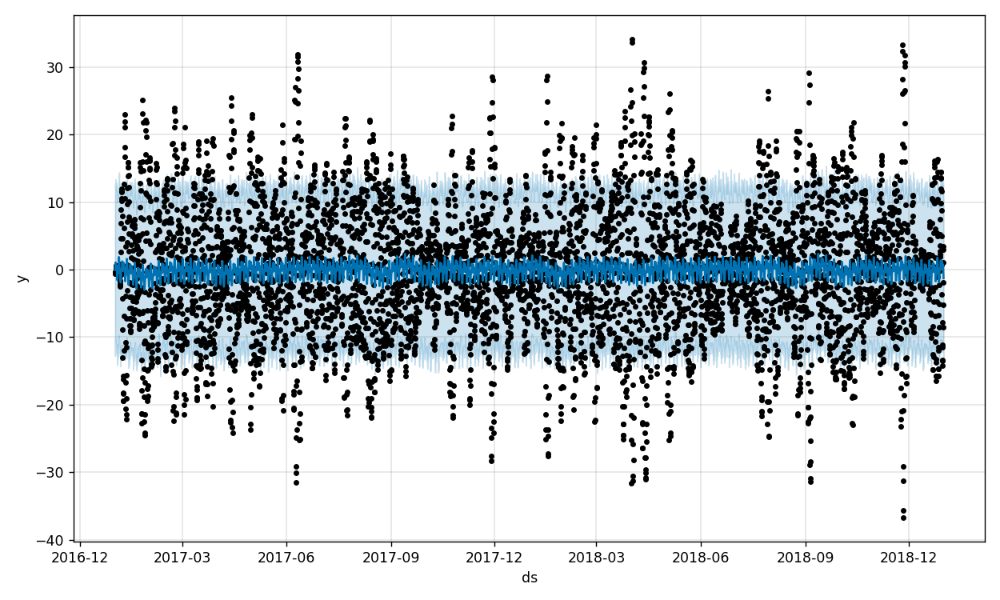

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.097736  -12.126387   13.577584    -0.097736    -0.097736   
5836 -0.097729  -12.282181   12.439888    -0.097729    -0.097729   
5837 -0.097723  -12.155370   12.479313    -0.097723    -0.097723   
5838 -0.097716  -13.044385   11.577132    -0.097716    -0.097716   
5839 -0.097710  -13.574407   10.143877    -0.097710    -0.097710   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.877116              0.877116              0.877116  0.547068   
5836        0.527246              0.527246              0.527246  0.453751   
5837       -0.092130             -0.092130             -0.092130  0.099993   
5838       -0.742943             -0.742943             -0.742943 -0.300839   
5839       -1.177064             -1.177064             -1.177064 -0.526082   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.547068     0.547068  0.329284 

<IPython.core.display.Javascript object>


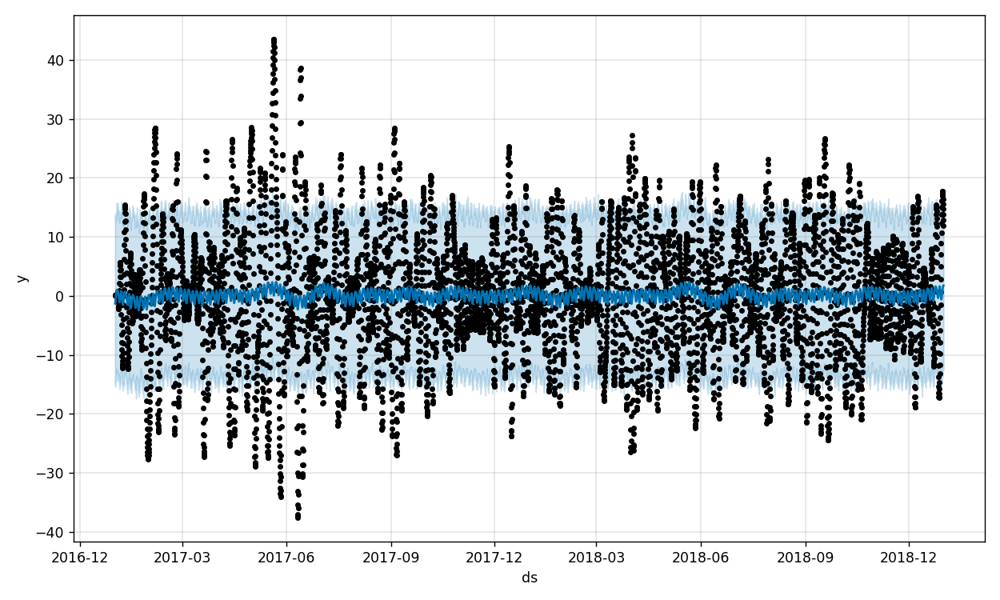

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.108037  -11.980355   16.198342     0.108037     0.108037   
5836  0.108022  -12.027510   15.504119     0.108022     0.108022   
5837  0.108007  -12.642014   14.933916     0.108007     0.108007   
5838  0.107992  -10.722984   15.558749     0.107992     0.107992   
5839  0.107977  -12.248170   15.467393     0.107977     0.107977   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        1.553904              1.553904              1.553904  0.013676   
5836        1.633054              1.633054              1.633054  0.015419   
5837        1.670604              1.670604              1.670604  0.008121   
5838        1.678513              1.678513              1.678513 -0.001712   
5839        1.667532              1.667532              1.667532 -0.008759   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.013676     0.013676  0.646805 

<IPython.core.display.Javascript object>


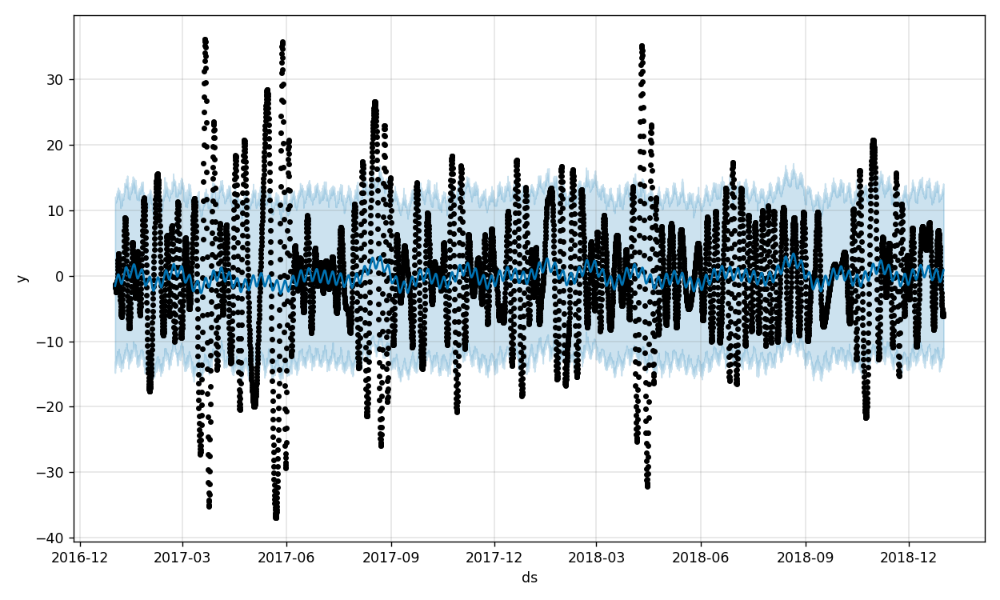

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.287693  -11.036226   12.663935     0.287693     0.287693   
5836  0.287810  -11.798241   13.573143     0.287810     0.287810   
5837  0.287928  -12.578095   14.069698     0.287928     0.287928   
5838  0.288046  -12.173674   12.529603     0.288046     0.288046   
5839  0.288163  -11.465896   13.323315     0.288163     0.288163   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.240930              0.240930              0.240930  0.001590   
5836        0.329143              0.329143              0.329143  0.000213   
5837        0.416376              0.416376              0.416376 -0.001265   
5838        0.500702              0.500702              0.500702 -0.003402   
5839        0.581911              0.581911              0.581911 -0.004797   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.001590     0.001590 -0.152634 

<IPython.core.display.Javascript object>


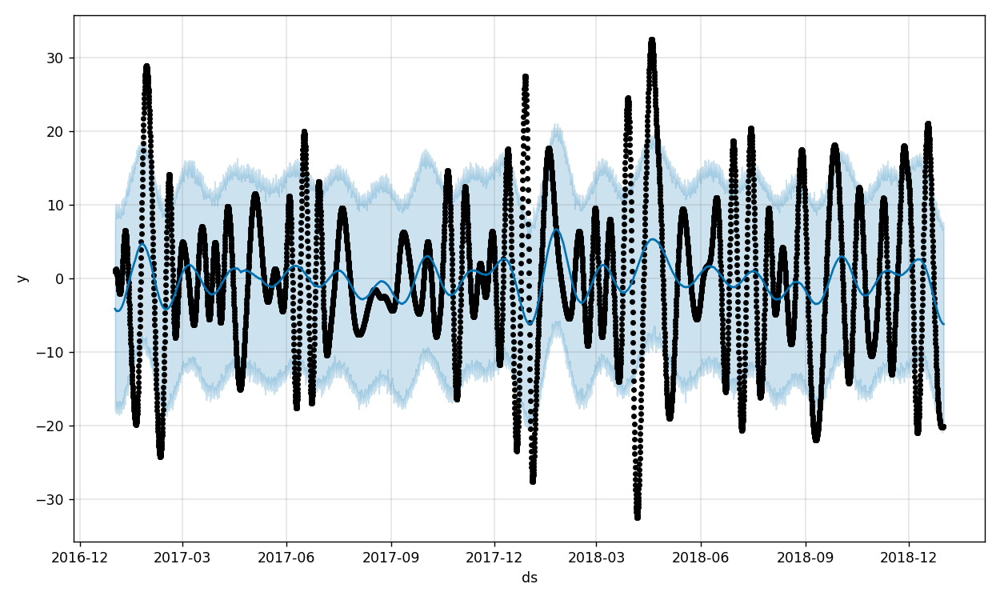

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.038469  -19.500671    6.843183     0.038469     0.038469   
5836  0.038451  -19.534915    7.647405     0.038451     0.038451   
5837  0.038433  -20.132282    6.609376     0.038433     0.038433   
5838  0.038415  -20.146893    7.013941     0.038415     0.038415   
5839  0.038396  -20.654918    5.812664     0.038396     0.038396   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -6.253932             -6.253932             -6.253932  0.001609   
5836       -6.268276             -6.268276             -6.268276 -0.001532   
5837       -6.279032             -6.279032             -6.279032 -0.004814   
5838       -6.286312             -6.286312             -6.286312 -0.008005   
5839       -6.290840             -6.290840             -6.290840 -0.011284   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.001609     0.001609 -6.231198 

<IPython.core.display.Javascript object>


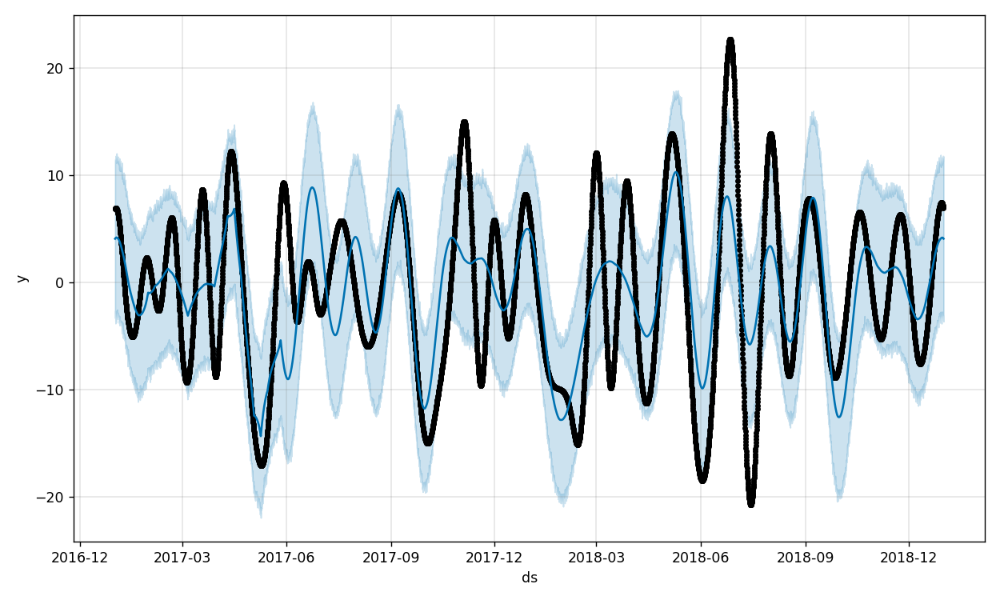

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -1.578662   -3.001605   11.557646    -1.578662    -1.578662   
5836 -1.578953   -3.077698   11.823246    -1.578953    -1.578953   
5837 -1.579244   -3.078429   11.354787    -1.579244    -1.579244   
5838 -1.579535   -3.450139   11.744725    -1.579535    -1.579535   
5839 -1.579826   -3.619303   11.593211    -1.579826    -1.579826   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        5.746053              5.746053              5.746053  0.000625   
5836        5.732226              5.732226              5.732226  0.000421   
5837        5.716418              5.716418              5.716418  0.000278   
5838        5.698334              5.698334              5.698334 -0.000264   
5839        5.678924              5.678924              5.678924 -0.000421   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000625     0.000625  5.721767 

<IPython.core.display.Javascript object>


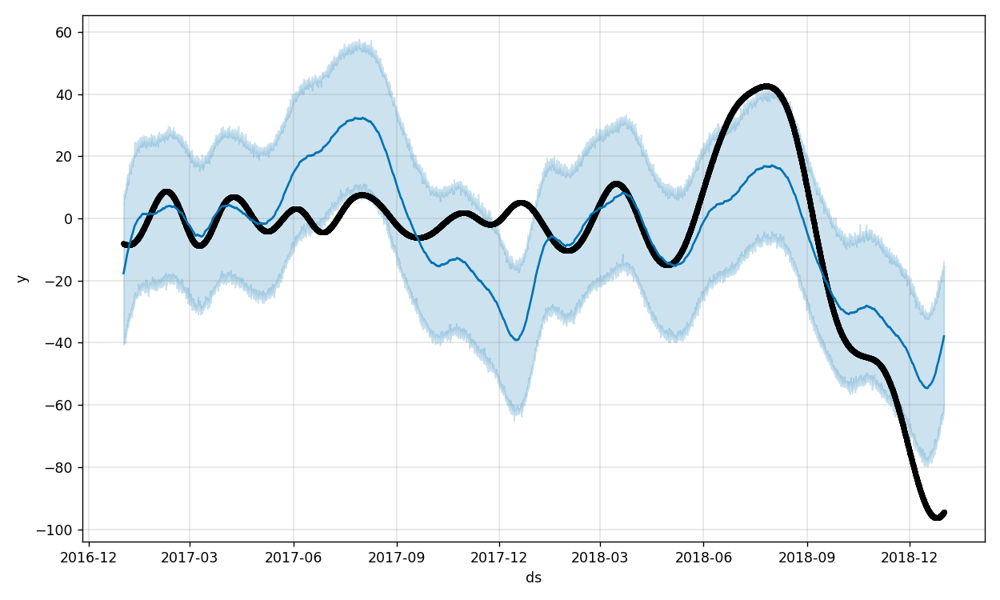

          trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -18.397197  -63.068643  -15.713128   -18.397197   -18.397197   
5836 -18.402459  -61.799204  -13.606942   -18.402459   -18.402459   
5837 -18.407721  -60.359087  -15.259287   -18.407721   -18.407721   
5838 -18.412984  -62.320572  -15.959146   -18.412984   -18.412984   
5839 -18.418246  -60.057834  -14.883956   -18.418246   -18.418246   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -20.500028            -20.500028            -20.500028  0.005107   
5836      -20.261069            -20.261069            -20.261069 -0.005122   
5837      -20.013820            -20.013820            -20.013820 -0.017547   
5838      -19.755776            -19.755776            -19.755776 -0.027771   
5839      -19.494042            -19.494042            -19.494042 -0.040216   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835     0.005107     0.005107 -20.316290  

<IPython.core.display.Javascript object>


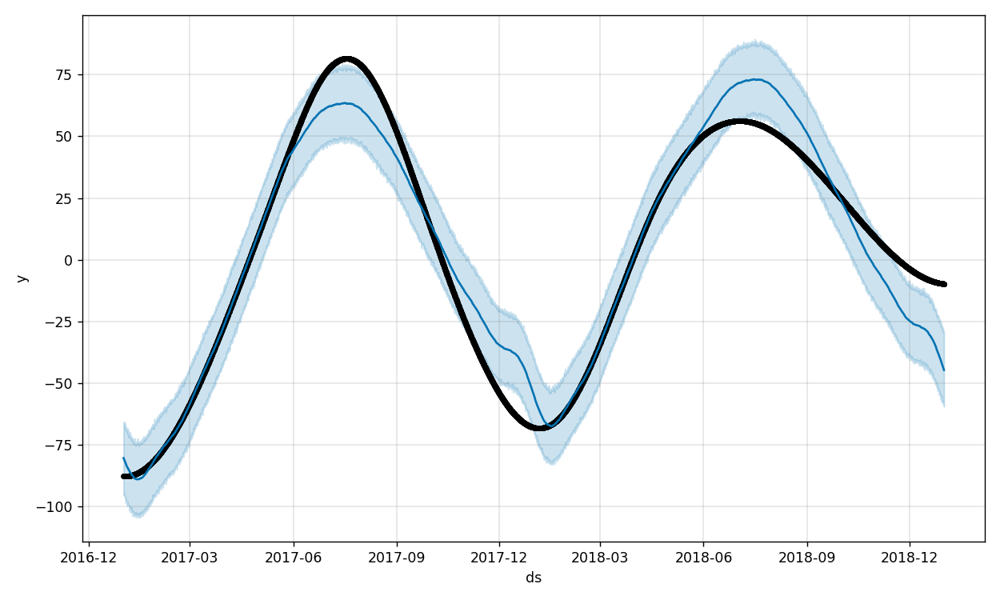

          trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  16.333919  -58.209982  -29.060674    16.333919    16.333919   
5836  16.337219  -58.644239  -29.604750    16.337219    16.337219   
5837  16.340519  -59.399566  -29.673428    16.340519    16.340519   
5838  16.343819  -59.062767  -29.730406    16.343819    16.343819   
5839  16.347120  -59.482016  -29.119160    16.347120    16.347120   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -60.265847            -60.265847            -60.265847 -0.004214   
5836      -60.449828            -60.449828            -60.449828  0.004163   
5837      -60.642533            -60.642533            -60.642533  0.010322   
5838      -60.838383            -60.838383            -60.838383  0.018728   
5839      -61.040241            -61.040241            -61.040241  0.024888   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835    -0.004214    -0.004214 -60.376605  

<IPython.core.display.Javascript object>


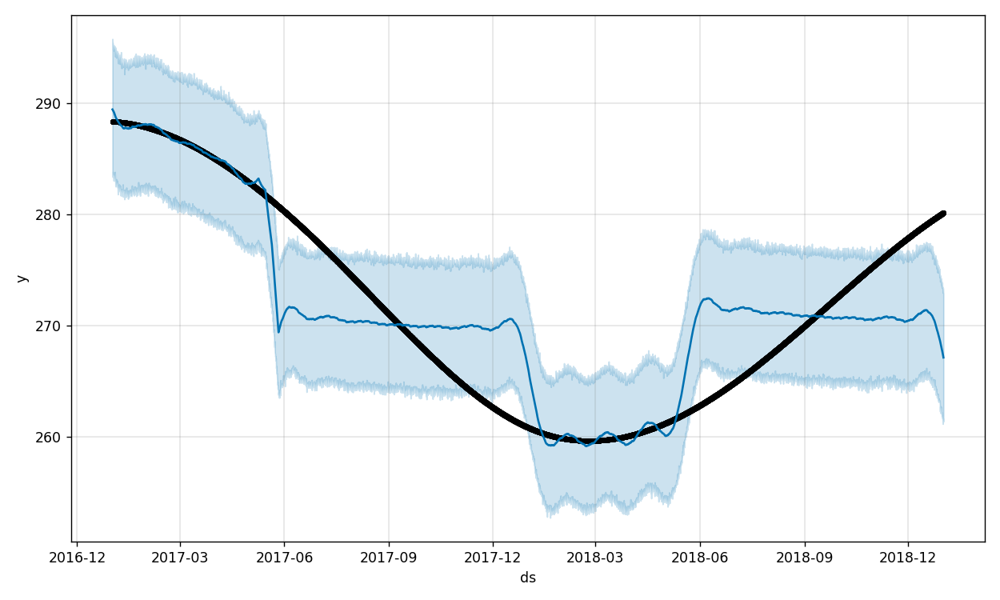

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  267.331674  261.176048  272.948176   267.331674   267.331674   
5836  267.331939  261.699962  273.392406   267.331939   267.331939   
5837  267.332204  261.515052  273.214028   267.332204   267.332204   
5838  267.332469  261.479774  272.940585   267.332469   267.332469   
5839  267.332734  261.397379  272.928910   267.332734   267.332734   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.094953              0.094953              0.094953 -0.001522   
5836        0.025690              0.025690              0.025690  0.001059   
5837       -0.046271             -0.046271             -0.046271  0.003550   
5838       -0.120147             -0.120147             -0.120147  0.006265   
5839       -0.195693             -0.195693             -0.195693  0.008799   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835    -0.001522    -0.001522  0.0557

<IPython.core.display.Javascript object>


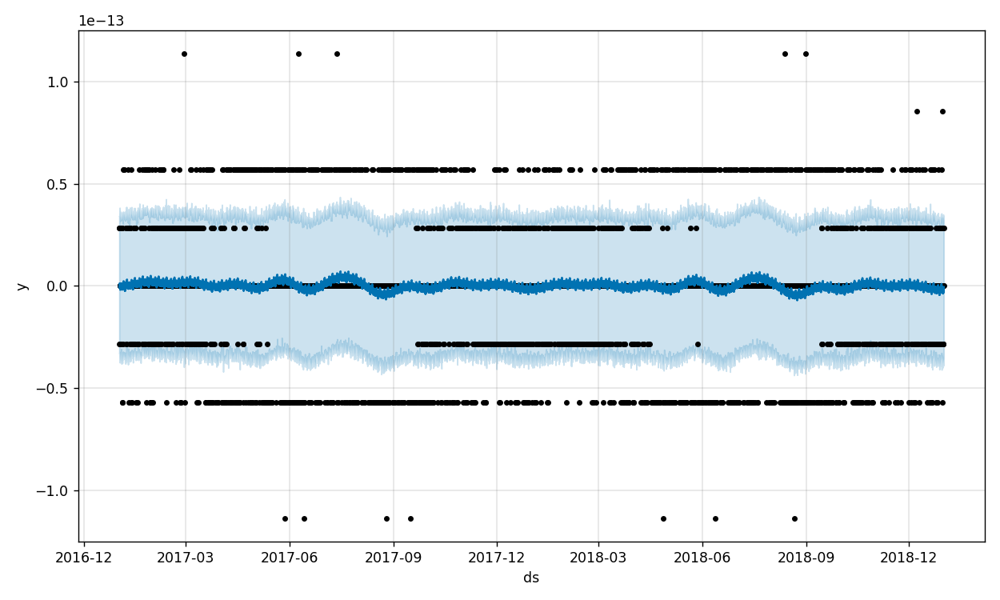

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835 -6.322055e-16 -3.591397e-14  3.490666e-14 -6.322055e-16 -6.322055e-16   
5836 -6.323197e-16 -3.670290e-14  3.303927e-14 -6.323197e-16 -6.323197e-16   
5837 -6.324338e-16 -3.886555e-14  3.398413e-14 -6.324338e-16 -6.324338e-16   
5838 -6.325480e-16 -3.597003e-14  3.259872e-14 -6.325480e-16 -6.325480e-16   
5839 -6.326622e-16 -3.570041e-14  3.242203e-14 -6.326622e-16 -6.326622e-16   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835   -6.476222e-16         -6.476222e-16         -6.476222e-16   
5836   -1.657065e-15         -1.657065e-15         -1.657065e-15   
5837   -2.399342e-15         -2.399342e-15         -2.399342e-15   
5838   -2.616907e-15         -2.616907e-15         -2.616907e-15   
5839    9.848042e-17          9.848042e-17          9.848042e-17   

             daily   daily_lower   daily_upper        yearly  yearly_lower  \
5835  1.307000e-15  1.307000e-15  1.307000e-

<IPython.core.display.Javascript object>


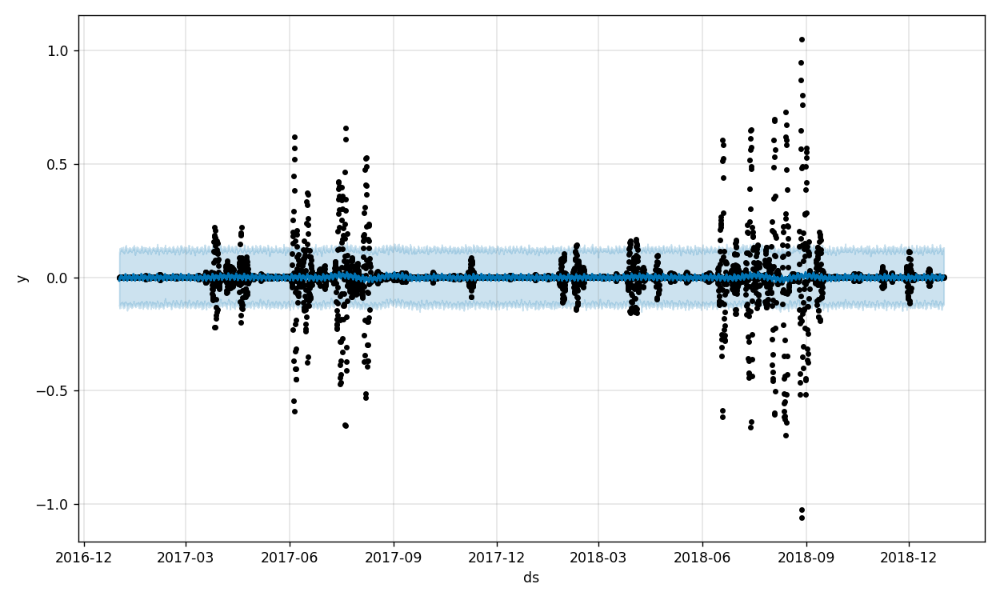

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.000550   -0.111419    0.131658     0.000550     0.000550   
5836  0.000549   -0.116851    0.129250     0.000549     0.000549   
5837  0.000549   -0.121569    0.128683     0.000549     0.000549   
5838  0.000549   -0.121576    0.116042     0.000549     0.000549   
5839  0.000549   -0.119216    0.130645     0.000549     0.000549   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.005422              0.005422              0.005422  0.002753   
5836        0.006852              0.006852              0.006852  0.003792   
5837        0.005749              0.005749              0.005749  0.002600   
5838        0.003831              0.003831              0.003831  0.000839   
5839        0.002737              0.002737              0.002737  0.000078   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.002753     0.002753 -0.000934 

<IPython.core.display.Javascript object>


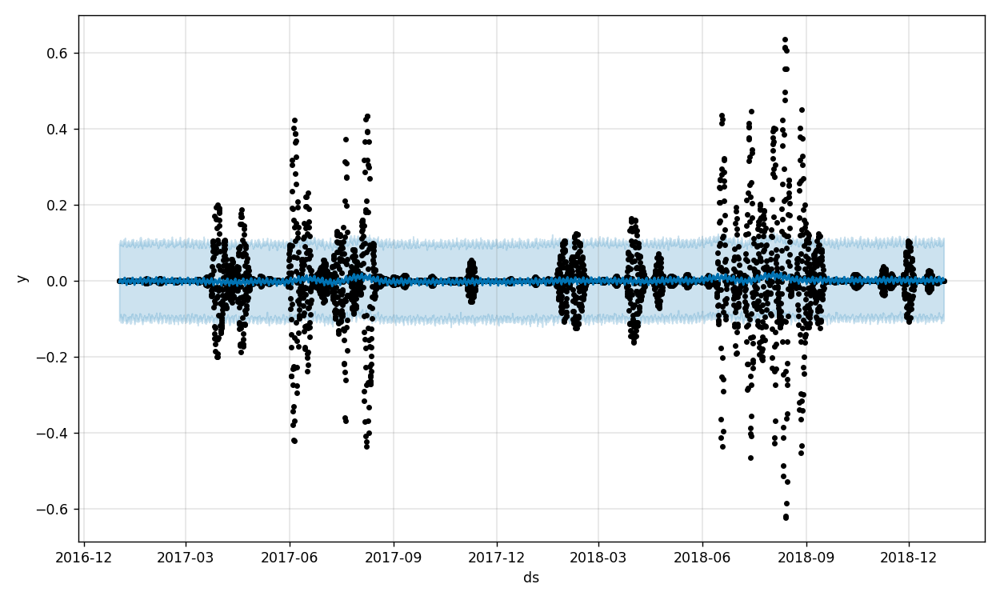

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.004341   -0.086811    0.111865     0.004341     0.004341   
5836  0.004342   -0.105040    0.101696     0.004342     0.004342   
5837  0.004344   -0.101149    0.109176     0.004344     0.004344   
5838  0.004345   -0.091505    0.113307     0.004345     0.004345   
5839  0.004346   -0.099731    0.107190     0.004346     0.004346   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.000659             -0.000659             -0.000659 -0.001447   
5836       -0.002898             -0.002898             -0.002898 -0.003151   
5837       -0.001339             -0.001339             -0.001339 -0.000970   
5838        0.000629              0.000629              0.000629  0.001671   
5839       -0.001079             -0.001079             -0.001079  0.000651   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.001447    -0.001447 -0.001860 

<IPython.core.display.Javascript object>


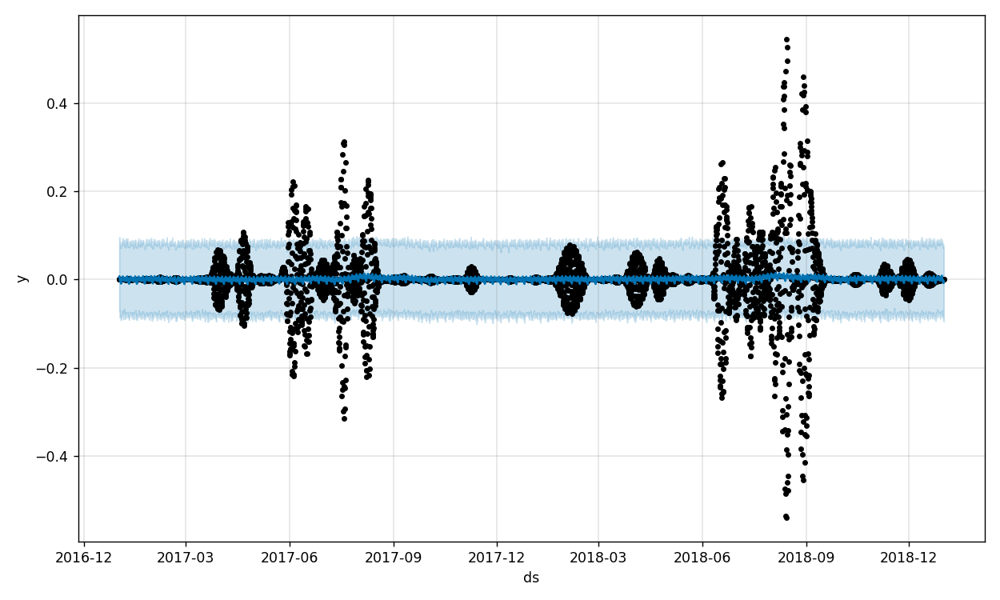

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.002141   -0.081250    0.077111     0.002141     0.002141   
5836  0.002142   -0.086789    0.077582     0.002142     0.002142   
5837  0.002142   -0.094360    0.071345     0.002142     0.002142   
5838  0.002143   -0.087549    0.074161     0.002143     0.002143   
5839  0.002143   -0.094506    0.070965     0.002143     0.002143   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.006974             -0.006974             -0.006974  0.000968   
5836       -0.009313             -0.009313             -0.009313 -0.001450   
5837       -0.010411             -0.010411             -0.010411 -0.003049   
5838       -0.009715             -0.009715             -0.009715 -0.003230   
5839       -0.006739             -0.006739             -0.006739 -0.001433   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000968     0.000968 -0.000657 

C:\Users\j8843\anaconda3\lib\site-packages\prophet\plot.py:66: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(facecolor='w', figsize=figsize)


<IPython.core.display.Javascript object>


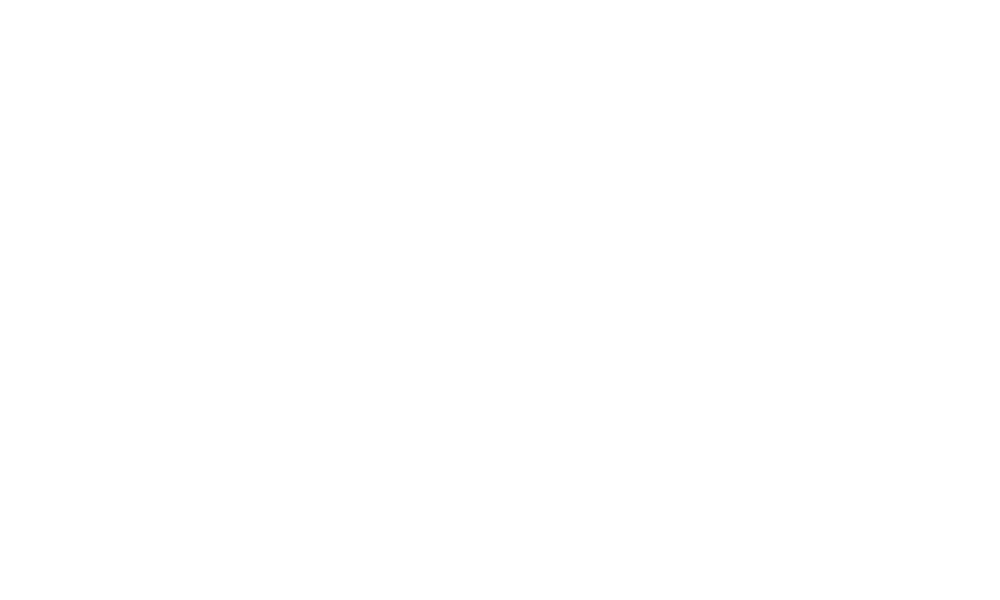

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.000415   -0.055386    0.062925     0.000415     0.000415   
5836  0.000415   -0.061735    0.061314     0.000415     0.000415   
5837  0.000415   -0.057266    0.062622     0.000415     0.000415   
5838  0.000415   -0.062075    0.057429     0.000415     0.000415   
5839  0.000415   -0.057301    0.061804     0.000415     0.000415   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.000929              0.000929              0.000929 -0.000061   
5836        0.000534              0.000534              0.000534  0.000133   
5837        0.000242              0.000242              0.000242  0.000303   
5838       -0.000203             -0.000203             -0.000203  0.000199   
5839       -0.000632             -0.000632             -0.000632  0.000016   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000061    -0.000061  0.000034 

<IPython.core.display.Javascript object>


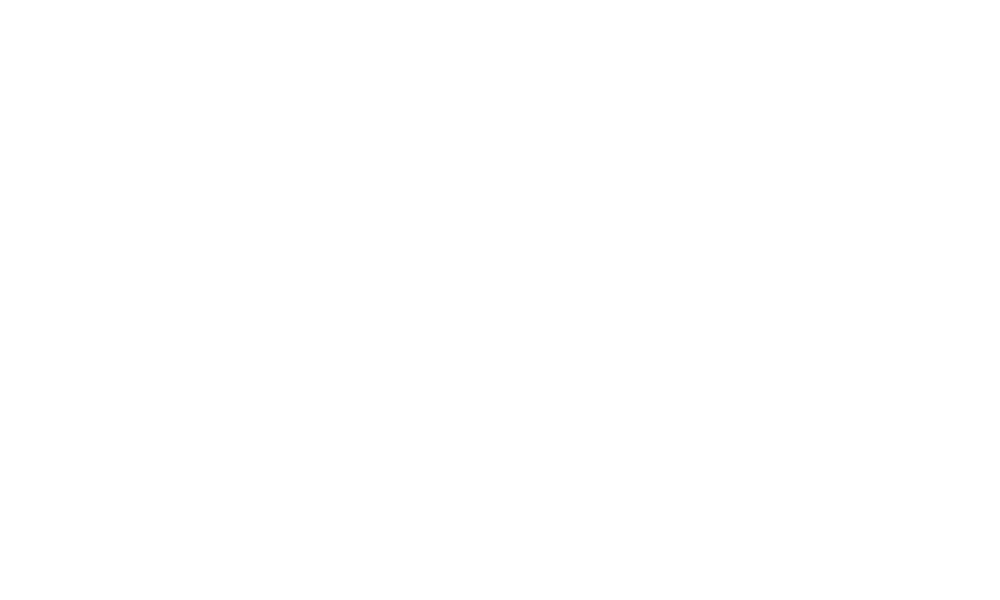

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.000036   -0.039644    0.045090     0.000036     0.000036   
5836  0.000036   -0.039305    0.042282     0.000036     0.000036   
5837  0.000036   -0.039629    0.041130     0.000036     0.000036   
5838  0.000036   -0.040502    0.041982     0.000036     0.000036   
5839  0.000037   -0.040246    0.045638     0.000037     0.000037   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.000810              0.000810              0.000810  0.000077   
5836        0.001122              0.001122              0.001122 -0.000192   
5837        0.001266              0.001266              0.001266 -0.000342   
5838        0.001314              0.001314              0.001314 -0.000275   
5839        0.001215              0.001215              0.001215 -0.000063   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000077     0.000077  0.000174 

<IPython.core.display.Javascript object>


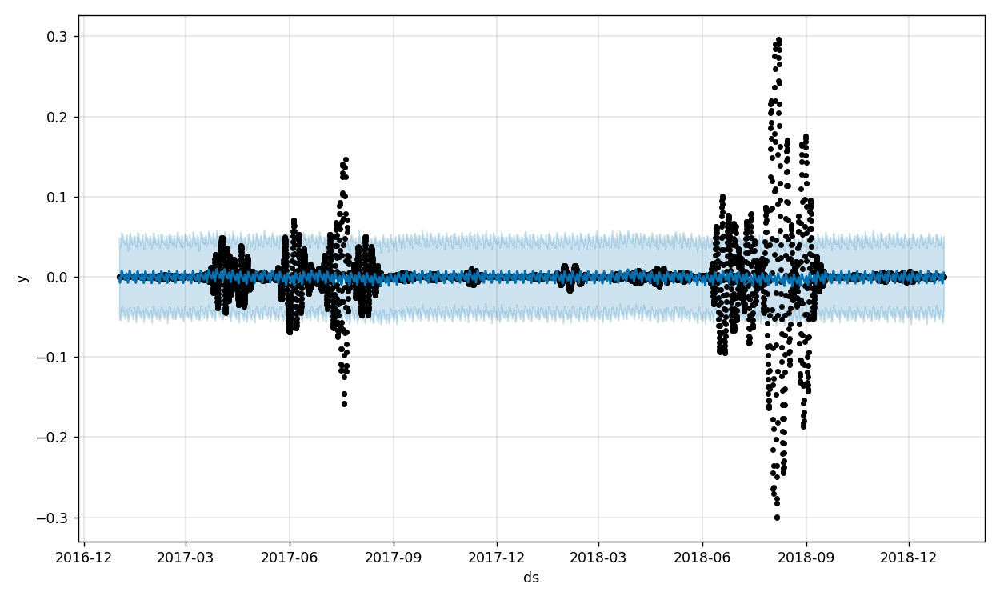

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.001020   -0.048749    0.043441    -0.001020    -0.001020   
5836 -0.001020   -0.049047    0.046741    -0.001020    -0.001020   
5837 -0.001021   -0.040782    0.050930    -0.001021    -0.001021   
5838 -0.001021   -0.042141    0.049209    -0.001021    -0.001021   
5839 -0.001021   -0.039153    0.048103    -0.001021    -0.001021   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.000418             -0.000418             -0.000418 -0.000041   
5836        0.001477              0.001477              0.001477 -0.000098   
5837        0.003330              0.003330              0.003330 -0.000097   
5838        0.005010              0.005010              0.005010 -0.000047   
5839        0.006396              0.006396              0.006396  0.000027   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000041    -0.000041  0.000676 

<IPython.core.display.Javascript object>


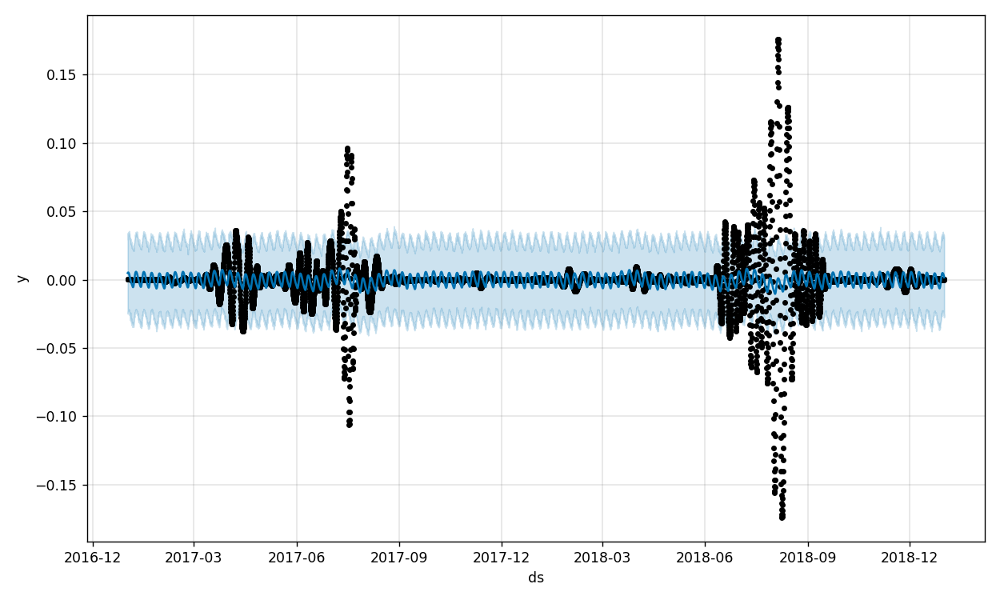

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.000378   -0.023238    0.031910    -0.000378    -0.000378   
5836 -0.000378   -0.025428    0.033079    -0.000378    -0.000378   
5837 -0.000378   -0.025350    0.033030    -0.000378    -0.000378   
5838 -0.000378   -0.027576    0.031437    -0.000378    -0.000378   
5839 -0.000378   -0.026446    0.030859    -0.000378    -0.000378   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835        0.003811              0.003811              0.003811   
5836        0.003426              0.003426              0.003426   
5837        0.002999              0.002999              0.002999   
5838        0.002537              0.002537              0.002537   
5839        0.002050              0.002050              0.002050   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835  3.991438e-06  3.991438e-06  3.991438e-06 -0.000110     -0.000110   
5836  4.960462e-06  4.960462e-06  

<IPython.core.display.Javascript object>


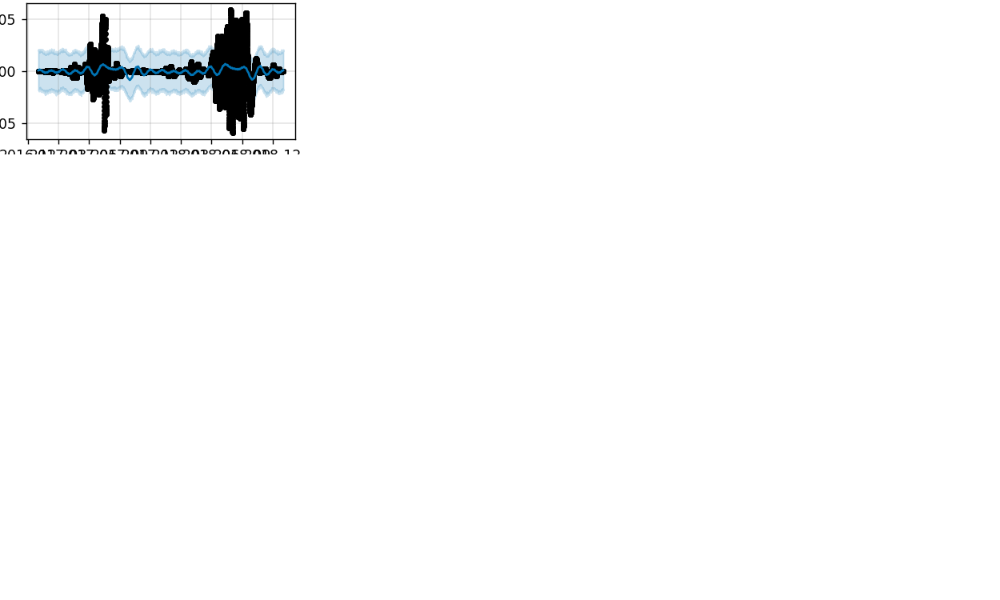

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.000421   -0.018380    0.019913     0.000421     0.000421   
5836  0.000421   -0.017389    0.019122     0.000421     0.000421   
5837  0.000421   -0.018193    0.020440     0.000421     0.000421   
5838  0.000421   -0.018625    0.020212     0.000421     0.000421   
5839  0.000421   -0.017561    0.021006     0.000421     0.000421   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835        0.000493              0.000493              0.000493   
5836        0.000518              0.000518              0.000518   
5837        0.000545              0.000545              0.000545   
5838        0.000574              0.000574              0.000574   
5839        0.000608              0.000608              0.000608   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835 -1.711091e-07 -1.711091e-07 -1.711091e-07  0.000604      0.000604   
5836  4.176740e-09  4.176740e-09  

<IPython.core.display.Javascript object>


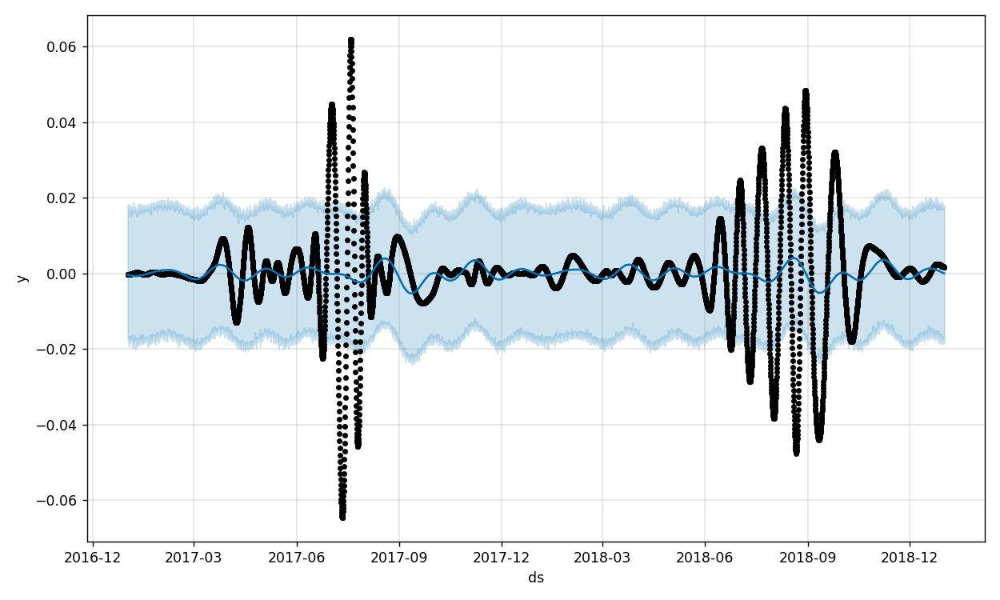

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.000074   -0.017540    0.017258     0.000074     0.000074   
5836  0.000074   -0.017375    0.017391     0.000074     0.000074   
5837  0.000074   -0.016785    0.016947     0.000074     0.000074   
5838  0.000074   -0.018529    0.017892     0.000074     0.000074   
5839  0.000074   -0.016158    0.017086     0.000074     0.000074   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835       -0.000029             -0.000029             -0.000029   
5836       -0.000041             -0.000041             -0.000041   
5837       -0.000054             -0.000054             -0.000054   
5838       -0.000067             -0.000067             -0.000067   
5839       -0.000079             -0.000079             -0.000079   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835 -2.198638e-07 -2.198638e-07 -2.198638e-07 -0.000020     -0.000020   
5836  2.006876e-07  2.006876e-07  

<IPython.core.display.Javascript object>


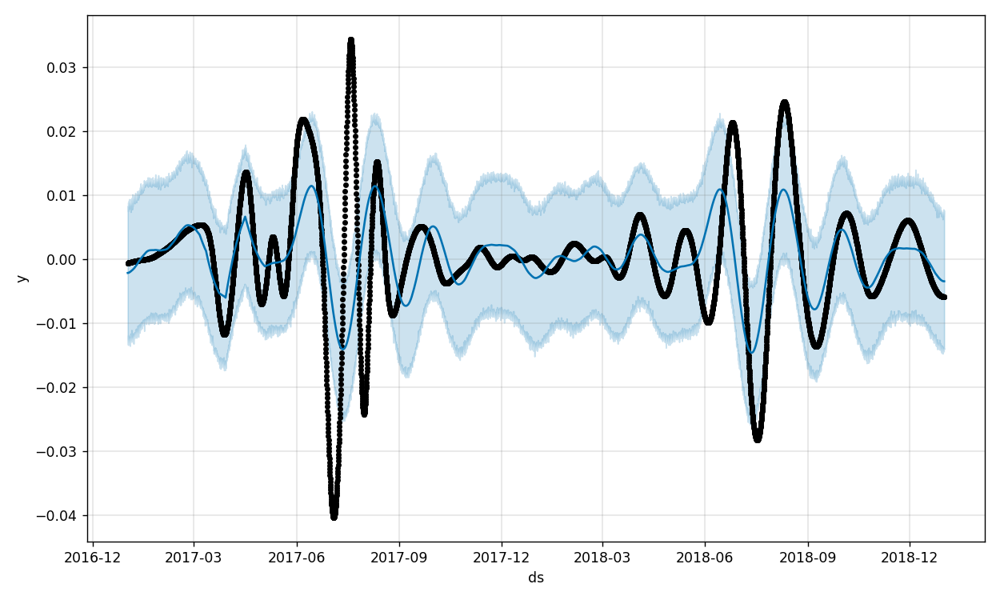

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.000226   -0.013909    0.007148    -0.000226    -0.000226   
5836 -0.000226   -0.014401    0.006710    -0.000226    -0.000226   
5837 -0.000226   -0.013933    0.007504    -0.000226    -0.000226   
5838 -0.000226   -0.013913    0.007627    -0.000226    -0.000226   
5839 -0.000226   -0.014011    0.007233    -0.000226    -0.000226   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835       -0.003225             -0.003225             -0.003225   
5836       -0.003227             -0.003227             -0.003227   
5837       -0.003228             -0.003228             -0.003228   
5838       -0.003228             -0.003228             -0.003228   
5839       -0.003227             -0.003227             -0.003227   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835  6.847039e-07  6.847039e-07  6.847039e-07 -0.003210     -0.003210   
5836 -2.352964e-07 -2.352964e-07 -

<IPython.core.display.Javascript object>


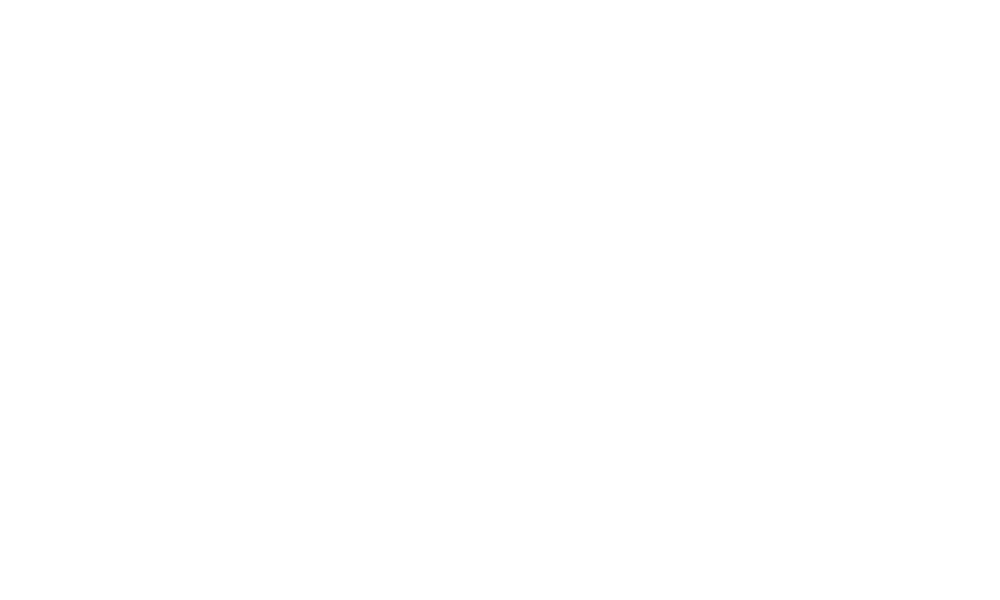

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.001122   -0.007575    0.001391    -0.001122    -0.001122   
5836 -0.001122   -0.007341    0.001955    -0.001122    -0.001122   
5837 -0.001122   -0.007296    0.001453    -0.001122    -0.001122   
5838 -0.001123   -0.007446    0.001738    -0.001123    -0.001123   
5839 -0.001123   -0.007543    0.001457    -0.001123    -0.001123   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835       -0.001827             -0.001827             -0.001827   
5836       -0.001805             -0.001805             -0.001805   
5837       -0.001783             -0.001783             -0.001783   
5838       -0.001760             -0.001760             -0.001760   
5839       -0.001736             -0.001736             -0.001736   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835  3.094864e-07  3.094864e-07  3.094864e-07 -0.001818     -0.001818   
5836 -1.779639e-07 -1.779639e-07 -

<IPython.core.display.Javascript object>


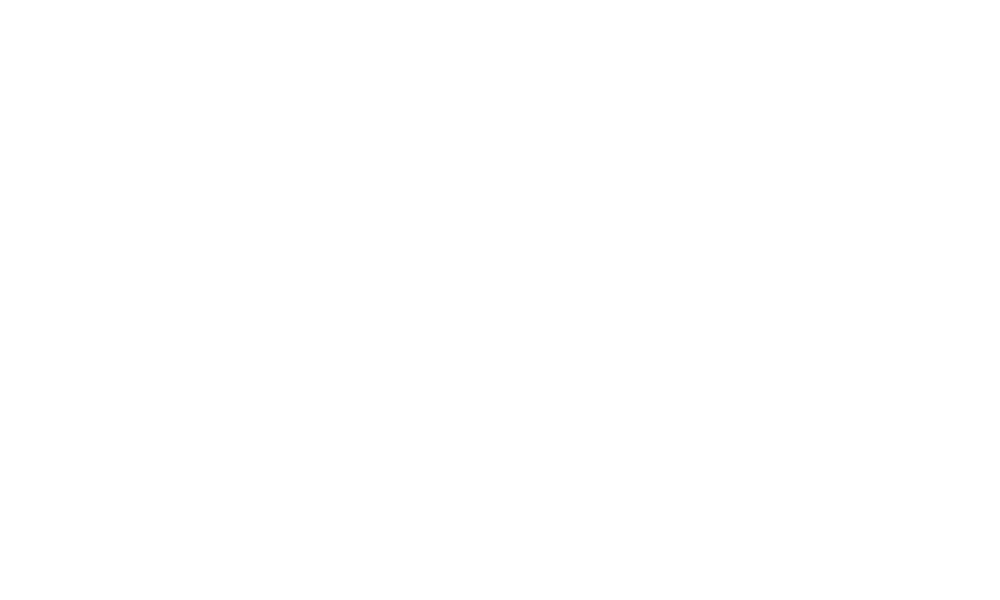

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.003476   -0.003295    0.004710     0.003476     0.003476   
5836  0.003477   -0.003347    0.004733     0.003477     0.003477   
5837  0.003479   -0.003626    0.004506     0.003479     0.003479   
5838  0.003480   -0.003517    0.004571     0.003480     0.003480   
5839  0.003481   -0.003475    0.004424     0.003481     0.003481   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835       -0.002888             -0.002888             -0.002888   
5836       -0.002906             -0.002906             -0.002906   
5837       -0.002925             -0.002925             -0.002925   
5838       -0.002944             -0.002944             -0.002944   
5839       -0.002964             -0.002964             -0.002964   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835 -4.809882e-07 -4.809882e-07 -4.809882e-07 -0.002904     -0.002904   
5836  3.136819e-07  3.136819e-07  

<IPython.core.display.Javascript object>


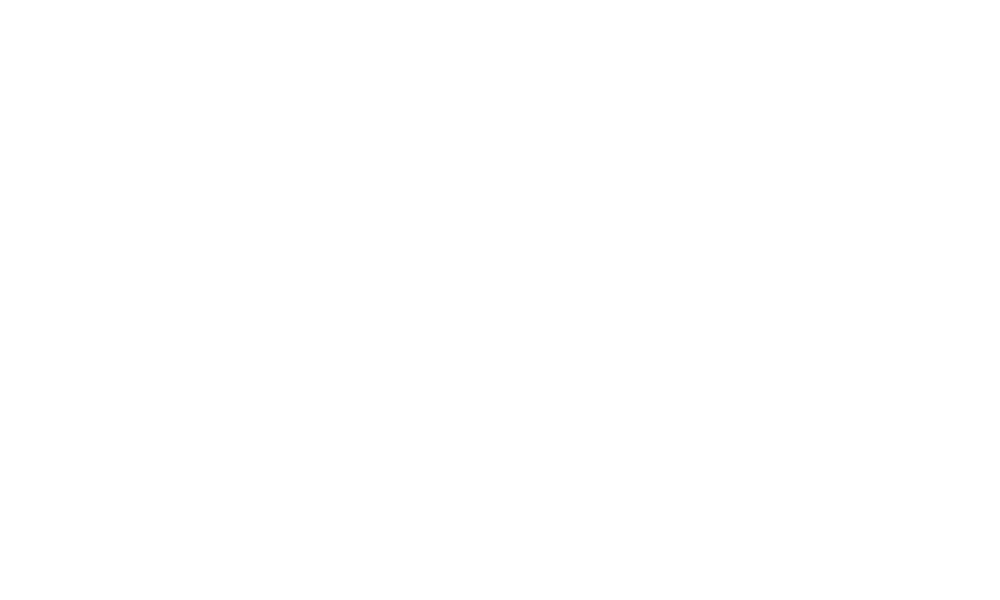

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.004909    0.004729    0.005278     0.004909     0.004909   
5836  0.004909    0.004744    0.005284     0.004909     0.004909   
5837  0.004908    0.004726    0.005283     0.004908     0.004908   
5838  0.004907    0.004735    0.005290     0.004907     0.004907   
5839  0.004906    0.004754    0.005302     0.004906     0.004906   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835        0.000094              0.000094              0.000094   
5836        0.000097              0.000097              0.000097   
5837        0.000099              0.000099              0.000099   
5838        0.000102              0.000102              0.000102   
5839        0.000105              0.000105              0.000105   

             daily   daily_lower   daily_upper    yearly  yearly_lower  \
5835  6.097389e-08  6.097389e-08  6.097389e-08  0.000095      0.000095   
5836 -3.625996e-08 -3.625996e-08 -

<IPython.core.display.Javascript object>


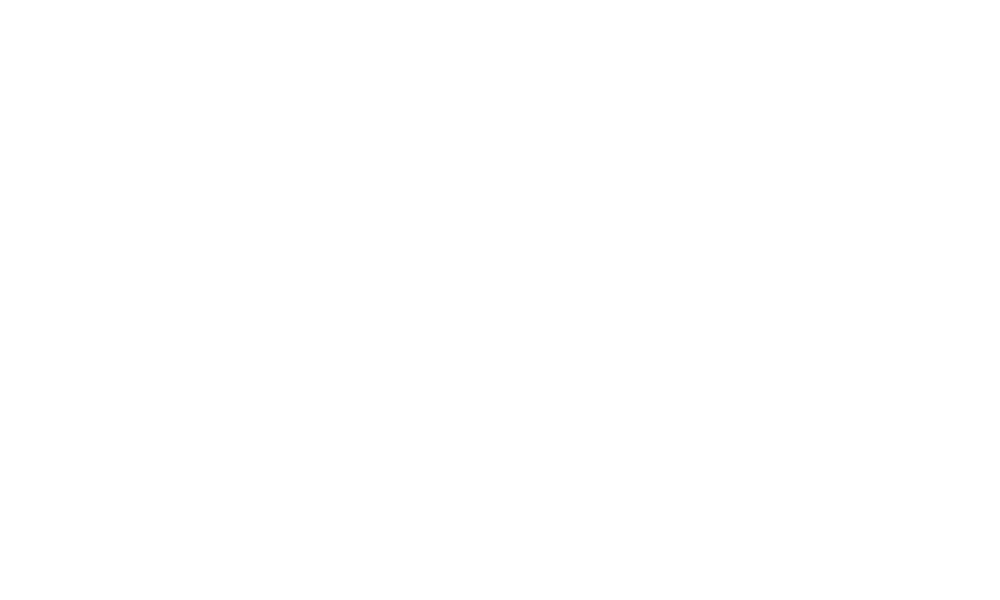

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835 -3.052088e-19 -2.284894e-17  2.054470e-17 -3.052088e-19 -3.052088e-19   
5836 -3.052725e-19 -2.440228e-17  2.281592e-17 -3.052725e-19 -3.052725e-19   
5837 -3.053363e-19 -2.236297e-17  2.400744e-17 -3.053363e-19 -3.053363e-19   
5838 -3.054000e-19 -2.232724e-17  2.460398e-17 -3.054000e-19 -3.054000e-19   
5839 -3.054637e-19 -2.213634e-17  2.123129e-17 -3.054637e-19 -3.054637e-19   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835   -2.927245e-19         -2.927245e-19         -2.927245e-19   
5836    8.307627e-20          8.307627e-20          8.307627e-20   
5837    7.642291e-19          7.642291e-19          7.642291e-19   
5838    7.240614e-19          7.240614e-19          7.240614e-19   
5839   -3.276632e-19         -3.276632e-19         -3.276632e-19   

             daily   daily_lower   daily_upper        yearly  yearly_lower  \
5835 -5.202841e-19 -5.202841e-19 -5.202841e-

<IPython.core.display.Javascript object>


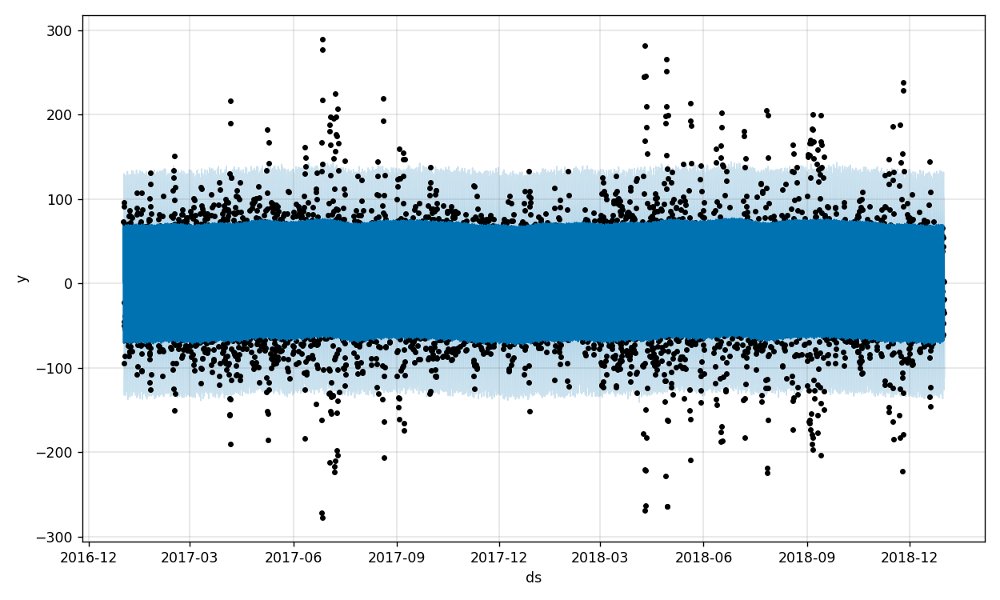

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.294143 -125.587876   -8.705334     0.294143     0.294143   
5836  0.294411  -83.712134   48.737721     0.294411     0.294411   
5837  0.294678  -29.253337  101.961119     0.294678     0.294678   
5838  0.294945  -51.920219   72.822747     0.294945     0.294945   
5839  0.295213 -111.354804   19.269518     0.295213     0.295213   

      additive_terms  additive_terms_lower  additive_terms_upper      daily  \
5835      -67.711355            -67.711355            -67.711355 -65.329132   
5836      -15.063892            -15.063892            -15.063892 -13.146541   
5837       38.076331             38.076331             38.076331  39.605783   
5838       13.089976             13.089976             13.089976  14.346326   
5839      -45.786397            -45.786397            -45.786397 -44.663932   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835   -65.329132   -65.329132 -2.781417    

<IPython.core.display.Javascript object>


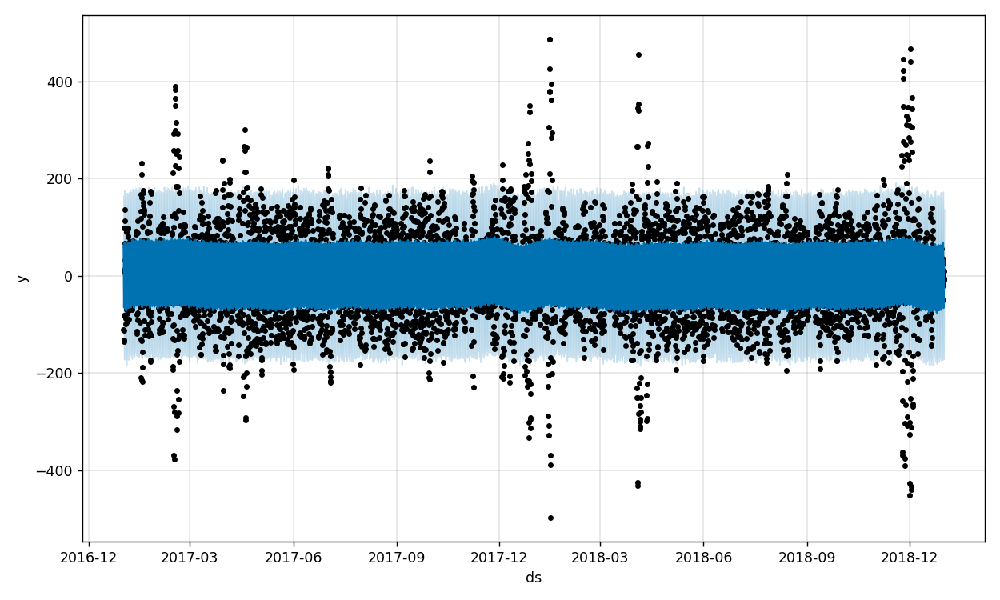

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.069782 -152.606844   67.926546    -0.069782    -0.069782   
5836 -0.070077 -171.834633   32.167749    -0.070077    -0.070077   
5837 -0.070373 -161.444747   52.347927    -0.070373    -0.070373   
5838 -0.070668 -126.083260   88.129582    -0.070668    -0.070668   
5839 -0.070963  -78.278240  137.338199    -0.070963    -0.070963   

      additive_terms  additive_terms_lower  additive_terms_upper      daily  \
5835      -39.721168            -39.721168            -39.721168 -40.237945   
5836      -66.267261            -66.267261            -66.267261 -65.312170   
5837      -55.817262            -55.817262            -55.817262 -53.273492   
5838      -16.859192            -16.859192            -16.859192 -12.760168   
5839       30.928884             30.928884             30.928884  36.400218   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835   -40.237945   -40.237945 -1.667031    

<IPython.core.display.Javascript object>


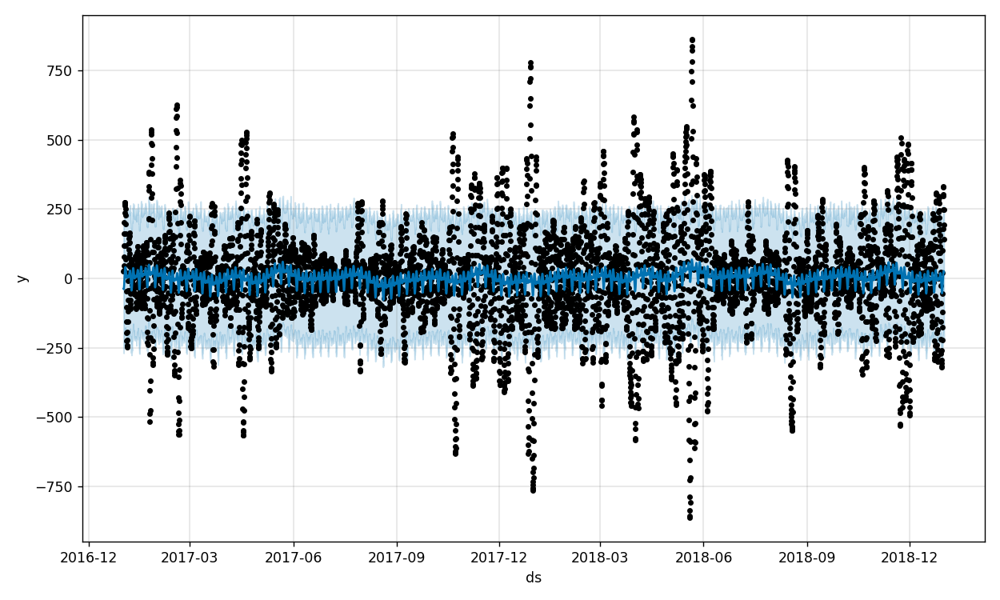

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  7.591632 -204.024475  254.325761     7.591632     7.591632   
5836  7.594270 -188.451854  262.186424     7.594270     7.594270   
5837  7.596908 -195.794917  246.648430     7.596908     7.596908   
5838  7.599546 -201.164387  254.831060     7.599546     7.599546   
5839  7.602184 -224.665653  237.840173     7.602184     7.602184   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       15.636605             15.636605             15.636605 -0.158185   
5836       18.427575             18.427575             18.427575 -0.479755   
5837       18.973292             18.973292             18.973292 -0.500430   
5838       17.492214             17.492214             17.492214 -0.198425   
5839       14.153267             14.153267             14.153267  0.202441   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835    -0.158185    -0.158185 -13.155087    -13.

<IPython.core.display.Javascript object>


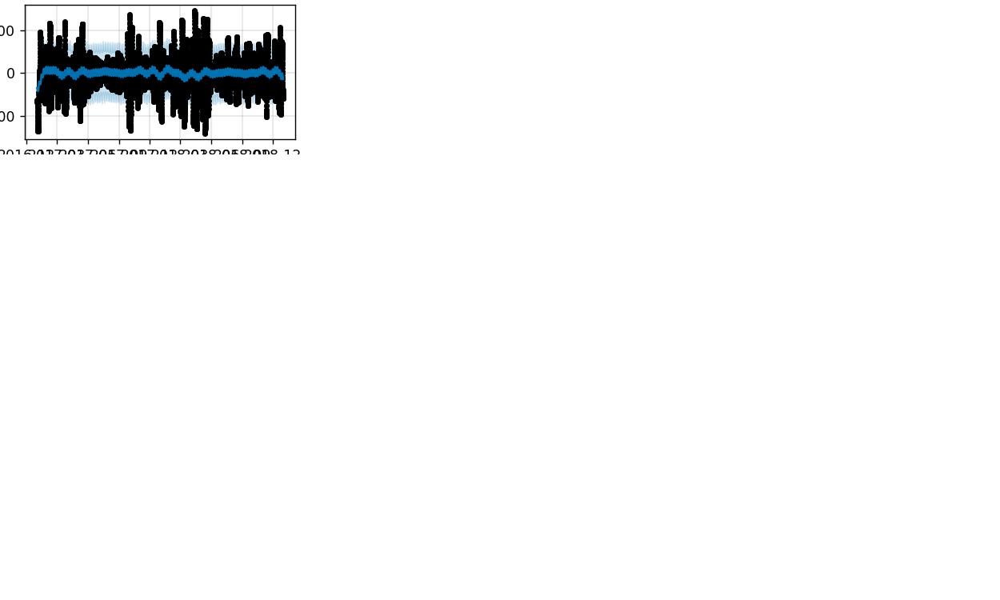

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -6.553278 -337.691365  204.441854    -6.553278    -6.553278   
5836 -6.554729 -351.355787  232.888616    -6.554729    -6.554729   
5837 -6.556180 -352.316666  212.293608    -6.556180    -6.556180   
5838 -6.557631 -367.721714  251.319609    -6.557631    -6.557631   
5839 -6.559083 -364.379451  192.598945    -6.559083    -6.559083   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -55.140143            -55.140143            -55.140143 -0.028176   
5836      -57.668710            -57.668710            -57.668710 -0.039902   
5837      -59.999825            -59.999825            -59.999825 -0.019282   
5838      -62.193979            -62.193979            -62.193979 -0.011538   
5839      -64.260507            -64.260507            -64.260507 -0.006047   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835    -0.028176    -0.028176 -42.079615    -42.

<IPython.core.display.Javascript object>


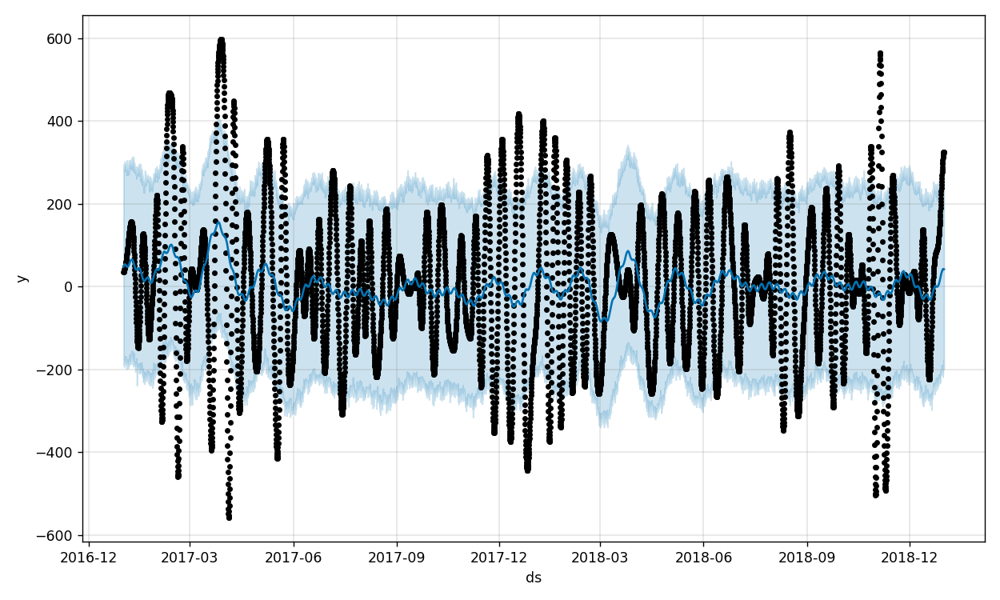

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  7.280983 -194.057335  283.738867     7.280983     7.280983   
5836  7.286203 -184.847185  298.760088     7.286203     7.286203   
5837  7.291422 -178.801626  281.891439     7.291422     7.291422   
5838  7.296642 -198.732520  283.802972     7.296642     7.296642   
5839  7.301861 -199.582562  279.910368     7.301861     7.301861   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       35.102331             35.102331             35.102331 -0.024571   
5836       35.047189             35.047189             35.047189  0.024632   
5837       34.876448             34.876448             34.876448  0.075602   
5838       34.604011             34.604011             34.604011  0.125252   
5839       34.253642             34.253642             34.253642  0.176055   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835    -0.024571    -0.024571  29.176380     29.

<IPython.core.display.Javascript object>


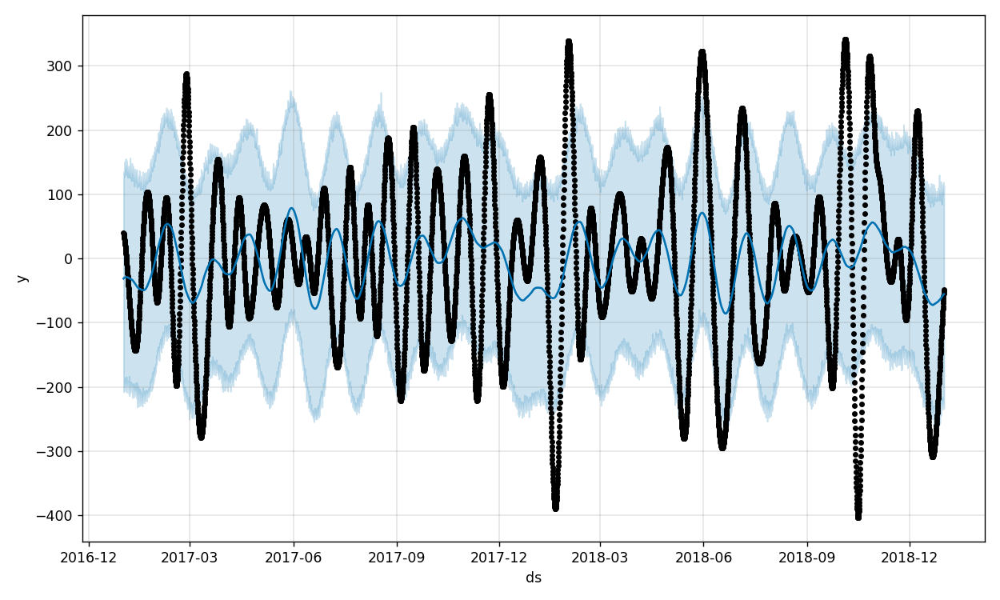

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -8.016289 -226.987571  118.807819    -8.016289    -8.016289   
5836 -8.018667 -226.741362  108.000265    -8.018667    -8.018667   
5837 -8.021046 -227.826159   98.425691    -8.021046    -8.021046   
5838 -8.023424 -230.063976  104.658877    -8.023424    -8.023424   
5839 -8.025802 -233.289855  114.361248    -8.025802    -8.025802   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -48.116359            -48.116359            -48.116359  0.004585   
5836      -47.921975            -47.921975            -47.921975 -0.009373   
5837      -47.727985            -47.727985            -47.727985 -0.015929   
5838      -47.545531            -47.545531            -47.545531 -0.028013   
5839      -47.360636            -47.360636            -47.360636 -0.032832   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835     0.004585     0.004585 -48.712671    -48.

<IPython.core.display.Javascript object>


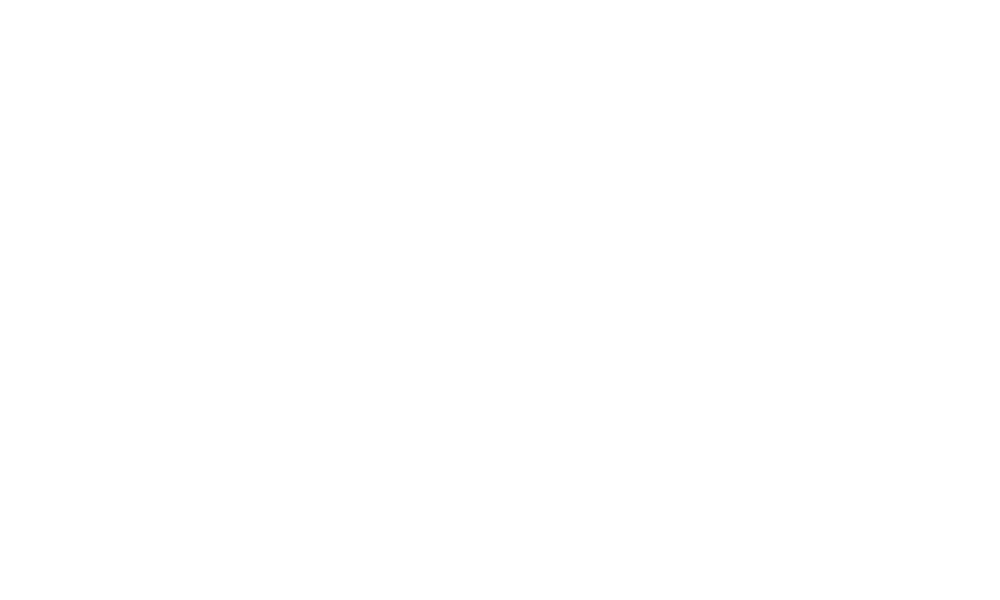

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  8.621331  -36.321641   59.090260     8.621331     8.621331   
5836  8.625389  -38.071904   55.011977     8.625389     8.625389   
5837  8.629447  -41.427709   52.565719     8.629447     8.629447   
5838  8.633505  -41.670154   49.027055     8.633505     8.633505   
5839  8.637563  -48.602172   47.174434     8.637563     8.637563   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        3.077411              3.077411              3.077411 -0.024020   
5836       -0.063898             -0.063898             -0.063898  0.006302   
5837       -3.227246             -3.227246             -3.227246  0.040232   
5838       -6.410317             -6.410317             -6.410317  0.077141   
5839       -9.613464             -9.613464             -9.613464  0.111651   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835    -0.024020    -0.024020  3.083624      3.08

<IPython.core.display.Javascript object>


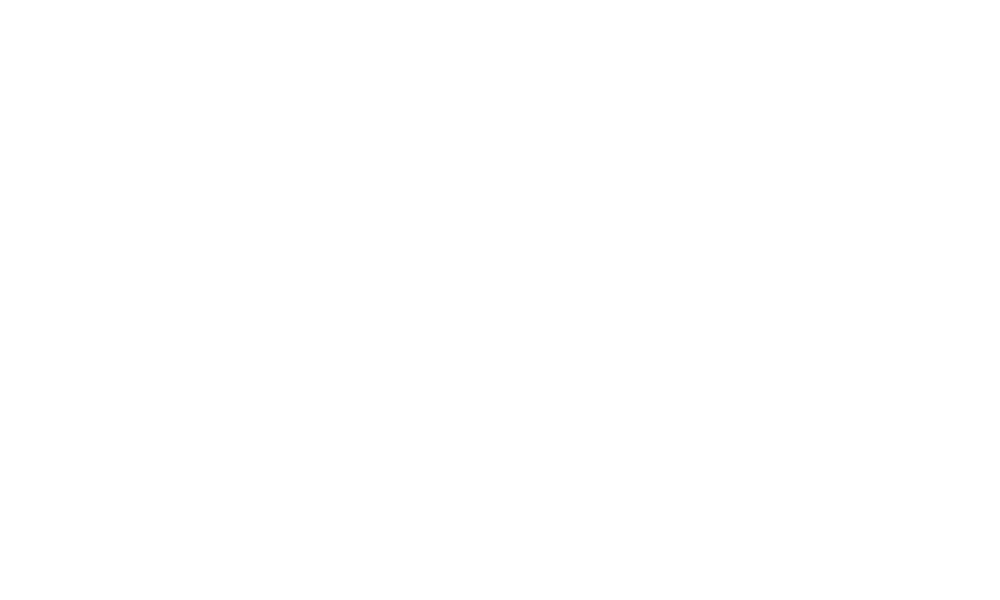

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  140.116720  347.203670  865.178850   140.116720   140.116720   
5836  140.094335  338.395857  863.169195   140.094335   140.094335   
5837  140.071951  316.007744  854.144270   140.071951   140.071951   
5838  140.049567  372.950504  859.871171   140.049567   140.049567   
5839  140.027183  343.723041  868.461882   140.027183   140.027183   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      455.772841            455.772841            455.772841  0.075091   
5836      458.436039            458.436039            458.436039 -0.062925   
5837      461.240867            461.240867            461.240867 -0.165556   
5838      464.095609            464.095609            464.095609 -0.306199   
5839      467.049340            467.049340            467.049340 -0.409180   

      daily_lower  daily_upper      yearly  yearly_lower  yearly_upper  \
5835     0.075091     0.075091  457.

<IPython.core.display.Javascript object>


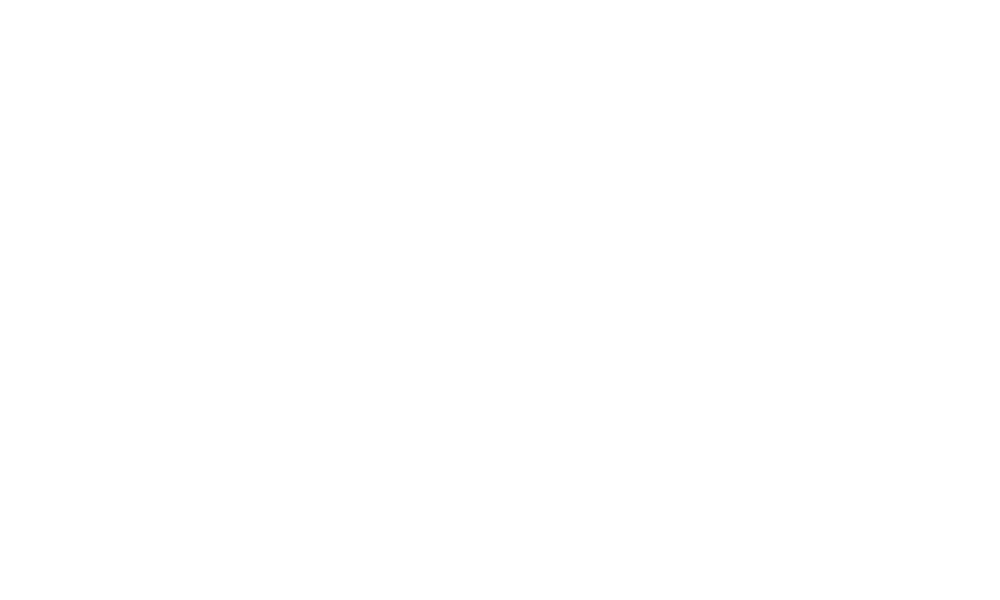

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -255.236889 -349.849946  189.471578  -255.236889  -255.236889   
5836 -255.325647 -356.859916  203.673478  -255.325647  -255.325647   
5837 -255.414405 -361.162471  153.223284  -255.414405  -255.414405   
5838 -255.503163 -371.207997  168.469703  -255.503163  -255.503163   
5839 -255.591921 -372.637586  176.517185  -255.591921  -255.591921   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      166.774149            166.774149            166.774149 -0.074474   
5836      163.240215            163.240215            163.240215  0.067063   
5837      159.577628            159.577628            159.577628  0.209172   
5838      155.807692            155.807692            155.807692  0.352982   
5839      151.958713            151.958713            151.958713  0.496663   

      daily_lower  daily_upper      yearly  yearly_lower  yearly_upper  \
5835    -0.074474    -0.074474  164.

<IPython.core.display.Javascript object>


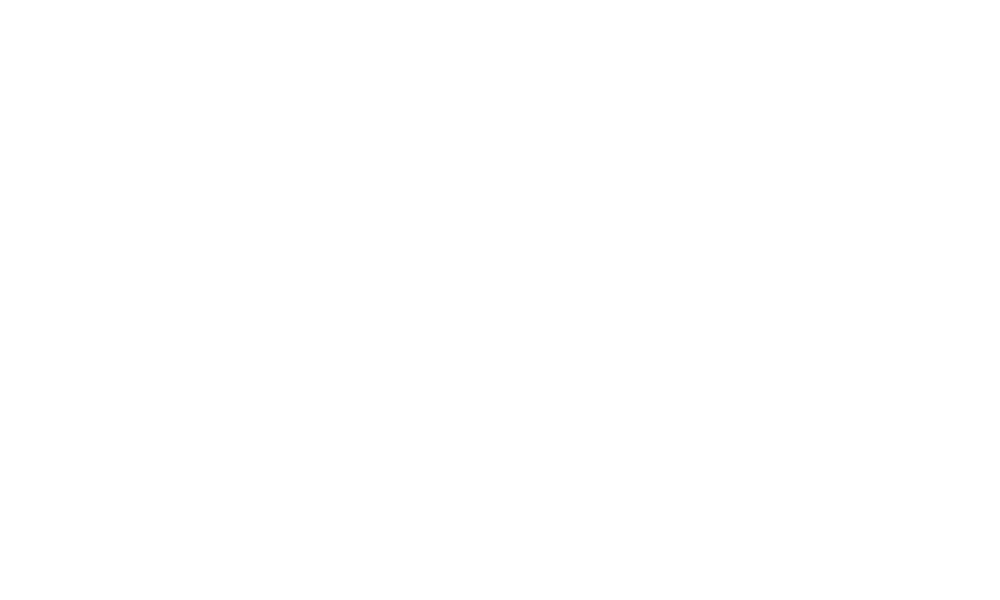

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835  85592.915525  85580.917083  85588.584762  85592.915525  85592.915525   
5836  85593.011417  85581.329784  85588.270991  85593.011417  85593.011417   
5837  85593.107310  85581.095920  85588.630277  85593.107310  85593.107310   
5838  85593.203202  85581.238828  85588.758376  85593.203202  85593.203202   
5839  85593.299095  85581.443459  85589.024622  85593.299095  85593.299095   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -8.246607             -8.246607             -8.246607  0.000634   
5836       -8.222757             -8.222757             -8.222757 -0.000845   
5837       -8.197388             -8.197388             -8.197388 -0.002409   
5838       -8.170476             -8.170476             -8.170476 -0.003825   
5839       -8.142588             -8.142588             -8.142588 -0.005336   

      daily_lower  daily_upper    yearly  yearly_lower  yearly

<IPython.core.display.Javascript object>


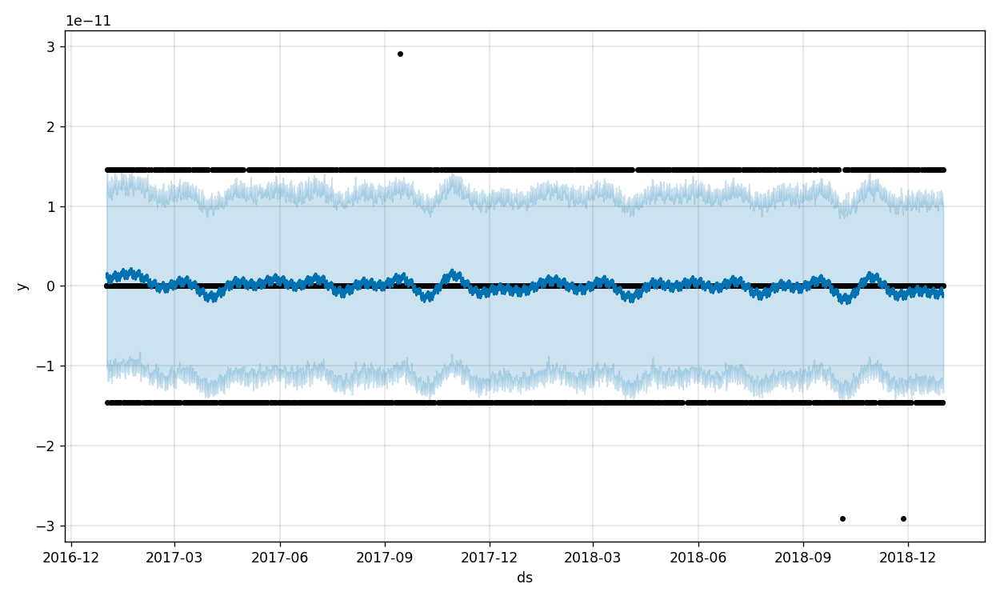

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835 -3.389250e-13 -1.323694e-11  1.021048e-11 -3.389250e-13 -3.389250e-13   
5836 -3.390193e-13 -1.263412e-11  1.035636e-11 -3.390193e-13 -3.390193e-13   
5837 -3.391136e-13 -1.251543e-11  1.071066e-11 -3.391136e-13 -3.391136e-13   
5838 -3.392079e-13 -1.271494e-11  1.027958e-11 -3.392079e-13 -3.392079e-13   
5839 -3.393022e-13 -1.334858e-11  9.925095e-12 -3.393022e-13 -3.393022e-13   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835   -8.224966e-13         -8.224966e-13         -8.224966e-13   
5836   -5.348164e-13         -5.348164e-13         -5.348164e-13   
5837   -9.252467e-13         -9.252467e-13         -9.252467e-13   
5838   -1.091062e-12         -1.091062e-12         -1.091062e-12   
5839   -7.705501e-13         -7.705501e-13         -7.705501e-13   

             daily   daily_lower   daily_upper        yearly  yearly_lower  \
5835 -2.090491e-13 -2.090491e-13 -2.090491e-

<IPython.core.display.Javascript object>


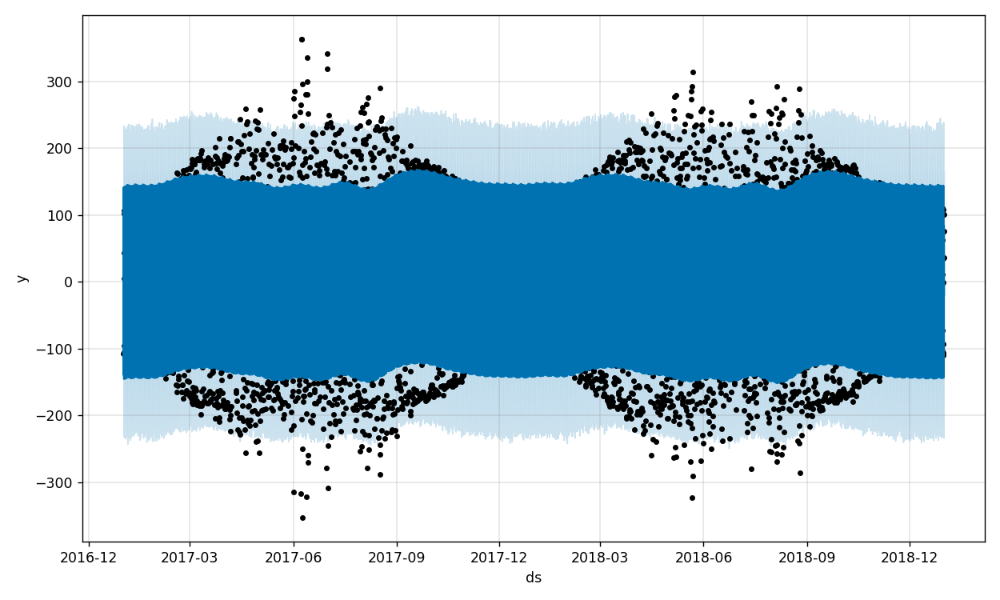

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  3.937589 -115.046404   68.755917     3.937589     3.937589   
5836  3.937076 -233.153551  -59.015439     3.937076     3.937076   
5837  3.936562  -67.290760  106.872920     3.936562     3.936562   
5838  3.936048    1.286072  167.537612     3.936048     3.936048   
5839  3.935534 -108.782172   63.080969     3.935534     3.935534   

      additive_terms  additive_terms_lower  additive_terms_upper       daily  \
5835      -25.456481            -25.456481            -25.456481  -21.044864   
5836     -147.448257           -147.448257           -147.448257 -142.979331   
5837       16.164699             16.164699             16.164699   20.712590   
5838       79.734502             79.734502             79.734502   84.364731   
5839      -24.170270            -24.170270            -24.170270  -19.474521   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835   -21.044864   -21.044864 -4.0040

<IPython.core.display.Javascript object>


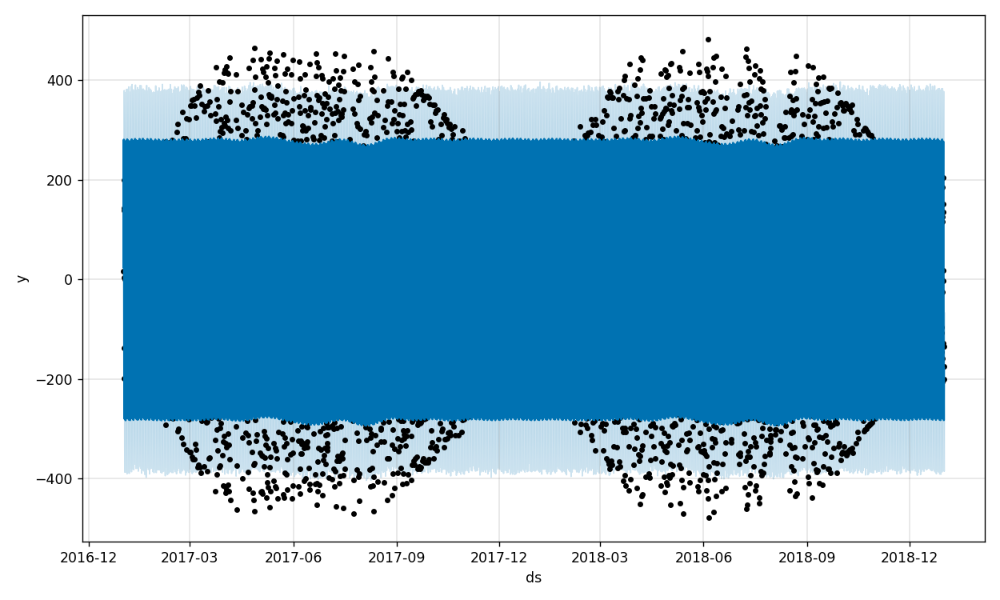

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -3.552563   62.911865  268.288111    -3.552563    -3.552563   
5836 -3.552532 -142.126420   60.339634    -3.552532    -3.552532   
5837 -3.552501 -318.671628 -109.107579    -3.552501    -3.552501   
5838 -3.552471 -384.280166 -181.719101    -3.552471    -3.552471   
5839 -3.552440 -279.339050  -65.644609    -3.552440    -3.552440   

      additive_terms  additive_terms_lower  additive_terms_upper       daily  \
5835      172.670690            172.670690            172.670690  174.092304   
5836      -30.756631            -30.756631            -30.756631  -29.034009   
5837     -215.207576           -215.207576           -215.207576 -213.359952   
5838     -278.817395           -278.817395           -278.817395 -277.030092   
5839     -174.653763           -174.653763           -174.653763 -173.107182   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835   174.092304   174.092304  0.5657

<IPython.core.display.Javascript object>


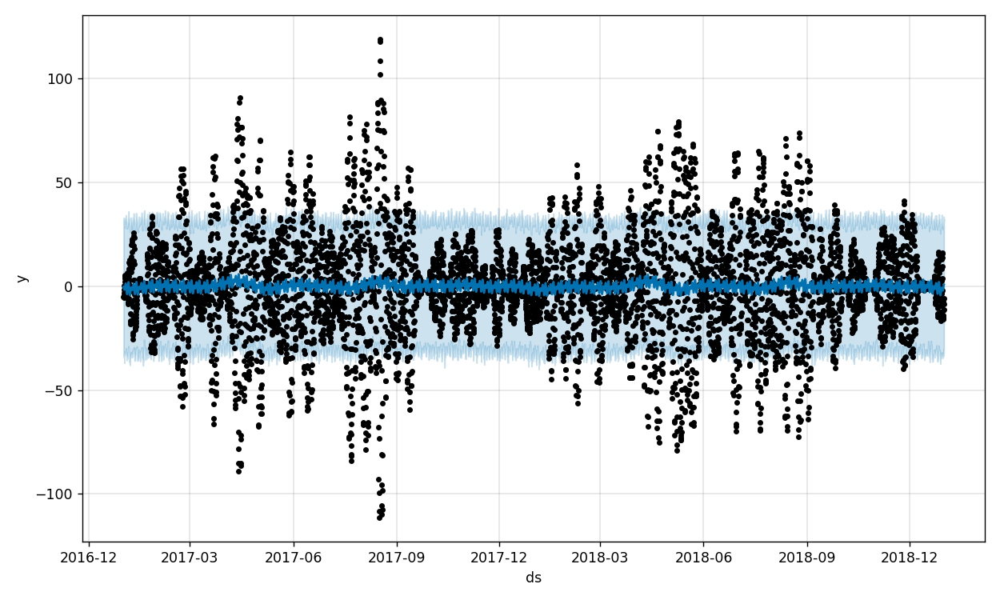

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.216493  -33.553171   31.749776    -0.216493    -0.216493   
5836 -0.216551  -31.969804   29.662560    -0.216551    -0.216551   
5837 -0.216609  -30.337016   33.507961    -0.216609    -0.216609   
5838 -0.216667  -32.031203   31.375950    -0.216667    -0.216667   
5839 -0.216725  -29.050418   32.622828    -0.216725    -0.216725   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.462566             -0.462566             -0.462566 -0.003877   
5836        0.073144              0.073144              0.073144  0.010599   
5837        0.542482              0.542482              0.542482  0.018865   
5838        0.869894              0.869894              0.869894  0.008751   
5839        1.018970              1.018970              1.018970 -0.003748   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.003877    -0.003877 -1.359312 

<IPython.core.display.Javascript object>


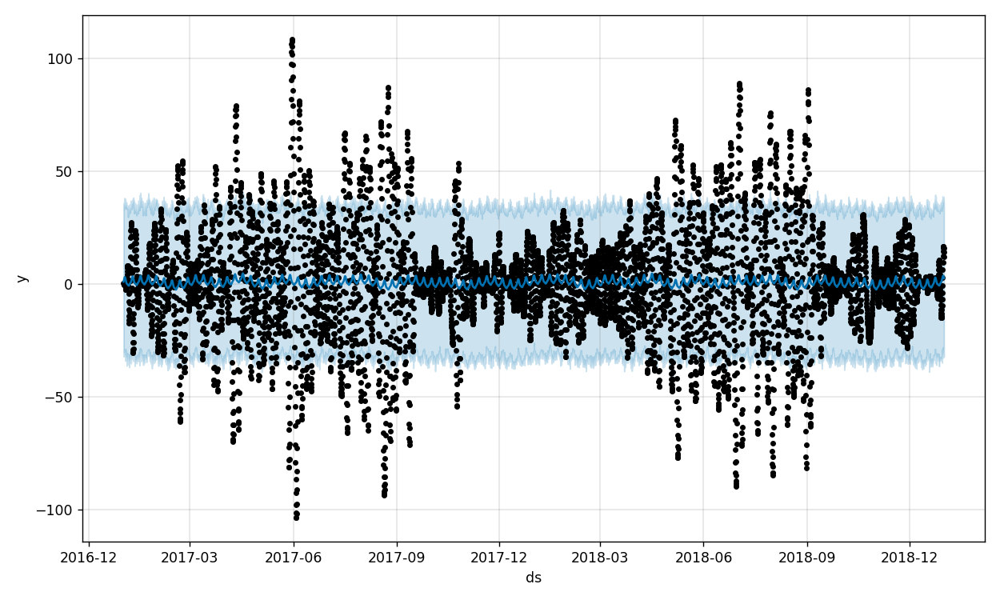

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.548997  -31.809442   38.495986     0.548997     0.548997   
5836  0.548992  -29.478942   37.145815     0.548992     0.548992   
5837  0.548986  -29.174231   38.058241     0.548986     0.548986   
5838  0.548981  -32.503909   36.405759     0.548981     0.548981   
5839  0.548976  -32.061392   33.758071     0.548976     0.548976   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        2.888525              2.888525              2.888525  0.012644   
5836        2.707951              2.707951              2.707951 -0.000845   
5837        2.467787              2.467787              2.467787 -0.014455   
5838        2.192400              2.192400              2.192400 -0.017976   
5839        1.901079              1.901079              1.901079 -0.008581   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.012644     0.012644  0.604331 

<IPython.core.display.Javascript object>


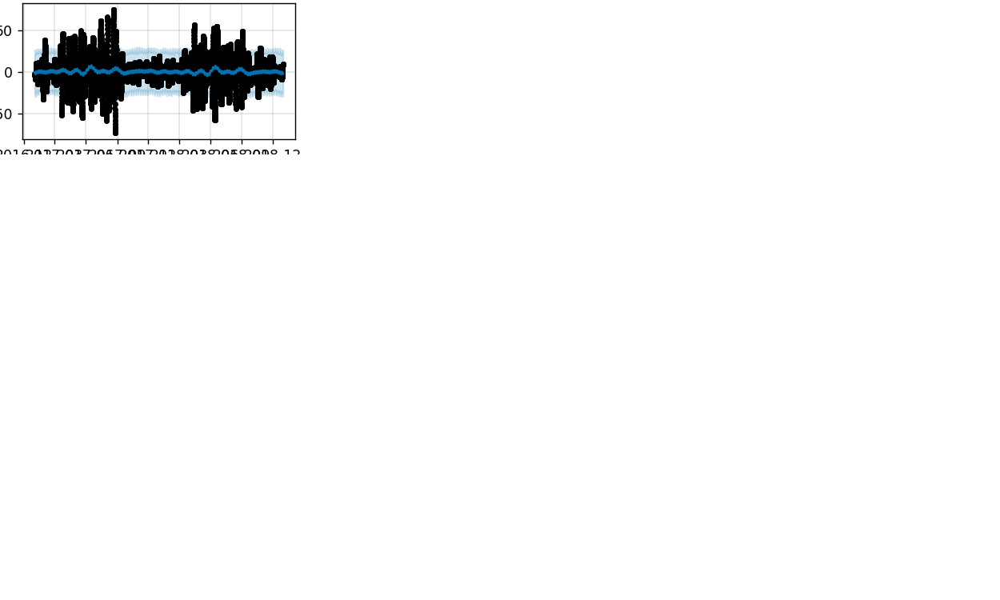

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.096253  -26.037724   23.913855    -0.096253    -0.096253   
5836 -0.096483  -26.473067   23.373688    -0.096483    -0.096483   
5837 -0.096714  -24.352484   25.245739    -0.096714    -0.096714   
5838 -0.096944  -27.497408   22.961794    -0.096944    -0.096944   
5839 -0.097174  -25.151835   24.552050    -0.097174    -0.097174   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -1.443274             -1.443274             -1.443274 -0.002074   
5836       -1.560378             -1.560378             -1.560378  0.003213   
5837       -1.680758             -1.680758             -1.680758  0.006176   
5838       -1.802717             -1.802717             -1.802717  0.008521   
5839       -1.927969             -1.927969             -1.927969  0.008123   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.002074    -0.002074 -1.190912 

<IPython.core.display.Javascript object>


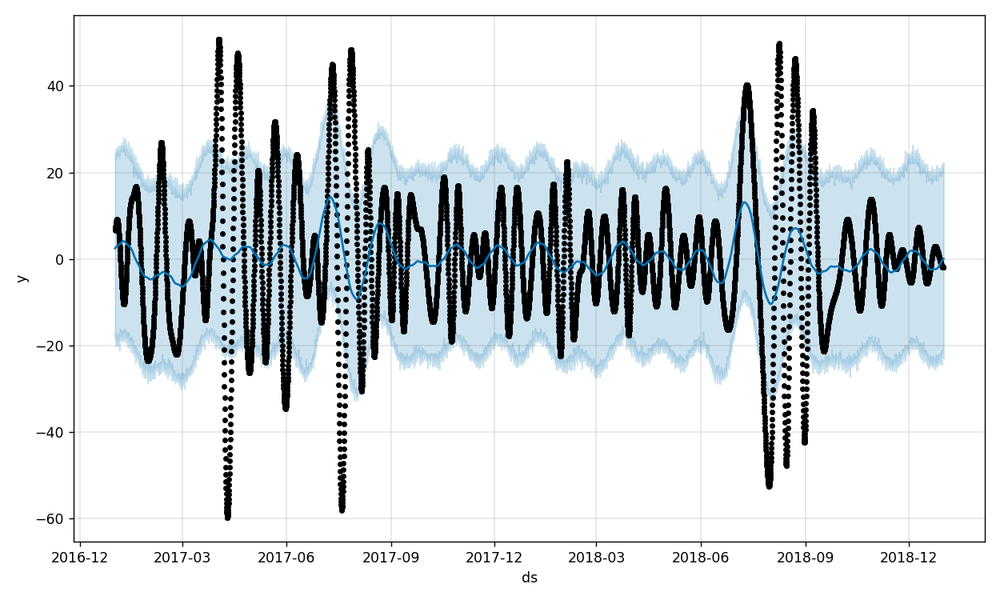

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.617888  -21.103608   20.560292    -0.617888    -0.617888   
5836 -0.618258  -20.841374   21.395442    -0.618258    -0.618258   
5837 -0.618629  -21.611613   22.386041    -0.618629    -0.618629   
5838 -0.619000  -22.938045   21.120283    -0.619000    -0.619000   
5839 -0.619370  -21.757961   21.768477    -0.619370    -0.619370   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.530063              0.530063              0.530063  0.000572   
5836        0.566857              0.566857              0.566857 -0.000263   
5837        0.603185              0.603185              0.603185 -0.001424   
5838        0.639898              0.639898              0.639898 -0.002425   
5839        0.676804              0.676804              0.676804 -0.003746   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000572     0.000572  0.447944 

<IPython.core.display.Javascript object>


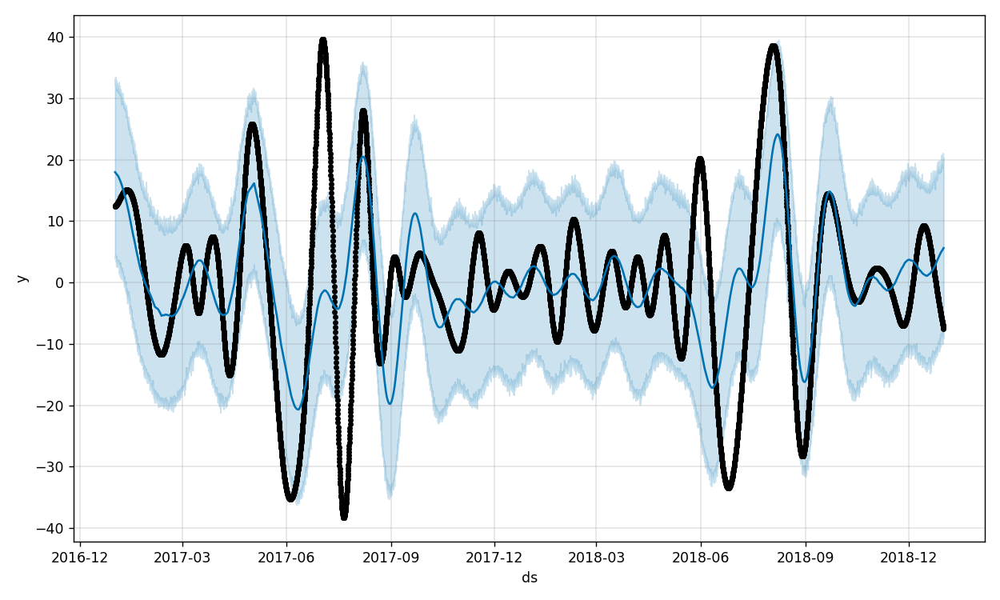

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  2.186251   -9.091299   21.089320     2.186251     2.186251   
5836  2.187472   -8.645578   20.042693     2.187472     2.187472   
5837  2.188692   -8.378972   20.051801     2.188692     2.188692   
5838  2.189912   -9.146409   20.338423     2.189912     2.189912   
5839  2.191133   -8.649004   20.013084     2.191133     2.191133   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        3.238071              3.238071              3.238071  0.000609   
5836        3.279465              3.279465              3.279465 -0.000960   
5837        3.322735              3.322735              3.322735 -0.001991   
5838        3.366355              3.366355              3.366355 -0.003373   
5839        3.410367              3.410367              3.410367 -0.004332   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000609     0.000609  3.304307 

<IPython.core.display.Javascript object>


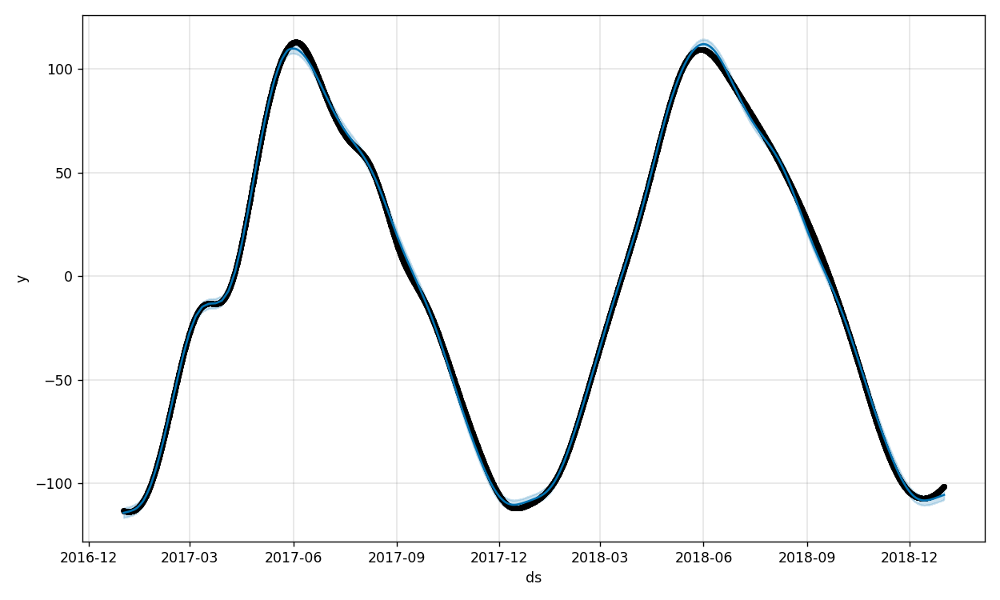

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.793024 -108.056464 -103.166354    -0.793024    -0.793024   
5836 -0.792302 -107.815629 -103.332780    -0.792302    -0.792302   
5837 -0.791580 -107.648474 -103.072308    -0.791580    -0.791580   
5838 -0.790858 -107.843490 -103.172871    -0.790858    -0.790858   
5839 -0.790136 -107.750480 -103.130210    -0.790136    -0.790136   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835     -104.806269           -104.806269           -104.806269 -0.000278   
5836     -104.782844           -104.782844           -104.782844  0.000289   
5837     -104.760097           -104.760097           -104.760097  0.000813   
5838     -104.737741           -104.737741           -104.737741  0.001402   
5839     -104.715688           -104.715688           -104.715688  0.001929   

      daily_lower  daily_upper      yearly  yearly_lower  yearly_upper  \
5835    -0.000278    -0.000278 -104.825974   -10

<IPython.core.display.Javascript object>


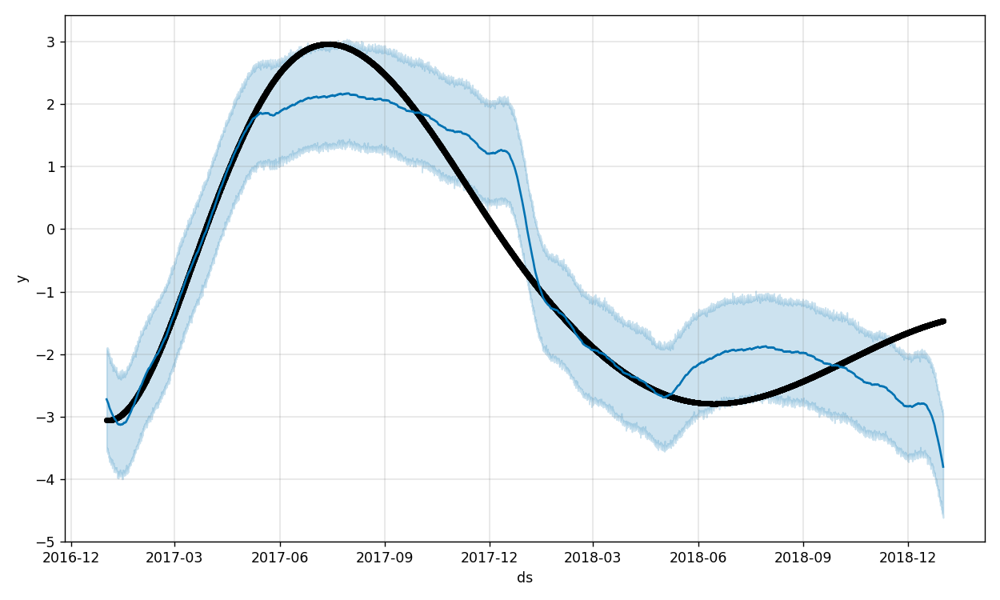

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -4.149040   -4.581687   -2.878152    -4.149040    -4.149040   
5836 -4.150425   -4.539310   -2.896105    -4.150425    -4.150425   
5837 -4.151811   -4.561938   -2.968511    -4.151811    -4.151811   
5838 -4.153197   -4.567816   -2.931661    -4.153197    -4.153197   
5839 -4.154582   -4.619994   -3.007266    -4.154582    -4.154582   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.401195              0.401195              0.401195 -0.000232   
5836        0.389167              0.389167              0.389167  0.000214   
5837        0.376706              0.376706              0.376706  0.000691   
5838        0.363834              0.363834              0.363834  0.001142   
5839        0.350719              0.350719              0.350719  0.001623   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000232    -0.000232  0.393306 

<IPython.core.display.Javascript object>


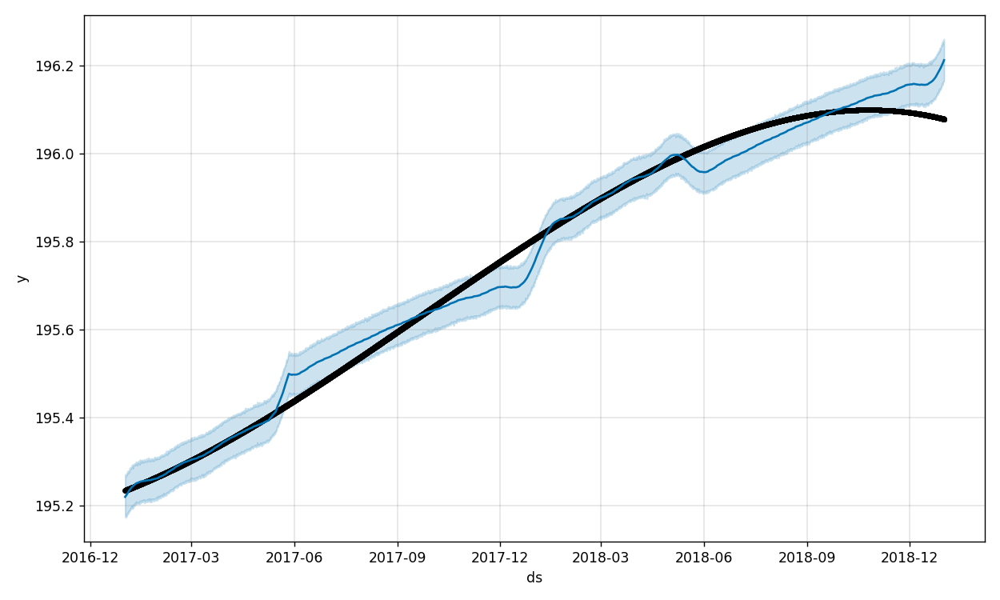

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  196.240422  196.163287  196.255283   196.240422   196.240422   
5836  196.240579  196.163417  196.254831   196.240579   196.240579   
5837  196.240737  196.164049  196.255430   196.240737   196.240737   
5838  196.240894  196.165273  196.260322   196.240894   196.240894   
5839  196.241052  196.164842  196.253523   196.241052   196.241052   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.031538             -0.031538             -0.031538  0.000015   
5836       -0.030888             -0.030888             -0.030888 -0.000012   
5837       -0.030208             -0.030208             -0.030208 -0.000037   
5838       -0.029508             -0.029508             -0.029508 -0.000065   
5839       -0.028790             -0.028790             -0.028790 -0.000091   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835     0.000015     0.000015 -0.0311

<IPython.core.display.Javascript object>


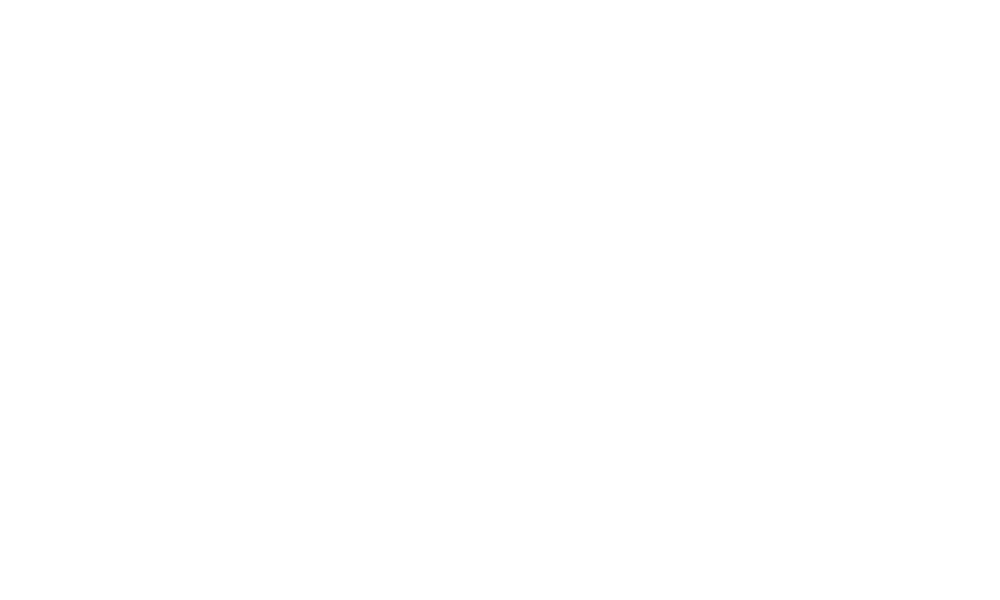

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835  1.021622e-15 -7.249731e-14  6.146131e-14  1.021622e-15  1.021622e-15   
5836  1.021880e-15 -6.960626e-14  6.440367e-14  1.021880e-15  1.021880e-15   
5837  1.022137e-15 -6.878914e-14  7.097671e-14  1.022137e-15  1.022137e-15   
5838  1.022394e-15 -7.062272e-14  6.634200e-14  1.022394e-15  1.022394e-15   
5839  1.022652e-15 -6.836960e-14  6.674207e-14  1.022652e-15  1.022652e-15   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835   -5.421835e-15         -5.421835e-15         -5.421835e-15   
5836   -4.963784e-15         -4.963784e-15         -4.963784e-15   
5837   -1.772217e-15         -1.772217e-15         -1.772217e-15   
5838   -4.008264e-15         -4.008264e-15         -4.008264e-15   
5839   -6.027488e-15         -6.027488e-15         -6.027488e-15   

             daily   daily_lower   daily_upper        yearly  yearly_lower  \
5835 -6.372109e-16 -6.372109e-16 -6.372109e-

<IPython.core.display.Javascript object>


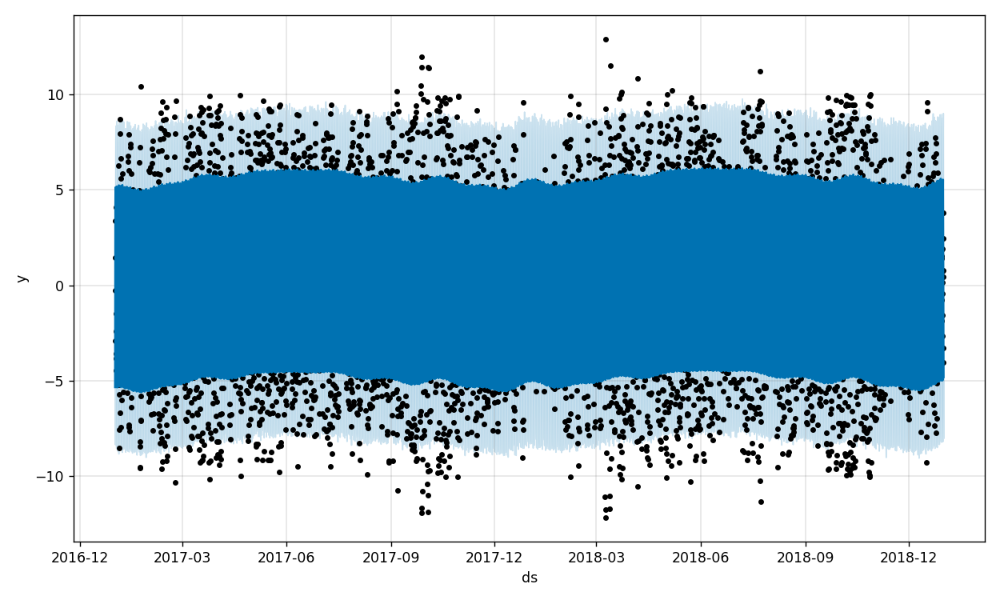

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.118957    2.324639    9.023467     0.118957     0.118957   
5836  0.118978   -0.910948    5.411528     0.118978     0.118978   
5837  0.119000   -3.894846    2.708141     0.119000     0.119000   
5838  0.119021   -6.434970    0.020827     0.119021     0.119021   
5839  0.119043   -8.003020   -1.524012     0.119043     0.119043   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        5.415429              5.415429              5.415429  5.533029   
5836        2.172834              2.172834              2.172834  2.290339   
5837       -0.751660             -0.751660             -0.751660 -0.630945   
5838       -3.245990             -3.245990             -3.245990 -3.119342   
5839       -4.936176             -4.936176             -4.936176 -4.801862   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     5.533029     5.533029 -0.104256 

<IPython.core.display.Javascript object>


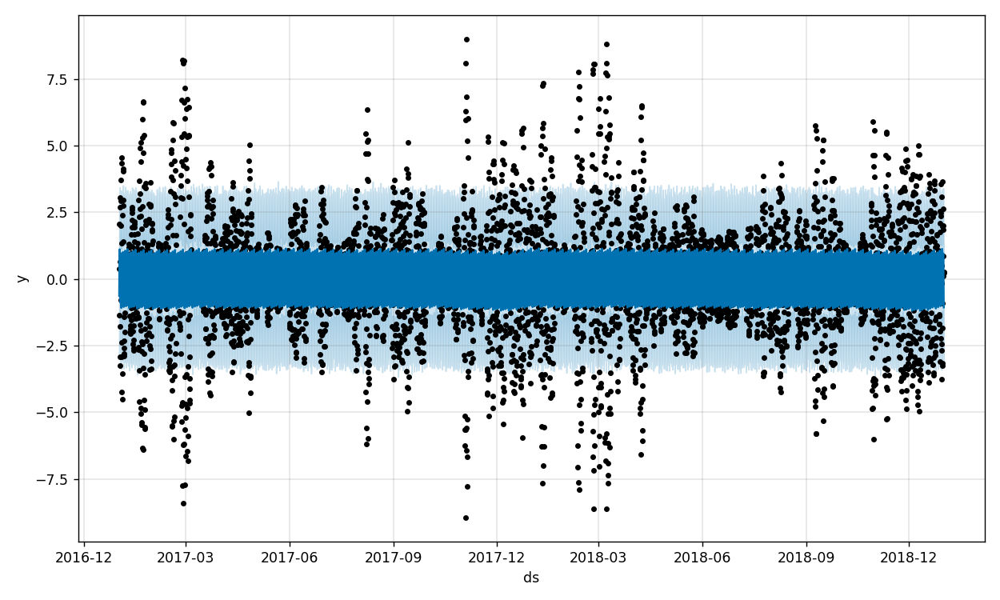

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.007425   -1.460858    3.397302    -0.007425    -0.007425   
5836 -0.007427   -1.695288    2.727624    -0.007427    -0.007427   
5837 -0.007430   -2.580401    2.262731    -0.007430    -0.007430   
5838 -0.007432   -3.178820    1.416233    -0.007432    -0.007432   
5839 -0.007434   -3.316105    1.266348    -0.007434    -0.007434   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.963579              0.963579              0.963579  0.972554   
5836        0.554332              0.554332              0.554332  0.594901   
5837       -0.135098             -0.135098             -0.135098 -0.072164   
5838       -0.771933             -0.771933             -0.771933 -0.697861   
5839       -1.058088             -1.058088             -1.058088 -0.984852   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.972554     0.972554  0.034135 

<IPython.core.display.Javascript object>


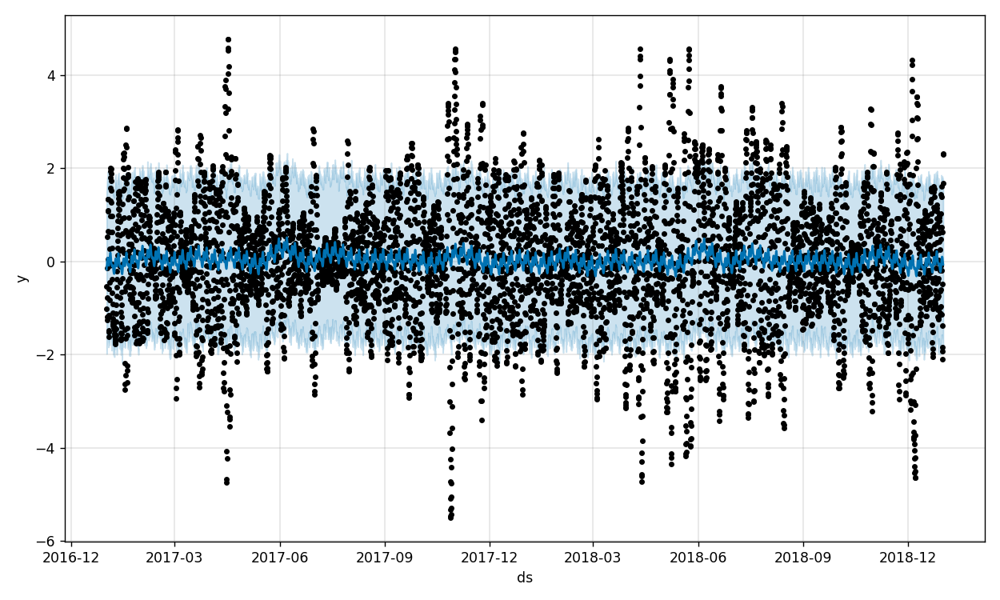

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.006800   -1.678977    1.763709    -0.006800    -0.006800   
5836 -0.006811   -1.644621    1.695490    -0.006811    -0.006811   
5837 -0.006822   -1.779459    1.763719    -0.006822    -0.006822   
5838 -0.006834   -1.774617    1.771112    -0.006834    -0.006834   
5839 -0.006845   -1.900849    1.597930    -0.006845    -0.006845   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.055776              0.055776              0.055776  0.009882   
5836        0.022011              0.022011              0.022011  0.007421   
5837       -0.013495             -0.013495             -0.013495  0.001391   
5838       -0.043866             -0.043866             -0.043866 -0.005128   
5839       -0.062519             -0.062519             -0.062519 -0.008707   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.009882     0.009882 -0.010761 

<IPython.core.display.Javascript object>


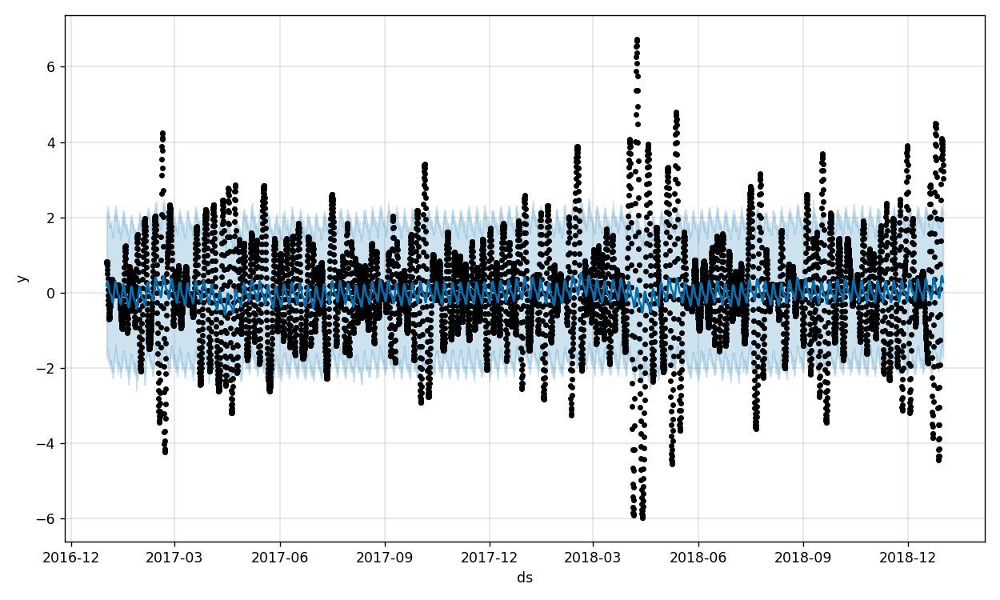

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.038902   -1.610424    2.349153     0.038902     0.038902   
5836  0.038917   -1.535905    2.219226     0.038917     0.038917   
5837  0.038933   -1.413617    2.150013     0.038933     0.038933   
5838  0.038948   -1.732657    2.097924     0.038948     0.038948   
5839  0.038963   -1.591962    2.163595     0.038963     0.038963   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.337756              0.337756              0.337756 -0.000167   
5836        0.314456              0.314456              0.314456 -0.000045   
5837        0.289431              0.289431              0.289431  0.000293   
5838        0.263370              0.263370              0.263370  0.000735   
5839        0.237033              0.237033              0.237033  0.001248   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000167    -0.000167  0.110458 

<IPython.core.display.Javascript object>


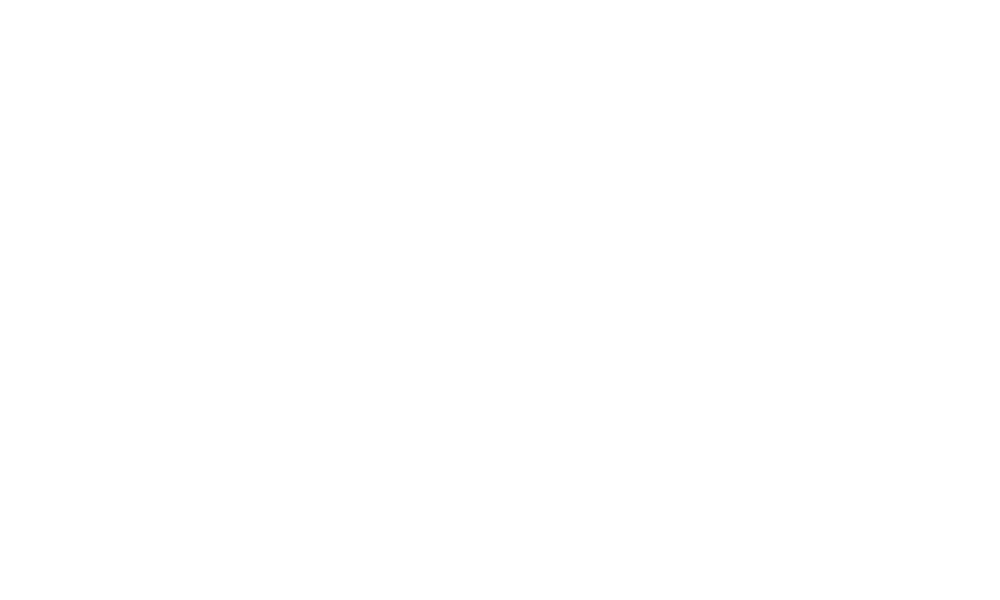

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.242457   -4.667141    1.227423    -0.242457    -0.242457   
5836 -0.242553   -4.174943    1.371691    -0.242553    -0.242553   
5837 -0.242650   -4.172306    1.305942    -0.242650    -0.242650   
5838 -0.242747   -4.382974    1.423181    -0.242747    -0.242747   
5839 -0.242843   -4.365821    1.463412    -0.242843    -0.242843   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -1.300915             -1.300915             -1.300915  0.000872   
5836       -1.290945             -1.290945             -1.290945 -0.000933   
5837       -1.279388             -1.279388             -1.279388 -0.002745   
5838       -1.266591             -1.266591             -1.266591 -0.004549   
5839       -1.252984             -1.252984             -1.252984 -0.006287   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000872     0.000872 -1.308202 

<IPython.core.display.Javascript object>


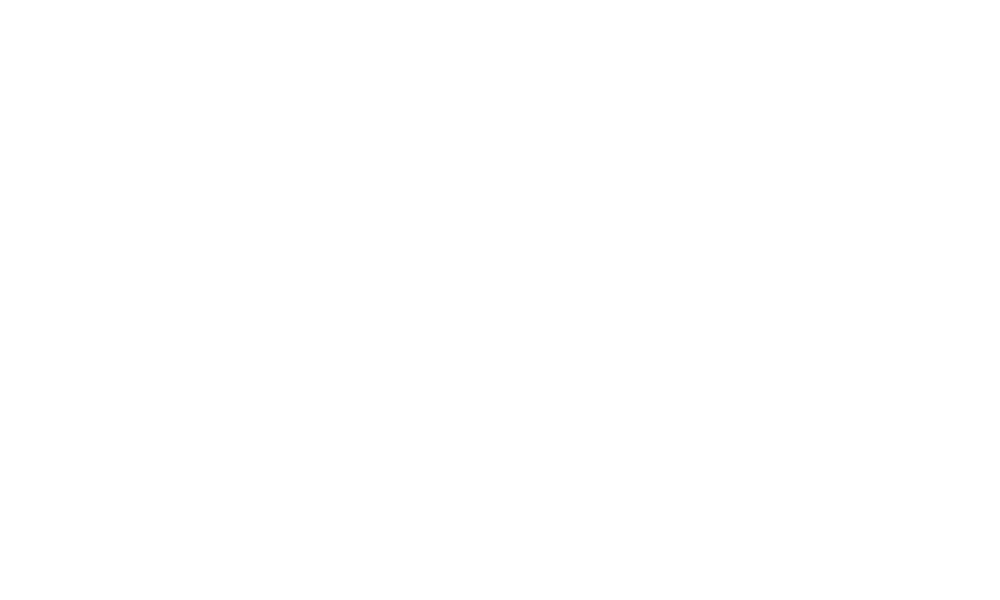

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.128901   -0.639262    2.074671     0.128901     0.128901   
5836  0.128944   -0.606329    2.042255     0.128944     0.128944   
5837  0.128986   -0.683041    2.066827     0.128986     0.128986   
5838  0.129029   -0.605533    2.050300     0.129029     0.129029   
5839  0.129072   -0.683455    2.132820     0.129072     0.129072   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.577790              0.577790              0.577790 -0.000209   
5836        0.590252              0.590252              0.590252  0.000232   
5837        0.602150              0.602150              0.602150  0.000611   
5838        0.613693              0.613693              0.613693  0.001041   
5839        0.624889              0.624889              0.624889  0.001409   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000209    -0.000209  0.568224 

<IPython.core.display.Javascript object>


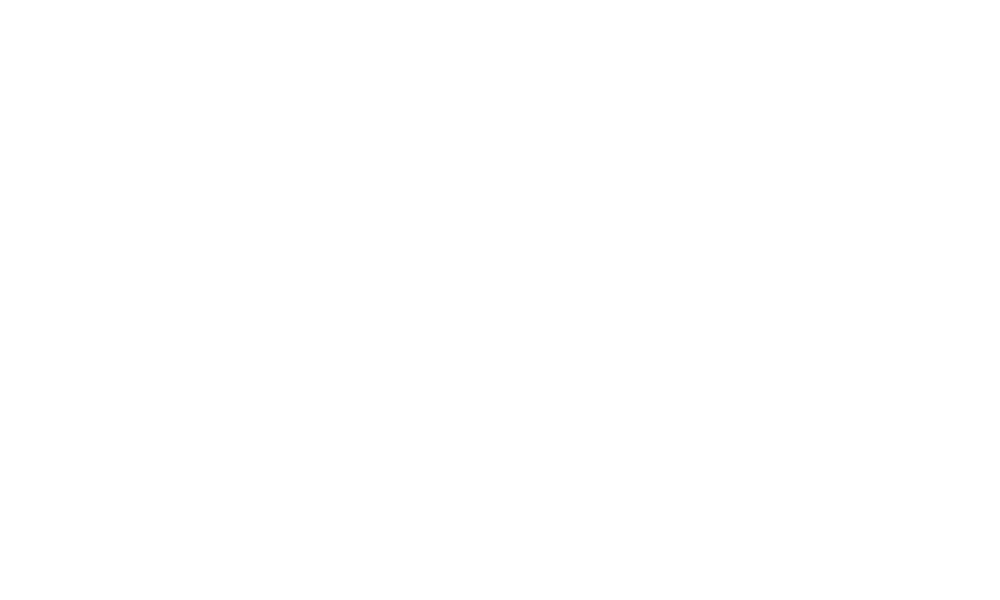

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -3.559697  -11.719342   -9.067561    -3.559697    -3.559697   
5836 -3.562715  -11.606778   -9.047083    -3.562715    -3.562715   
5837 -3.565733  -11.602756   -9.112269    -3.565733    -3.565733   
5838 -3.568751  -11.621195   -8.982896    -3.568751    -3.568751   
5839 -3.571769  -11.771649   -9.085659    -3.571769    -3.571769   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -6.734494             -6.734494             -6.734494 -0.000308   
5836       -6.763846             -6.763846             -6.763846  0.000247   
5837       -6.794205             -6.794205             -6.794205  0.000796   
5838       -6.825406             -6.825406             -6.825406  0.001389   
5839       -6.857366             -6.857366             -6.857366  0.001953   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835    -0.000308    -0.000308 -6.750272     -6.75

<IPython.core.display.Javascript object>


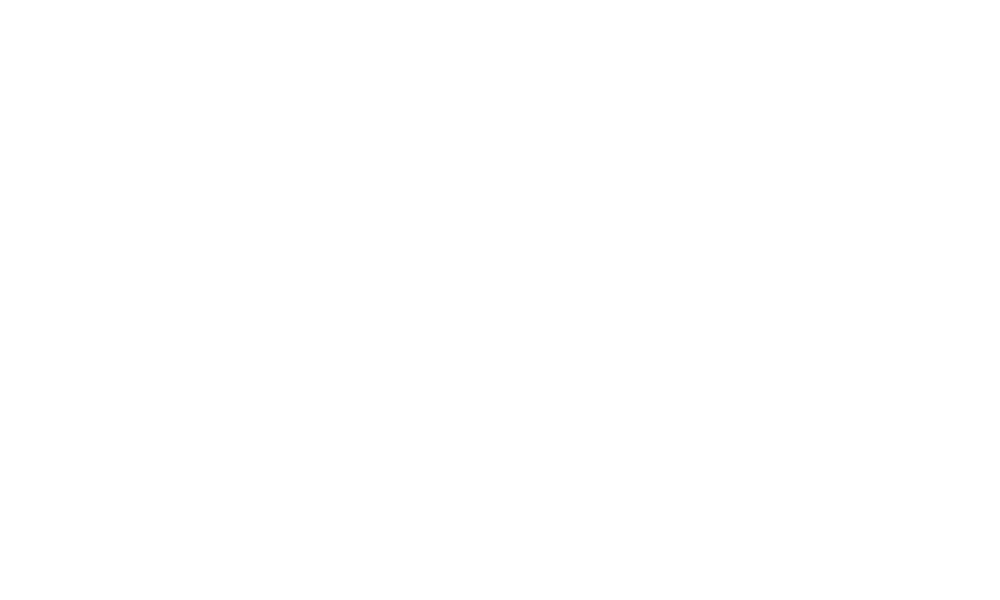

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  5.359773   -8.145344   -2.807663     5.359773     5.359773   
5836  5.362016   -8.182995   -2.806725     5.362016     5.362016   
5837  5.364258   -7.928673   -2.586344     5.364258     5.364258   
5838  5.366501   -7.913375   -2.753272     5.366501     5.366501   
5839  5.368743   -7.677582   -2.614438     5.368743     5.368743   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -10.758501            -10.758501            -10.758501  0.000734   
5836      -10.721134            -10.721134            -10.721134 -0.000711   
5837      -10.682322            -10.682322            -10.682322 -0.002182   
5838      -10.642258            -10.642258            -10.642258 -0.003633   
5839      -10.601331            -10.601331            -10.601331 -0.005110   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835     0.000734     0.000734 -10.734776    -10.

<IPython.core.display.Javascript object>


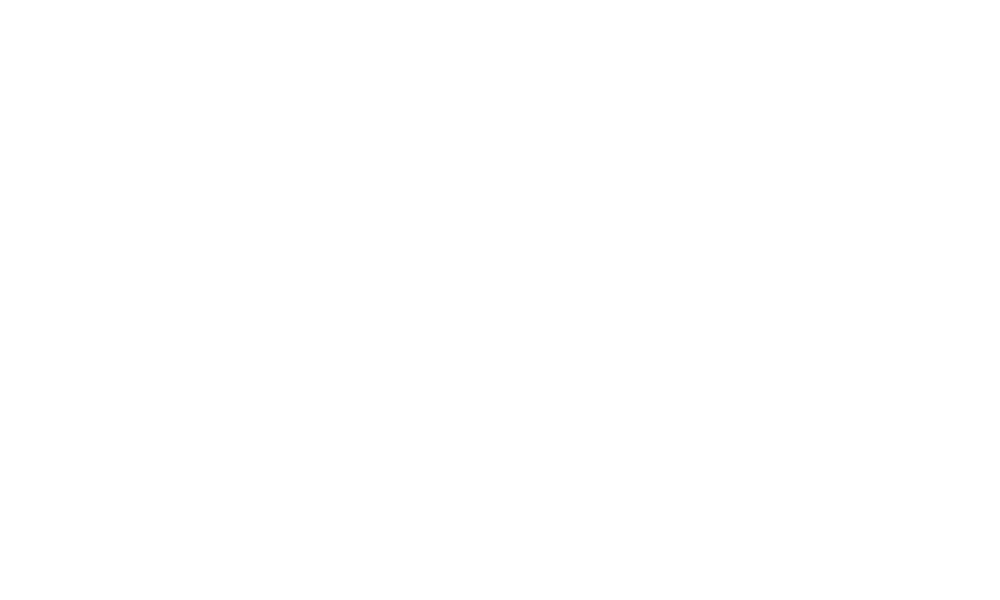

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  278.259829  275.981538  279.392484   278.259829   278.259829   
5836  278.260103  275.926817  279.383458   278.260103   278.260103   
5837  278.260378  275.936788  279.314807   278.260378   278.260378   
5838  278.260652  275.924678  279.305498   278.260652   278.260652   
5839  278.260926  275.942984  279.344661   278.260926   278.260926   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.552235             -0.552235             -0.552235 -0.000366   
5836       -0.570410             -0.570410             -0.570410  0.000216   
5837       -0.589104             -0.589104             -0.589104  0.000932   
5838       -0.608424             -0.608424             -0.608424  0.001557   
5839       -0.628008             -0.628008             -0.628008  0.002288   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper  \
5835    -0.000366    -0.000366 -0.5613

<IPython.core.display.Javascript object>


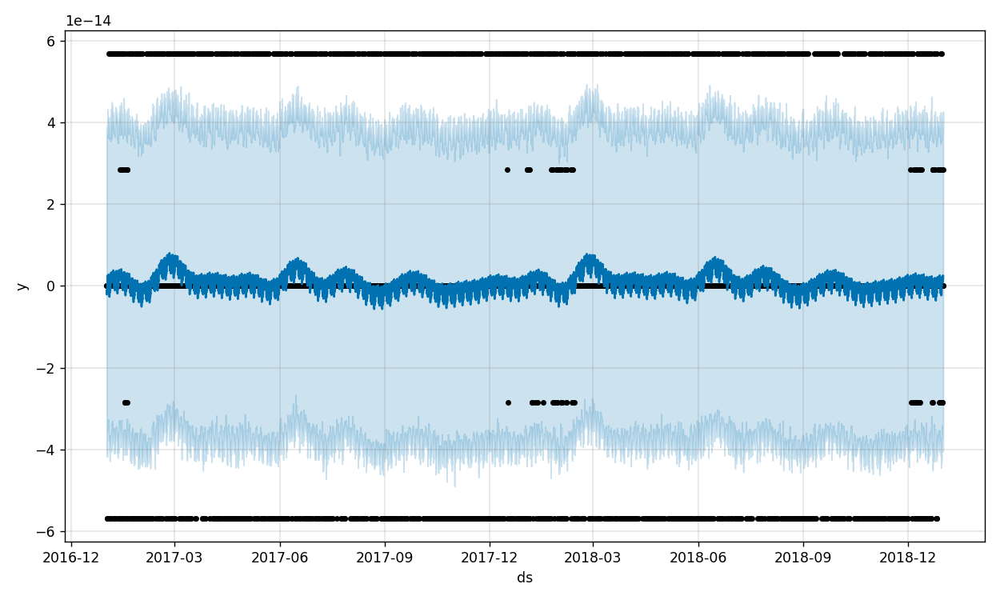

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835  6.608891e-16 -3.918753e-14  3.910686e-14  6.608891e-16  6.608891e-16   
5836  6.609756e-16 -3.959690e-14  4.050625e-14  6.609756e-16  6.609756e-16   
5837  6.610620e-16 -3.713581e-14  4.117234e-14  6.610620e-16  6.610620e-16   
5838  6.611485e-16 -4.052296e-14  3.698085e-14  6.611485e-16  6.611485e-16   
5839  6.612349e-16 -3.578501e-14  4.264399e-14  6.612349e-16  6.612349e-16   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835    7.349181e-16          7.349181e-16          7.349181e-16   
5836    2.377865e-16          2.377865e-16          2.377865e-16   
5837    1.881190e-15          1.881190e-15          1.881190e-15   
5838    8.586319e-16          8.586319e-16          8.586319e-16   
5839    1.726634e-15          1.726634e-15          1.726634e-15   

             daily   daily_lower   daily_upper        yearly  yearly_lower  \
5835 -7.989532e-16 -7.989532e-16 -7.989532e-

<IPython.core.display.Javascript object>


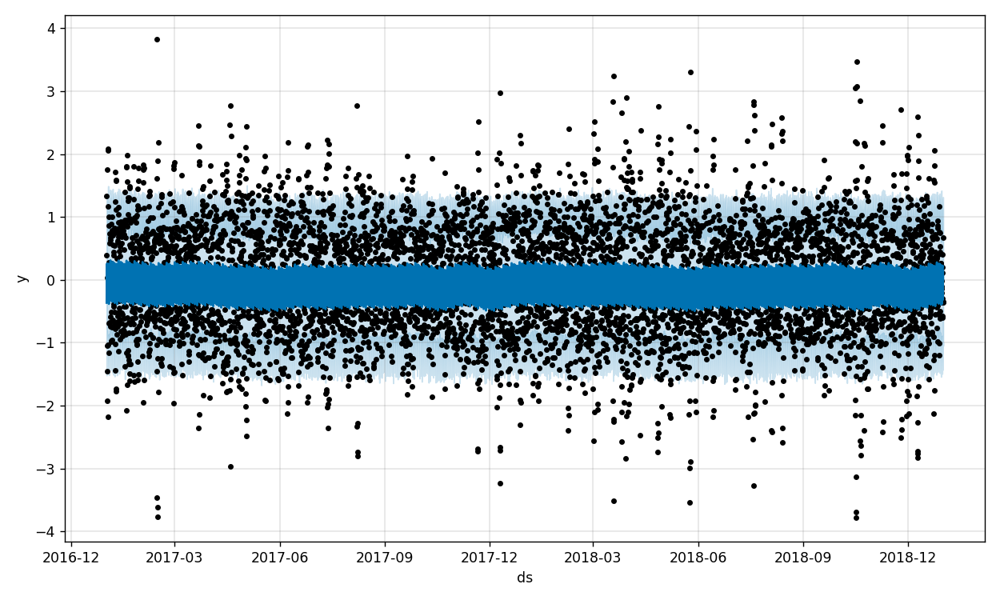

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.010251   -0.891104    1.283130    -0.010251    -0.010251   
5836 -0.010251   -1.431328    0.769269    -0.010251    -0.010251   
5837 -0.010252   -1.132415    1.121286    -0.010252    -0.010252   
5838 -0.010253   -0.988310    1.315296    -0.010253    -0.010253   
5839 -0.010254   -1.049258    1.080898    -0.010254    -0.010254   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.238062              0.238062              0.238062  0.214837   
5836       -0.310781             -0.310781             -0.310781 -0.328390   
5837        0.049303              0.049303              0.049303  0.037337   
5838        0.153109              0.153109              0.153109  0.146085   
5839        0.008837              0.008837              0.008837  0.005351   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.214837     0.214837  0.038567 

<IPython.core.display.Javascript object>


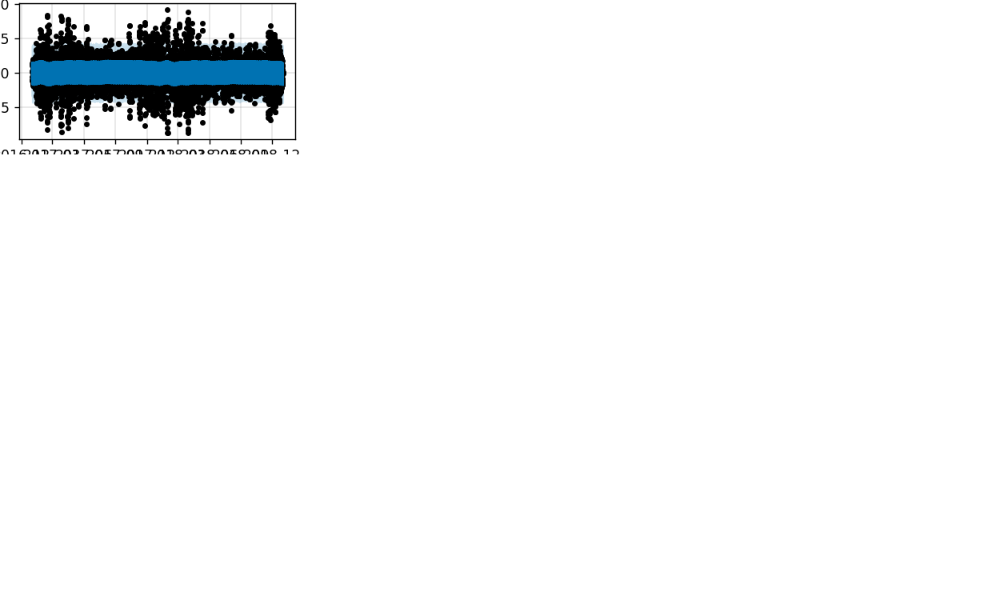

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.039677   -0.597549    1.881244    -0.039677    -0.039677   
5836 -0.039679   -1.164280    1.346339    -0.039679    -0.039679   
5837 -0.039681   -1.693768    0.731313    -0.039681    -0.039681   
5838 -0.039682   -2.039976    0.477656    -0.039682    -0.039682   
5839 -0.039684   -2.108490    0.381751    -0.039684    -0.039684   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.652307              0.652307              0.652307  0.729889   
5836        0.114740              0.114740              0.114740  0.199013   
5837       -0.441037             -0.441037             -0.441037 -0.351894   
5838       -0.782011             -0.782011             -0.782011 -0.690285   
5839       -0.825057             -0.825057             -0.825057 -0.733235   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.729889     0.729889 -0.066368 

<IPython.core.display.Javascript object>


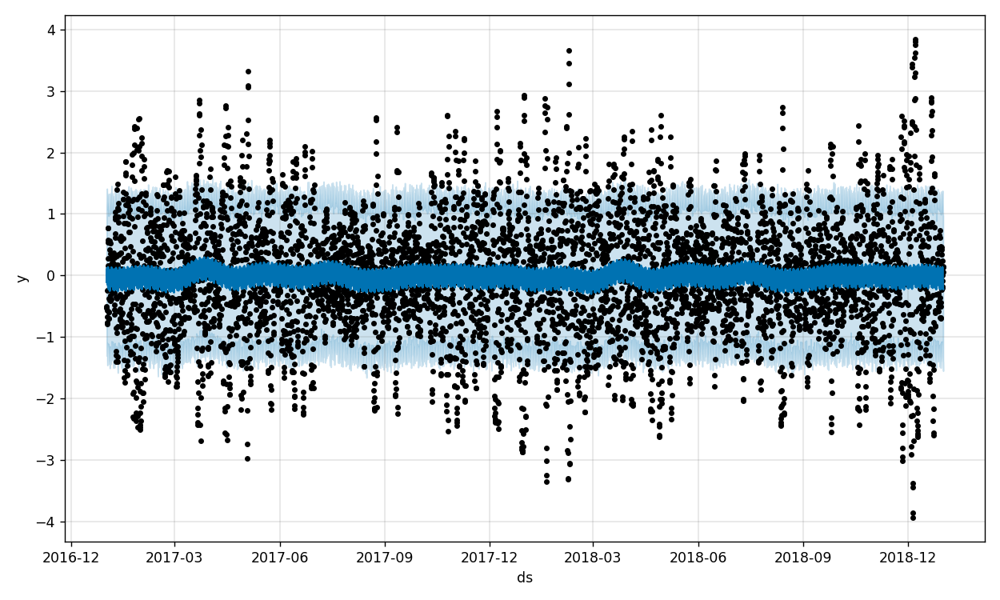

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.028120   -1.097752    1.375524    -0.028120    -0.028120   
5836 -0.028121   -1.137768    1.230399    -0.028121    -0.028121   
5837 -0.028121   -1.396506    1.130343    -0.028121    -0.028121   
5838 -0.028121   -1.399854    0.991114    -0.028121    -0.028121   
5839 -0.028122   -1.551398    0.977200    -0.028122    -0.028122   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.140154              0.140154              0.140154  0.139466   
5836        0.030111              0.030111              0.030111  0.043232   
5837       -0.103035             -0.103035             -0.103035 -0.075370   
5838       -0.192111             -0.192111             -0.192111 -0.150144   
5839       -0.193733             -0.193733             -0.193733 -0.138642   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.139466     0.139466 -0.022869 

<IPython.core.display.Javascript object>


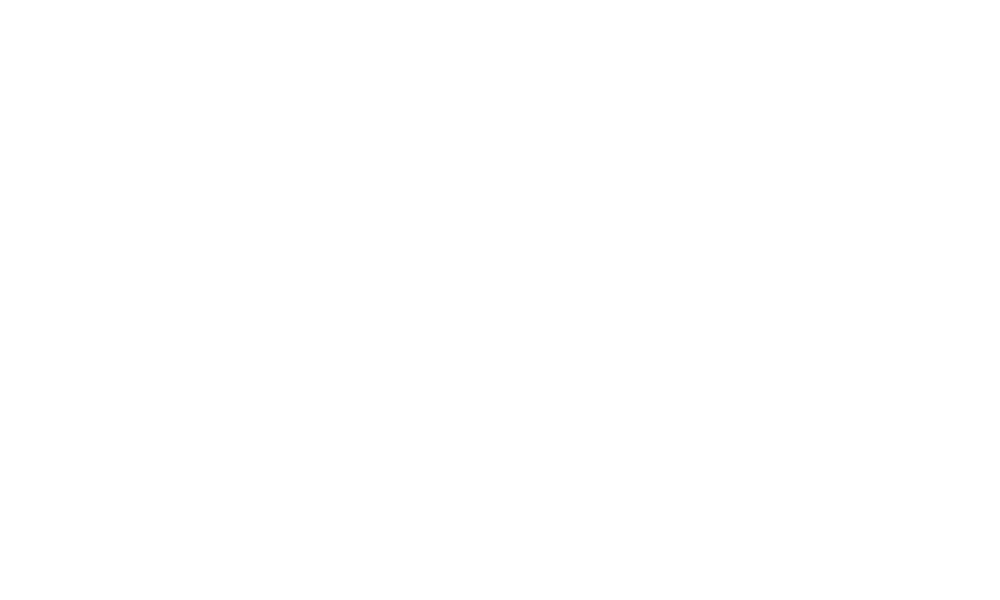

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.046695   -1.162645    1.348742    -0.046695    -0.046695   
5836 -0.046702   -1.269741    1.424818    -0.046702    -0.046702   
5837 -0.046709   -1.212966    1.418176    -0.046709    -0.046709   
5838 -0.046716   -1.375541    1.320255    -0.046716    -0.046716   
5839 -0.046723   -1.426388    1.230866    -0.046723    -0.046723   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.155788              0.155788              0.155788 -0.000060   
5836        0.119391              0.119391              0.119391 -0.000420   
5837        0.078945              0.078945              0.078945 -0.000566   
5838        0.037307              0.037307              0.037307 -0.000581   
5839       -0.002389             -0.002389             -0.002389 -0.000486   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000060    -0.000060  0.064784 

<IPython.core.display.Javascript object>


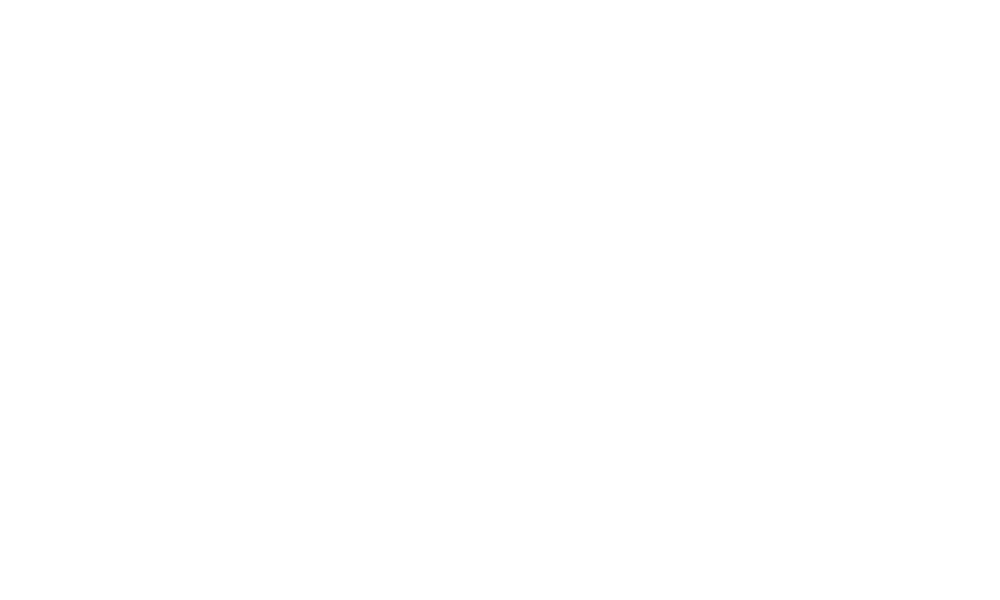

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.001602   -1.201324    1.009032     0.001602     0.001602   
5836  0.001604   -1.242378    0.970691     0.001604     0.001604   
5837  0.001607   -1.229740    0.944530     0.001607     0.001607   
5838  0.001610   -1.214778    0.887195     0.001610     0.001610   
5839  0.001613   -1.222422    0.894406     0.001613     0.001613   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.122941             -0.122941             -0.122941  0.000165   
5836       -0.123745             -0.123745             -0.123745 -0.000122   
5837       -0.124256             -0.124256             -0.124256 -0.000406   
5838       -0.124638             -0.124638             -0.124638 -0.000711   
5839       -0.124972             -0.124972             -0.124972 -0.000995   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000165     0.000165 -0.085918 

<IPython.core.display.Javascript object>


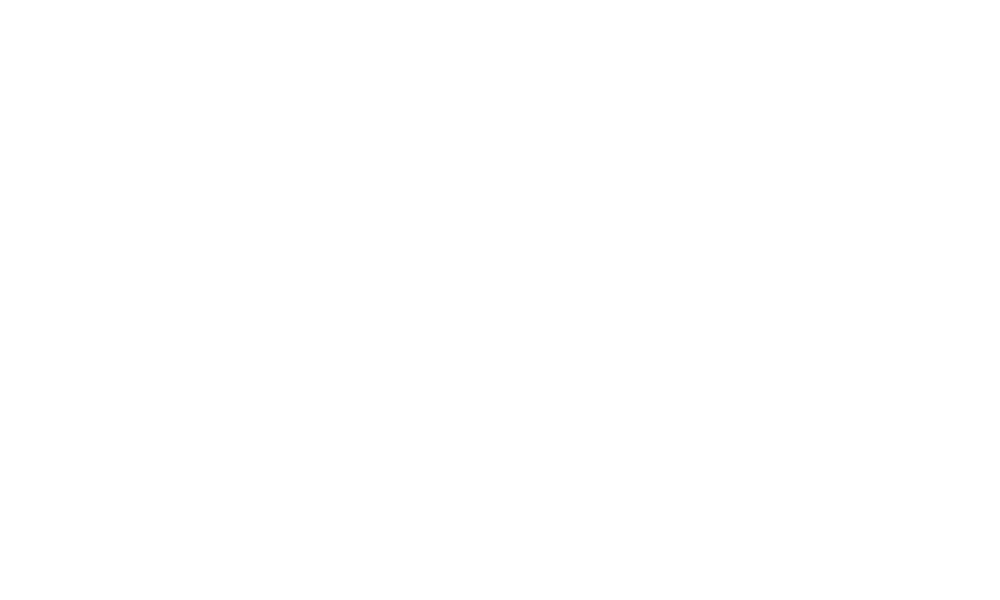

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.000612   -0.713720    0.755960     0.000612     0.000612   
5836  0.000614   -0.680666    0.709813     0.000614     0.000614   
5837  0.000616   -0.689274    0.679380     0.000616     0.000616   
5838  0.000618   -0.728117    0.753202     0.000618     0.000618   
5839  0.000621   -0.731665    0.765590     0.000621     0.000621   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.019607              0.019607              0.019607  0.000048   
5836        0.018648              0.018648              0.018648 -0.000047   
5837        0.017811              0.017811              0.017811 -0.000128   
5838        0.017060              0.017060              0.017060 -0.000215   
5839        0.016393              0.016393              0.016393 -0.000290   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000048     0.000048  0.025300 

<IPython.core.display.Javascript object>


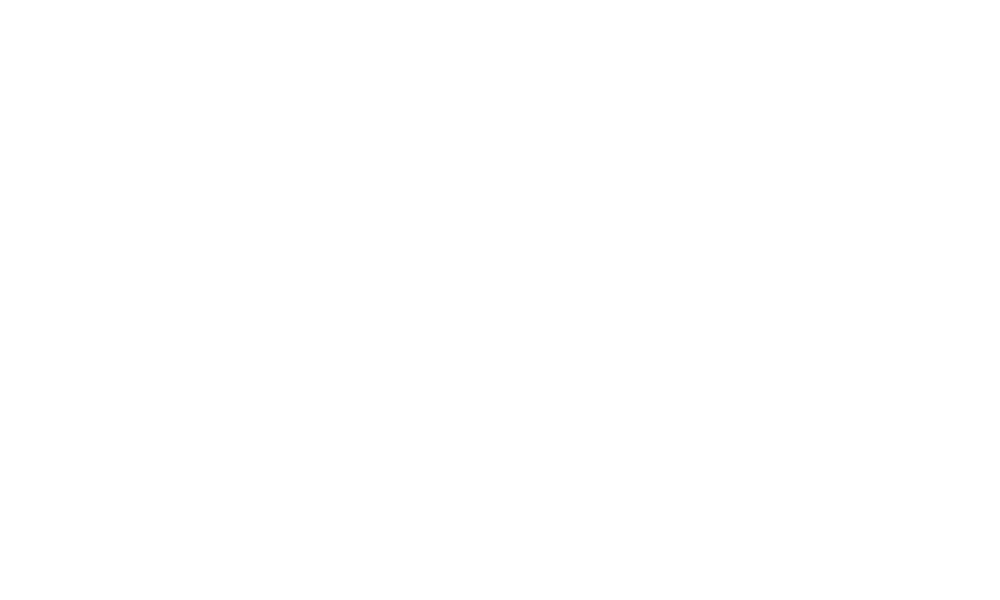

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.013024   -0.686109    0.496193     0.013024     0.013024   
5836  0.013027   -0.672085    0.546646     0.013027     0.013027   
5837  0.013031   -0.674695    0.535664     0.013031     0.013031   
5838  0.013035   -0.634331    0.540912     0.013035     0.013035   
5839  0.013039   -0.661907    0.543823     0.013039     0.013039   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.089823             -0.089823             -0.089823 -0.000130   
5836       -0.087327             -0.087327             -0.087327  0.000086   
5837       -0.084857             -0.084857             -0.084857  0.000322   
5838       -0.082444             -0.082444             -0.082444  0.000552   
5839       -0.080064             -0.080064             -0.080064  0.000787   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835    -0.000130    -0.000130 -0.088077 

<IPython.core.display.Javascript object>


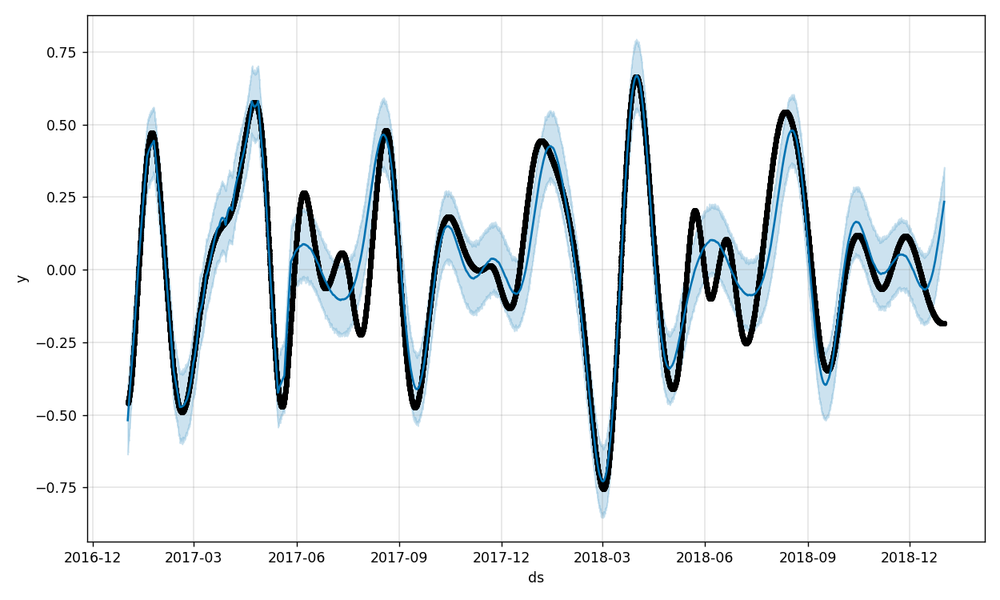

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.025555    0.097835    0.338430     0.025555     0.025555   
5836  0.025560    0.109528    0.339419     0.025560     0.025560   
5837  0.025565    0.115313    0.344787     0.025565     0.025565   
5838  0.025570    0.116326    0.346873     0.025570     0.025570   
5839  0.025576    0.118766    0.353078     0.025576     0.025576   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.194180              0.194180              0.194180  0.000045   
5836        0.197624              0.197624              0.197624 -0.000038   
5837        0.201133              0.201133              0.201133 -0.000127   
5838        0.204700              0.204700              0.204700 -0.000213   
5839        0.208305              0.208305              0.208305 -0.000298   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000045     0.000045  0.195329 

<IPython.core.display.Javascript object>


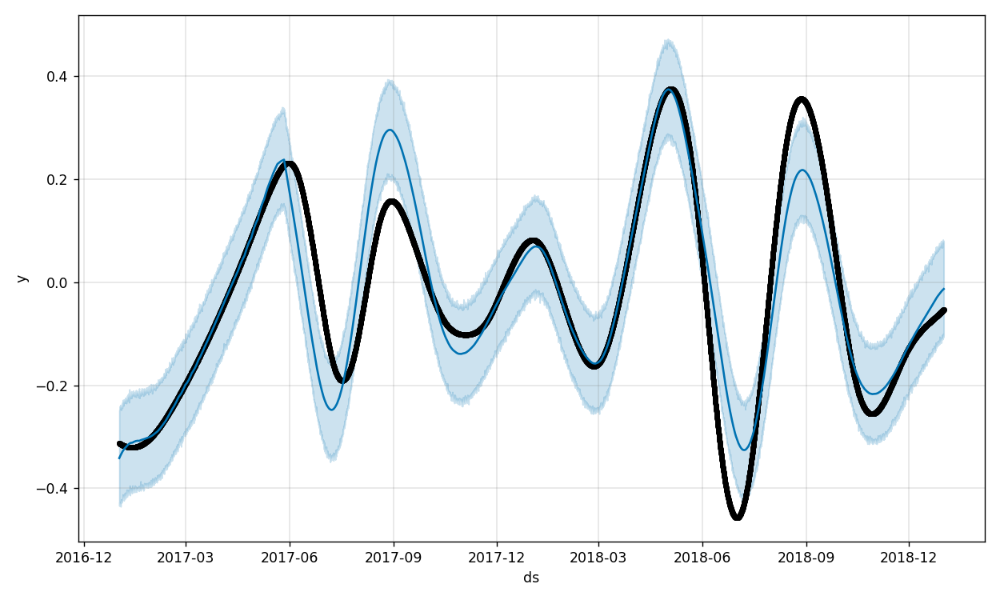

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835 -0.052472   -0.102589    0.081382    -0.052472    -0.052472   
5836 -0.052499   -0.105037    0.075903    -0.052499    -0.052499   
5837 -0.052526   -0.104579    0.077930    -0.052526    -0.052526   
5838 -0.052552   -0.106593    0.077563    -0.052552    -0.052552   
5839 -0.052579   -0.101891    0.079527    -0.052579    -0.052579   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.038328              0.038328              0.038328  0.000003   
5836        0.038619              0.038619              0.038619 -0.000001   
5837        0.038898              0.038898              0.038898 -0.000021   
5838        0.039194              0.039194              0.039194 -0.000025   
5839        0.039475              0.039475              0.039475 -0.000046   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000003     0.000003  0.038395 

<IPython.core.display.Javascript object>


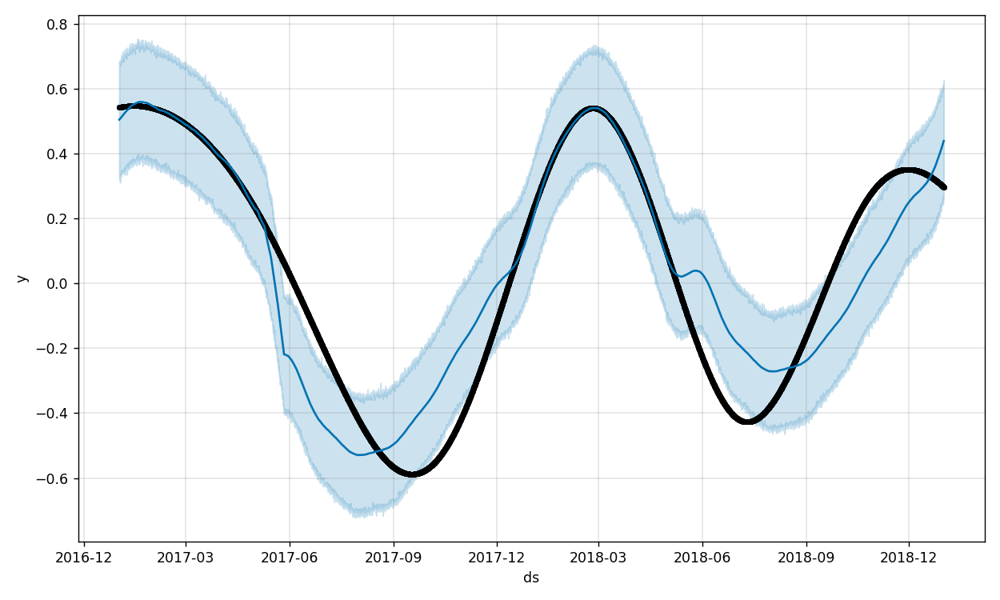

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.235670    0.248421    0.606682     0.235670     0.235670   
5836  0.235759    0.267578    0.607039     0.235759     0.235759   
5837  0.235847    0.258341    0.613254     0.235847     0.235847   
5838  0.235935    0.272093    0.625890     0.235935     0.235935   
5839  0.236023    0.281972    0.619663     0.236023     0.236023   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.197355              0.197355              0.197355  0.000014   
5836        0.198719              0.198719              0.198719 -0.000018   
5837        0.200121              0.200121              0.200121 -0.000045   
5838        0.201546              0.201546              0.201546 -0.000077   
5839        0.202999              0.202999              0.202999 -0.000104   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000014     0.000014  0.197920 

<IPython.core.display.Javascript object>


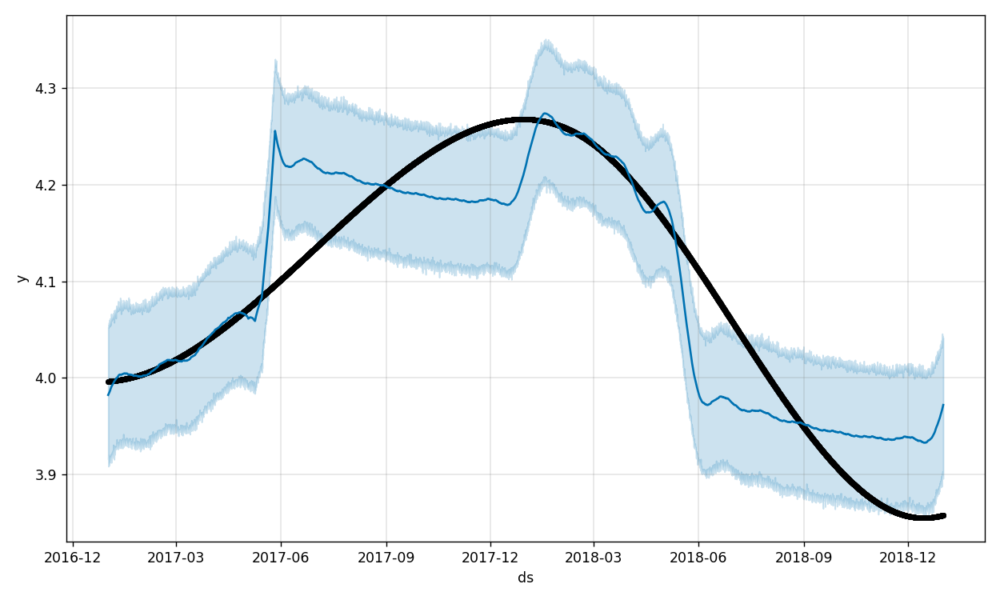

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  3.933115    3.901617    4.042317     3.933115     3.933115   
5836  3.933031    3.898662    4.043202     3.933031     3.933031   
5837  3.932947    3.898731    4.041243     3.932947     3.932947   
5838  3.932862    3.895341    4.041508     3.932862     3.932862   
5839  3.932778    3.901122    4.041267     3.932778     3.932778   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        0.036072              0.036072              0.036072  0.000012   
5836        0.036770              0.036770              0.036770 -0.000007   
5837        0.037482              0.037482              0.037482 -0.000035   
5838        0.038219              0.038219              0.038219 -0.000055   
5839        0.038961              0.038961              0.038961 -0.000084   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.000012     0.000012  0.036375 

<IPython.core.display.Javascript object>


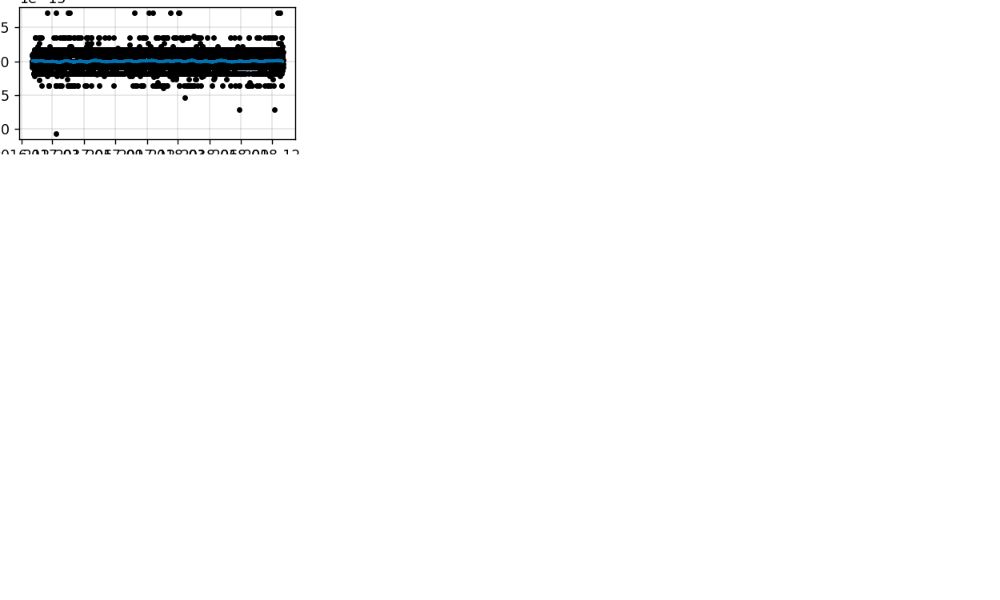

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835  5.092227e-18 -7.568347e-16  7.986982e-16  5.092227e-18  5.092227e-18   
5836  5.091245e-18 -7.060470e-16  7.270807e-16  5.091245e-18  5.091245e-18   
5837  5.090263e-18 -7.132304e-16  6.981074e-16  5.090263e-18  5.090263e-18   
5838  5.089281e-18 -7.086200e-16  7.998800e-16  5.089281e-18  5.089281e-18   
5839  5.088299e-18 -7.658878e-16  6.820740e-16  5.088299e-18  5.088299e-18   

      additive_terms  additive_terms_lower  additive_terms_upper  \
5835    2.499182e-17          2.499182e-17          2.499182e-17   
5836   -7.389487e-18         -7.389487e-18         -7.389487e-18   
5837   -1.342987e-17         -1.342987e-17         -1.342987e-17   
5838   -5.974940e-18         -5.974940e-18         -5.974940e-18   
5839   -3.487399e-17         -3.487399e-17         -3.487399e-17   

             daily   daily_lower   daily_upper        yearly  yearly_lower  \
5835  2.734553e-17  2.734553e-17  2.734553e-

<IPython.core.display.Javascript object>


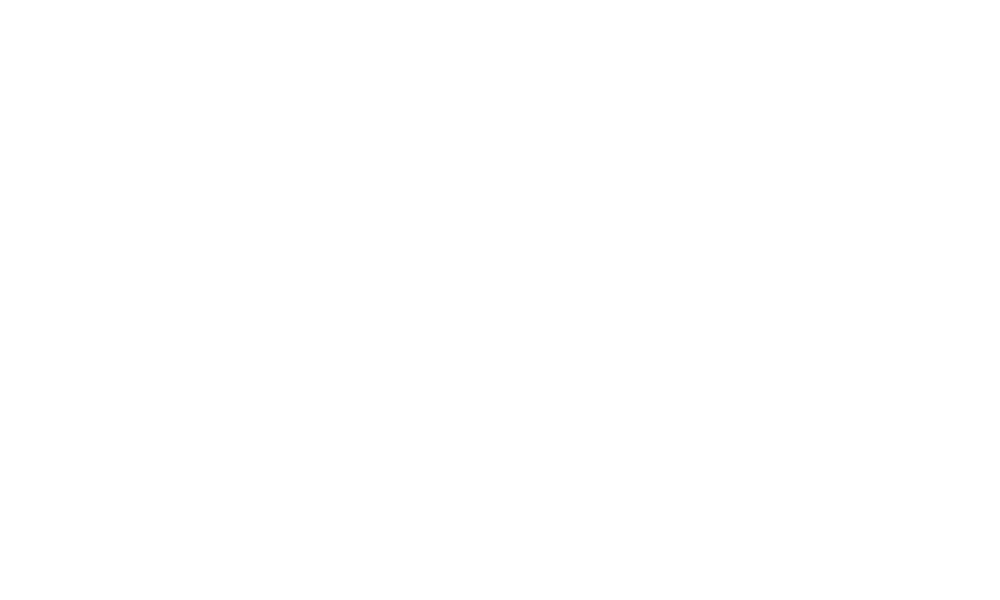

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  264.254901  179.603231  238.133050   264.254901   264.254901   
5836  264.253024  165.015680  225.957714   264.253024   264.253024   
5837  264.251147  158.082801  213.702425   264.251147   264.251147   
5838  264.249270  142.663361  200.757126   264.249270   264.249270   
5839  264.247393  137.384272  195.328909   264.247393   264.247393   

      additive_terms  additive_terms_lower  additive_terms_upper      daily  \
5835      -55.601220            -55.601220            -55.601220  23.042836   
5836      -68.293779            -68.293779            -68.293779  10.493126   
5837      -80.877591            -80.877591            -80.877591  -1.913910   
5838      -92.472001            -92.472001            -92.472001 -13.335390   
5839      -99.276805            -99.276805            -99.276805 -20.006560   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835    23.042836    23.042836 

<IPython.core.display.Javascript object>


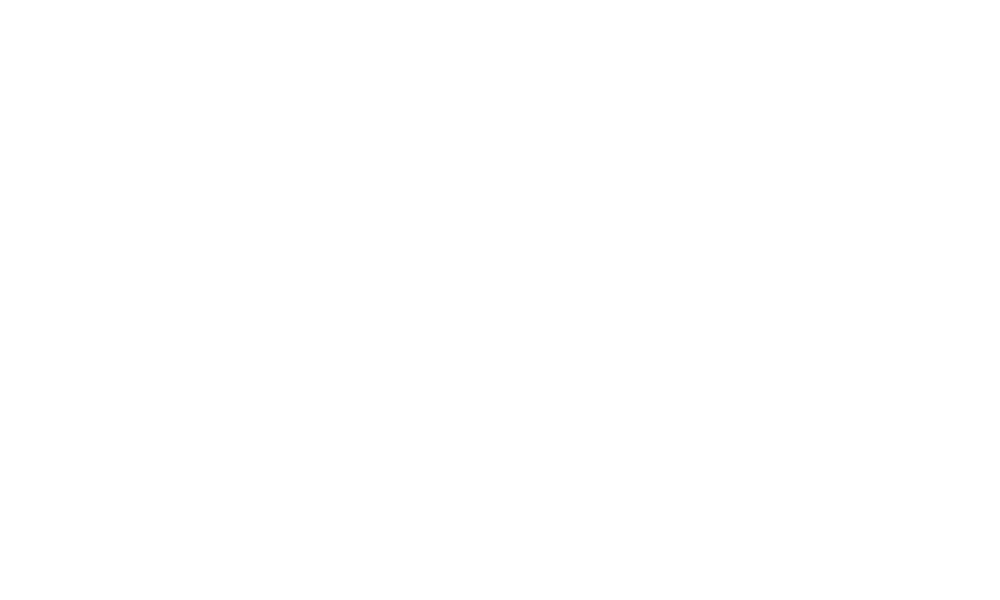

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  0.014016   -0.099382    0.124322     0.014016     0.014016   
5836  0.014019   -0.100814    0.120711     0.014019     0.014019   
5837  0.014021   -0.098605    0.126122     0.014021     0.014021   
5838  0.014023   -0.096621    0.122437     0.014023     0.014023   
5839  0.014025   -0.105350    0.125601     0.014025     0.014025   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835       -0.003689             -0.003689             -0.003689  0.002255   
5836       -0.005402             -0.005402             -0.005402 -0.000970   
5837       -0.004733             -0.004733             -0.004733 -0.001549   
5838       -0.003145             -0.003145             -0.003145 -0.000847   
5839       -0.002560             -0.002560             -0.002560 -0.000723   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     0.002255     0.002255 -0.009174 

<IPython.core.display.Javascript object>


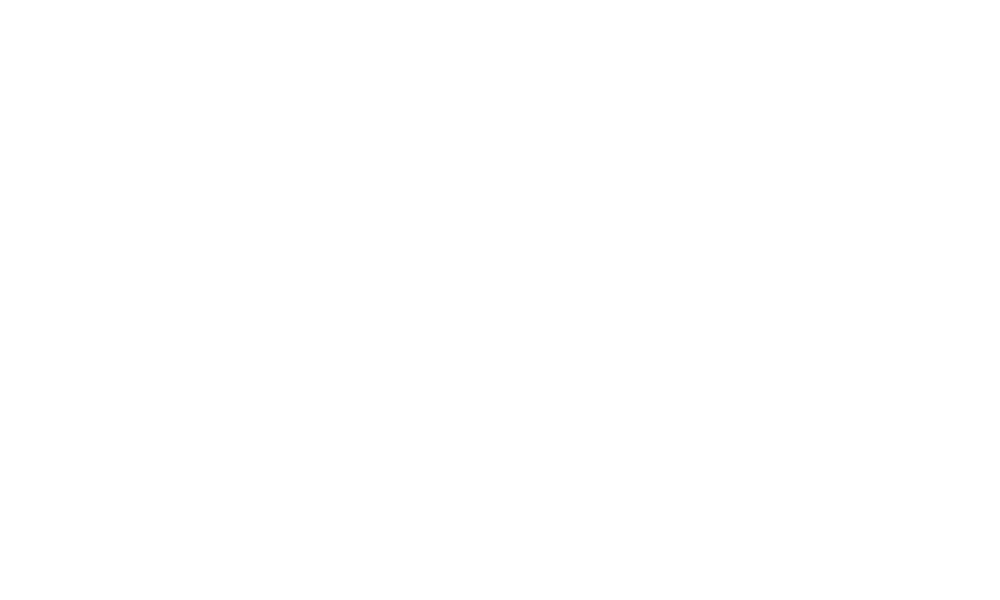

             trend    yhat_lower    yhat_upper   trend_lower   trend_upper  \
5835  85495.353712  85488.054384  86504.650339  85495.353712  85495.353712   
5836  85495.352382  85482.065852  86517.258101  85495.352382  85495.352382   
5837  85495.351052  85539.775813  86521.160525  85495.351052  85495.351052   
5838  85495.349723  85570.497490  86556.416921  85495.349723  85495.349723   
5839  85495.348393  85541.261233  86515.759283  85495.348393  85495.348393   

      additive_terms  additive_terms_lower  additive_terms_upper       daily  \
5835      466.421064            466.421064            466.421064 -105.949694   
5836      489.720369            489.720369            489.720369  -78.984288   
5837      548.194972            548.194972            548.194972  -14.103041   
5838      555.116065            555.116065            555.116065    1.649248   
5839      534.964357            534.964357            534.964357   -7.774693   

      daily_lower  daily_upper      yearly  yearly

<IPython.core.display.Javascript object>


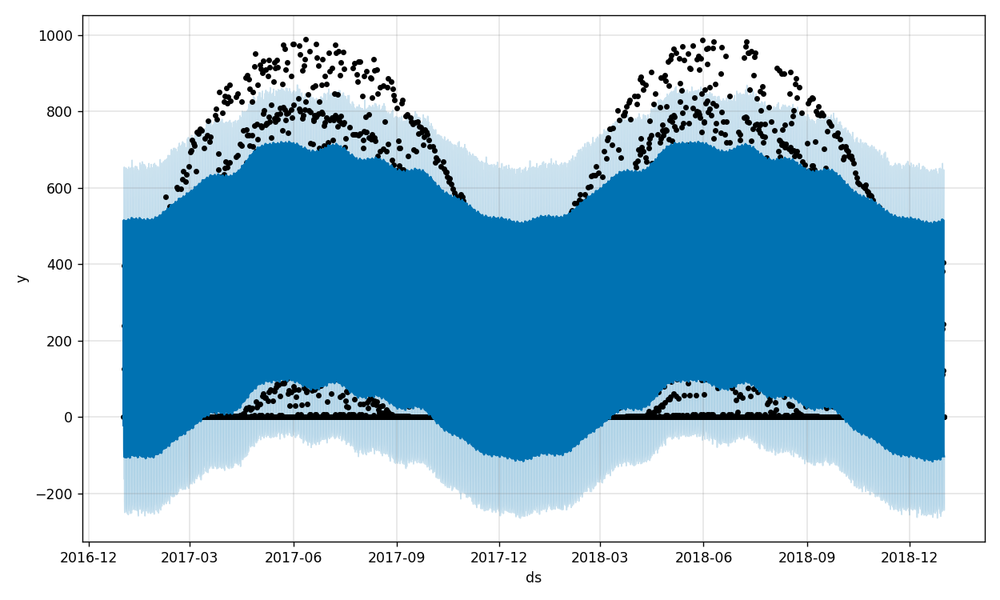

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  193.859665  101.498156  380.693056   193.859665   193.859665   
5836  193.859515 -219.823723   55.643805   193.859515   193.859515   
5837  193.859365 -234.594942   33.858355   193.859365   193.859365   
5838  193.859216 -242.631693   33.769612   193.859216   193.859216   
5839  193.859066 -235.465234   38.036565   193.859066   193.859066   

      additive_terms  additive_terms_lower  additive_terms_upper       daily  \
5835       49.265295             49.265295             49.265295  153.131434   
5836     -276.010292           -276.010292           -276.010292 -172.132179   
5837     -296.608638           -296.608638           -296.608638 -192.752968   
5838     -296.575010           -296.575010           -296.575010 -192.754575   
5839     -296.511715           -296.511715           -296.511715 -192.718858   

      daily_lower  daily_upper      yearly  yearly_lower  yearly_upper  \
5835   153.131434   153.

<IPython.core.display.Javascript object>


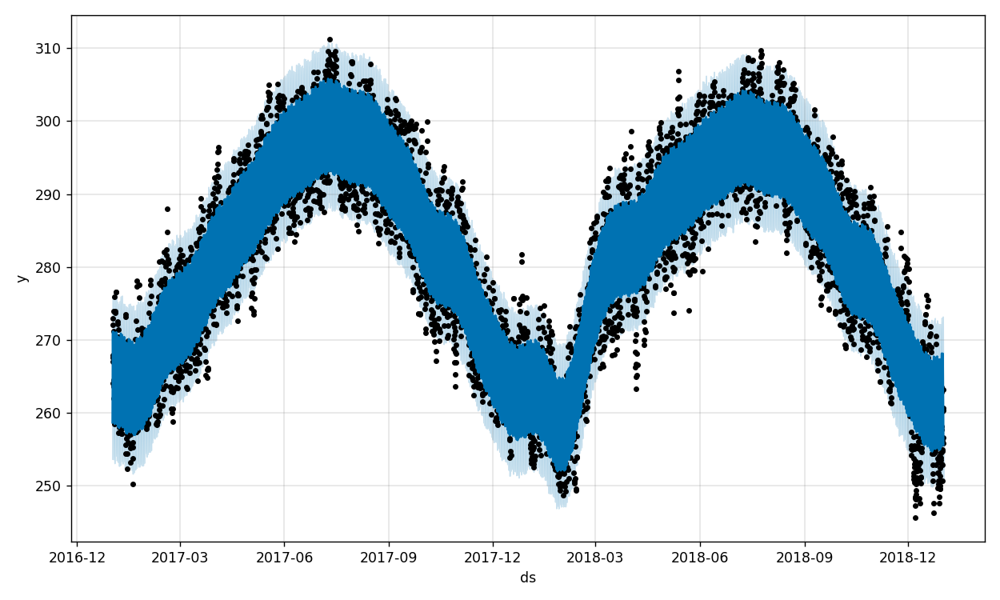

           trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  280.074524  263.161962  273.191253   280.074524   280.074524   
5836  280.073981  259.374158  269.138079   280.073981   280.073981   
5837  280.073438  255.782216  265.483089   280.073438   280.073438   
5838  280.072896  252.374898  262.506846   280.072896   280.072896   
5839  280.072353  250.788621  260.286985   280.072353   280.072353   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835      -11.935812            -11.935812            -11.935812  6.524491   
5836      -15.635233            -15.635233            -15.635233  2.895866   
5837      -19.300483            -19.300483            -19.300483 -0.705333   
5838      -22.476304            -22.476304            -22.476304 -3.830765   
5839      -24.485227            -24.485227            -24.485227 -5.808263   

      daily_lower  daily_upper     yearly  yearly_lower  yearly_upper  \
5835     6.524491     6.524491 -18.70

<IPython.core.display.Javascript object>


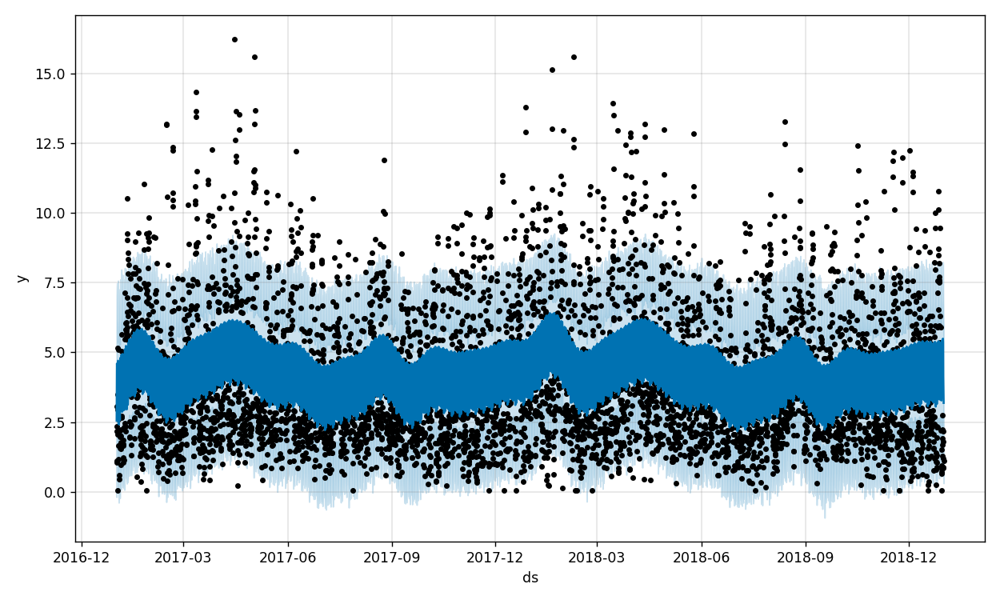

         trend  yhat_lower  yhat_upper  trend_lower  trend_upper  \
5835  4.040572    2.505186    8.114787     4.040572     4.040572   
5836  4.040556    1.435848    7.030544     4.040556     4.040556   
5837  4.040540    1.065223    6.558644     4.040540     4.040540   
5838  4.040524    0.485672    6.117340     4.040524     4.040524   
5839  4.040508    0.312190    5.993942     4.040508     4.040508   

      additive_terms  additive_terms_lower  additive_terms_upper     daily  \
5835        1.322562              1.322562              1.322562  1.085305   
5836        0.094858              0.094858              0.094858 -0.086657   
5837       -0.268239             -0.268239             -0.268239 -0.391258   
5838       -0.629281             -0.629281             -0.629281 -0.695977   
5839       -0.851260             -0.851260             -0.851260 -0.868636   

      daily_lower  daily_upper    yearly  yearly_lower  yearly_upper      yhat  
5835     1.085305     1.085305  0.196956 

In [8]:
X=np.empty((data.shape[0],0))
features = ['trend', 'yhat_lower', 'yhat_upper', 'trend_lower', 'trend_upper', 'additive_terms',
        'additive_terms_lower', 'additive_terms_upper', 'daily', 'daily_lower', 'daily_upper',
        'yearly', 'yearly_lower', 'yearly_upper', 'yhat']
for i in range(0, len(IImfs)):
    temp_df = pd.DataFrame(data['ds'])
    temp_df['y'] = IImfs[i]
    m = Prophet(changepoint_prior_scale=1.0, seasonality_prior_scale=0.1, seasonality_mode='additive', changepoint_range=0.2, yearly_seasonality=True)
    m.fit(temp_df)
    future = m.make_future_dataframe(periods=0, freq='3H')
    forecast = m.predict(future)
    X=np.append(X, forecast[features].to_numpy(), axis=1)
    fig1 = m.plot(forecast)
    fig1.show()
    print(forecast[features].tail())

In [9]:
X.shape

(5840, 1125)

In [10]:
#split the data into training and testing sets
split_line=4672
X_train = np.array(X[:split_line])
X_test = np.array(X[split_line:])
y_train = np.array(y[:split_line])
y_test = np.array(y[split_line:])

In [11]:
scaler = MinMaxScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [12]:
X_train = np.reshape(X_train, (X_train.shape[0], 1, X_train.shape[1]))
X_test = np.reshape(X_test, (X_test.shape[0], 1, X_test.shape[1]))

In [13]:
#define the model structure
model = keras.models.Sequential()
model.add(keras.layers.GRU(1024, input_shape = (1, X_train.shape[1:][1]),
                           activation = 'relu', recurrent_activation = 'relu',
                           return_sequences = True))
model.add(keras.layers.GRU(1024, activation = 'sigmoid', recurrent_activation = 'sigmoid', return_sequences = True))
model.add(keras.layers.GRU(1024, activation = 'tanh', recurrent_activation = 'tanh', return_sequences = True))
model.add(keras.layers.Dense(1))

In [14]:
#define the hyperparameters for fitting the data to the model keras.optimizers.Adam(0.001)
model.compile(loss = 'mean_squared_error', optimizer = keras.optimizers.Nadam(0.001))

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 gru (GRU)                   (None, 1, 1024)           6607872   
                                                                 
 gru_1 (GRU)                 (None, 1, 1024)           6297600   
                                                                 
 gru_2 (GRU)                 (None, 1, 1024)           6297600   
                                                                 
 dense (Dense)               (None, 1, 1)              1025      
                                                                 
Total params: 19,204,097
Trainable params: 19,204,097
Non-trainable params: 0
_________________________________________________________________


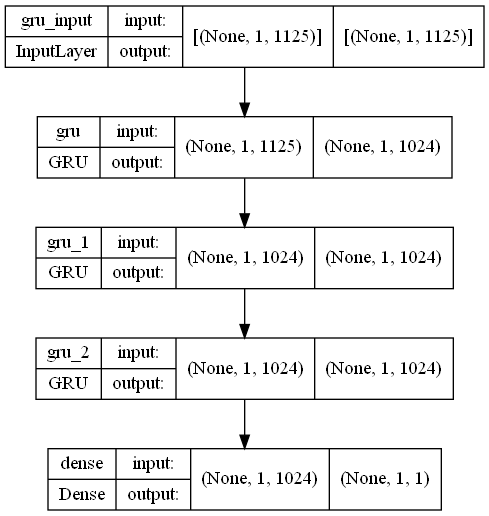

In [15]:
model.summary()
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [16]:
#callback function to stop running epochs when the error does not improve by a specified amount
es_callback = keras.callbacks.EarlyStopping(patience = 400, restore_best_weights = True)

In [17]:
#fit the model
history = model.fit(X_train, y_train, validation_split = 0.1, epochs = 10000, verbose = 1, shuffle = True,
                    callbacks = [es_callback])
#history = model.fit(X_train, y_train, epochs = 200, verbose = 1, shuffle = True)

Epoch 1/10000
132/132 [==============================] - 59s 424ms/step - loss: 6.5987 - val_loss: 5.4770
Epoch 2/10000
132/132 [==============================] - 54s 412ms/step - loss: 5.1925 - val_loss: 4.0015
Epoch 3/10000
132/132 [==============================] - 55s 414ms/step - loss: 5.1097 - val_loss: 7.2507
Epoch 4/10000
132/132 [==============================] - 54s 413ms/step - loss: 5.0498 - val_loss: 4.3234
Epoch 5/10000
132/132 [==============================] - 55s 414ms/step - loss: 5.0442 - val_loss: 4.0869
Epoch 6/10000
132/132 [==============================] - 54s 411ms/step - loss: 5.0277 - val_loss: 4.0203
Epoch 7/10000
132/132 [==============================] - 54s 411ms/step - loss: 4.9818 - val_loss: 4.3629
Epoch 8/10000
132/132 [==============================] - 54s 412ms/step - loss: 4.9328 - val_loss: 4.1849
Epoch 9/10000
132/132 [==============================] - 54s 406ms/step - loss: 4.9283 - val_loss: 4.0498
Epoch 10/10000
132/132 [======================

132/132 [==============================] - 54s 407ms/step - loss: 0.7936 - val_loss: 5.7620
Epoch 154/10000
132/132 [==============================] - 61s 464ms/step - loss: 0.7035 - val_loss: 6.0382
Epoch 155/10000
132/132 [==============================] - 58s 443ms/step - loss: 0.7114 - val_loss: 6.0306
Epoch 156/10000
132/132 [==============================] - 57s 435ms/step - loss: 0.7216 - val_loss: 5.7996
Epoch 157/10000
132/132 [==============================] - 54s 411ms/step - loss: 0.6598 - val_loss: 5.7969
Epoch 158/10000
132/132 [==============================] - 54s 408ms/step - loss: 0.6389 - val_loss: 6.0176
Epoch 159/10000
132/132 [==============================] - 54s 410ms/step - loss: 0.6116 - val_loss: 6.3407
Epoch 160/10000
132/132 [==============================] - 54s 408ms/step - loss: 0.6352 - val_loss: 6.0319
Epoch 161/10000
132/132 [==============================] - 54s 410ms/step - loss: 0.6160 - val_loss: 6.0660
Epoch 162/10000
132/132 [===================

KeyboardInterrupt: 

In [18]:
#make predictions
predictions = model.predict(X_test)
predictions = predictions.flatten()
print_metrics(predictions[:-1], y_test)

mae:  2.1414462358399695
mse:  7.715386533900916
rmse:  2.7776584624285463
score:  -0.5367148814830669
accuracy:  0.2159383033419023


In [19]:
#print training error for checking over-fitting
mse_train = metrics.mean_squared_error((model.predict(X_train)).flatten(), y_train)
print('train mse: ', mse_train)

train mse:  0.9353117820099638


<IPython.core.display.Javascript object>


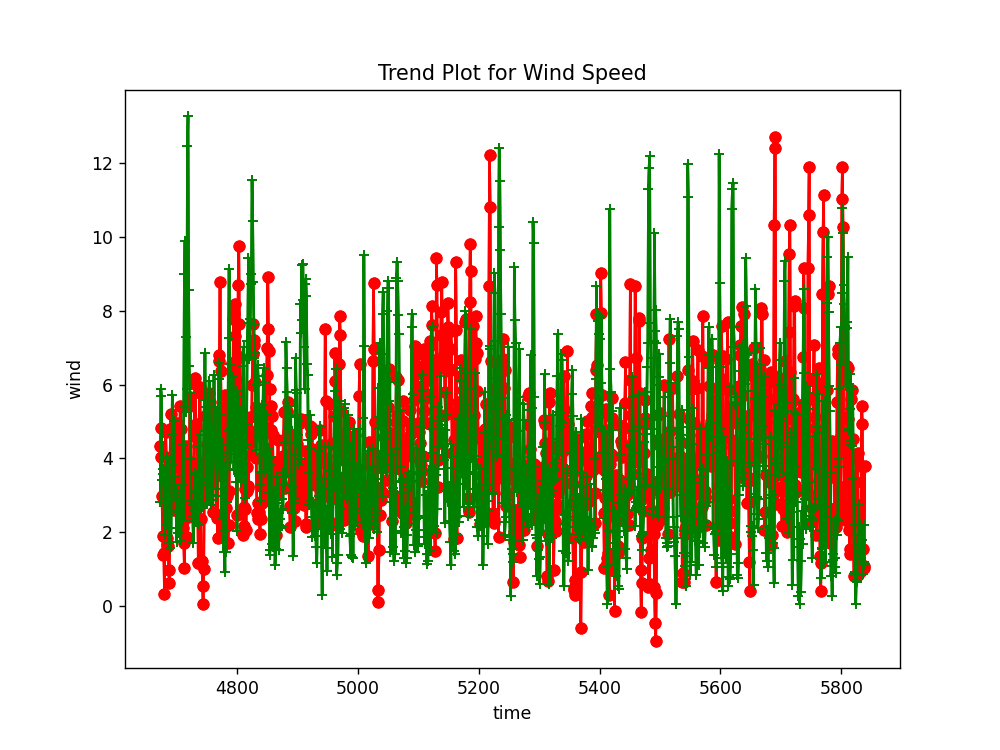

In [20]:
import matplotlib.pyplot as plt
%matplotlib notebook
x1=x2=data[["ds"]][1:][split_line:].index
y1=predictions[:-1]
y2=y_test
plt.plot(x1,y1,'ro-',x2,y2,'g+-')
plt.title('Trend Plot for Wind Speed')
l1=plt.plot(x1,y1,'ro-',label='predict')
l2=plt.plot(x2,y2,'g+-',label='real')
plt.xlabel('time')
plt.ylabel('wind')
plt.show()